In [1]:
from sklearn.cluster import KMeans
import numpy as np
import h5py
import csv
import math
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from matplotlib import style
from scipy.ndimage import gaussian_filter
from scipy.ndimage import gaussian_filter1d
from scipy.signal import savgol_filter
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import cross_val_score
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean
#from dtaidistance import dtw
#from dtaidistance.dtw import constrained
from pytwed import twed

from sklearn import datasets
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
#import umap
#import umap.umap_ as umap
import pandas as pd
import seaborn as sns
import copy
from scipy.stats import ranksums

from scipy.stats import ks_2samp
import warnings
from scipy.signal import find_peaks
import scipy
# Suppress all warnings
#warnings.filterwarnings("ignore")

In [154]:
def averaging_crosscorr_diff_stretches(x,y,stretches,threshold=20):
    count = 0
    collected_matrices = []
    collected_weights = []
    for (start, end) in stretches:
        leng = end-start
        delta = leng-threshold
        print("stretches length:" +str(leng))
        if leng > threshold:
            print('accepted')
            count=count+1
            x_valid = x[start:end]
            y_valid = y[start:end]
            cross_correlation = norm_cross_corr(x_valid, y_valid, mode='full')
            st_ind = delta
            end_ind = delta+2*threshold
            collected_matrices.append(cross_correlation[st_ind:end_ind])
            collected_weights.append(leng)         
    # Convert the list of matrices to a numpy array
    total_matrix = np.vstack(collected_matrices)
    total_weight = np.vstack(collected_weights)
    if True:#total_matrix.shape[0] == count*threshold*2:
        final_matrix = total_matrix.reshape(count, threshold*2)
        print("Final matrix shape:", final_matrix.shape)
    else:
        print("Error: The total number of rows is not correct")
    return final_matrix,total_weight   



def bin_and_plot(X,Y,bins=10,label='',plot=False):
    #bins X and plots average of Y in each bin
    # Creating a DataFrame
    data = {
    'time': X,
    'activity': Y,
        }

    df = pd.DataFrame(data)
    df['vel_Bin'] = pd.cut(df['time'], bins=bins)

    # Calculate the mean of 'activity' in each bin
    mean_activity_by_bin = df.groupby('vel_Bin')['activity'].mean()
    mean_time_by_bin = df.groupby('vel_Bin')['time'].mean()

    # Extract bin edges and calculate bin width
    bin_edges = pd.cut(df['time'], bins=bins).unique()
    bin_width = bin_edges[0].right - bin_edges[0].left
    if plot:
        # Make the plot larger
        plt.figure(figsize=(12, 8))
        # Plotting the mean activity in each bin
        plt.bar(mean_time_by_bin, mean_activity_by_bin, width = bin_width, align='center')
        plt.title(label)
        plt.xlabel('time Bins')
        plt.ylabel('Mean Activity')
        plt.xticks(rotation=45, ha='right')
        plt.show()
    return df,mean_time_by_bin, mean_activity_by_bin,bin_width

def compute_vector_maxmin(vector,exclude_zero=True):    
    if not exclude_zero:
        mini = np.min(vector)
        maxi = np.max(vector)
        vector_zscore= (vector-mini)/(maxi-mini)
    else:
        vector_zscore = np.zeros(np.shape(vector))
        mini = np.min(vector[np.nonzero(vector)[0]])
        maxi = np.max(vector[np.nonzero(vector)[0]])
        vector_zscore[(np.nonzero(vector)[0])] = (vector[np.nonzero(vector)[0]]-mini)/(maxi-mini)
    return vector_zscore 

    
def compute_vector_maxmin_neg(vector,exclude_zero=True):    
    if not exclude_zero:
        mini = np.min(vector)
        maxi = np.max(vector)
        vector_zscore= 2*(vector-mini)/(maxi-mini) - 1
    else:
        vector_zscore = np.zeros(np.shape(vector))
        mini = np.min(vector[np.nonzero(vector)[0]])
        maxi = np.max(vector[np.nonzero(vector)[0]])
        vector_zscore[(np.nonzero(vector)[0])] = 2*(vector[np.nonzero(vector)[0]]-mini)/(maxi-mini) -1
    return vector_zscore 

def compute_everymin_z_score(vector0,exclude_zero=True,minlength=60):
    sets = int(len(vector0)/minlength)
    vector_zscore = copy.deepcopy(vector0)
    for n in range(sets):
        n0 = n*minlength
        if n<sets-1:
            n1= (n+1)*minlength
        else:
            n1=-1
        vector = vector0[n0:n1]    
        if not exclude_zero:
            mean = np.mean(vector)
            std=np.std(vector)
            vector_zscore= (vector-mean)/std
        else:
            #vector_zscore = np.zeros(np.shape(vector))
            mean = np.mean(vector[np.nonzero(vector)[0]])
            std=np.std(vector[np.nonzero(vector)[0]])
            vector_zscore[n0+(np.nonzero(vector)[0])] = (vector[np.nonzero(vector)[0]]-mean)/std
    return vector_zscore 

def compute_everymin_maxmin(vector0,exclude_zero=True,minlength=60):
    #takes a sliding window and computes max and min in each window
    sets = int(len(vector0)/minlength)
    vector_zscore = copy.deepcopy(vector0)
    for n in range(sets):
        n0 = n*minlength
        if n<sets-1:
            n1= (n+1)*minlength
        else:
            n1=-1
        vector = vector0[n0:n1]    
        if not exclude_zero:
            maxi = np.max(vector)
            mini = np.min(vector)
            vector_zscore= (vector-mini)/maxi
        else:
            mini = np.min(vector[np.nonzero(vector)[0]])
            maxi = np.max(vector[np.nonzero(vector)[0]])
            vector_zscore[n0+(np.nonzero(vector)[0])] = (vector[np.nonzero(vector)[0]]-mini)/(maxi-mini)
    return vector_zscore 
        
def closest_index(A, b):
    #returns the index of vector A that has the closest value to b
    # Calculate the absolute differences between b and each element in A
    diff = np.abs(A - b)

    # Find the index of the element in A with the smallest difference
    idx = np.argmin(diff)

    # Return the index
    return idx

def compute_2rows(row1, row2):
    row1[np.isnan(row1)] = 0
    row2[np.isnan(row2)] = 0
    time_intersection = (np.abs(row1)>0)&(np.abs(row2)>0)
    correlation = np.corrcoef(row1[time_intersection], (row2[time_intersection]))[0, 1]
    correlation2 = scipy.stats.pearsonr(compute_vector_z_score(row1[time_intersection]), (row2[time_intersection]))[0]
    return correlation,correlation2


def compute_vector_z_score(vector,exclude_zero=True):
    
    if not exclude_zero:
        mean = np.mean(vector)
        std=np.std(vector)
        vector_zscore= (vector-mean)/std
    else:
        vector_zscore = np.zeros(np.shape(vector))
        mean = np.mean(vector[np.nonzero(vector)[0]])
        std=np.std(vector[np.nonzero(vector)[0]])
        vector_zscore[np.nonzero(vector)[0]] = (vector[np.nonzero(vector)[0]]-mean)/std
    return vector_zscore 


def compute_r_squared(y, yhat):
    # Mean of actual values
    y_mean = np.mean(y)    
    # Total sum of squares (proportional to the variance of the data)
    ss_total = np.sum((y - y_mean) ** 2)    
    # Residual sum of squares
    ss_residual = np.sum((y - yhat) ** 2)    
    # R-squared
    r_squared = 1 - (ss_residual / ss_total)    
    return r_squared

def convert_time_tofr(time_interval,MegaMat):
    t1 = closest_index(MegaMat[:,12], 200)
    t2 = closest_index(MegaMat[:,12], 200+time_interval)
    return int(t2-t1)

def cross_dtw(X0,Y0,time,lambda_param = 1.0,nu = 0.01,fast=True):
    # Parameters for TWED
    #lambda_param: Regularization parameter (stiffness)
    #nu: Penalty for time differences
    
    lags = np.arange(-len(X0) + 1, len(X0))
    distances = np.zeros(len(lags))
    for i, lag in enumerate(lags):
        Y0_shifted = np.roll(Y0, lag)  # Shift Y by the current lag
        nonzero_indices = np.nonzero((X0 != 0) & (Y0_shifted != 0))         
        # Compute TWED distance using pytwed
        if fast:
            distances[i], path = fastdtw(X0[nonzero_indices[0]], Y0_shifted[nonzero_indices[0]], dist=euclidean)
        else:    
            distances[i] = twed(X0[nonzero_indices[0]], Y0_shifted[nonzero_indices[0]], time[nonzero_indices[0]],
                           time[nonzero_indices[0]], lmbda=lambda_param, nu=nu, fast=True)
    return distances

def droptop5perc(velocityVec,thresh=0.05):
    #drops the highest 5 percent
    Sort = np.argsort(velocityVec)
    velocityVec_s = np.copy(velocityVec[Sort])
    velocityVec_s = velocityVec_s[velocityVec_s>0]
    upperBound = np.min(velocityVec_s[-int(len(velocityVec_s)*thresh):])#mean of the lowwest dropTresh percent of the activity
    above_thresh = (velocityVec > upperBound)
    velocityVec[above_thresh]=0
    velocityVec[above_thresh]=0
    return velocityVec
def dropbottom5perc(velocityVec,thresh=0.05):
    Sort = np.argsort(velocityVec)
    velocityVec_s = np.copy(velocityVec[Sort])
    velocityVec_s = velocityVec_s[(velocityVec_s>0) + (velocityVec_s<0)]
    lowerBound = np.max(velocityVec_s[:int(len(velocityVec_s)*thresh)])#mean of the lowwest dropTresh percent of the activity
    below_thresh = (velocityVec < lowerBound)
    #print("lowerBound"+str(lowerBound))
    velocityVec[below_thresh]=0
    velocityVec[below_thresh]=0
    return velocityVec

def estimate_y(X,theta,y):
    #estimates y from the linear regressions coefficients
    yhat = X @ theta
    error = (np.linalg.norm(y-yhat))**2
    return yhat,error


def find_stretches(valid_indices):
    stretches = []
    start = None
    for i, valid in enumerate(valid_indices):
        if valid and start is None:
            start = i
        elif not valid and start is not None:
            stretches.append((start, i))
            start = None
    if start is not None:
        stretches.append((start, len(valid_indices)))
    return stretches

def get_attribute_name_by_value(h5file, target_value):
    """
    Returns the name of the attribute that has the specified integer value.
    Parameters:
    h5file (h5py.File): The HDF5 file object.
    target_value (int): The integer value to search for.
    Returns:
    str: The name of the attribute with the matching value.
    None: If no matching attribute is found.
    """
    attributes = h5file['data/dataraw'].attrs
    
    for attr_name in attributes.keys():
        if attributes[attr_name] == target_value:
            return attr_name    
    return 'Behavior:'+str(target_value)

def get_neurite_nanmean(rowsArr_float):
    neuriteActivity = rowsArr_float[:,[7,8,27,28,39,40]]
    neuriteActivity[neuriteActivity==0] = np.nan
    n_acti = np.nanmean(neuriteActivity,axis=1)
    n_acti[np.isnan(n_acti)]=0
    return n_acti

def get_nonzero_start_end_long(turn_timepoints,thresh=5):
    start_indices = []
    end_indices = []
    if not turn_timepoints[0]==0:
        start_indices.append(0)
    for i in range(len(turn_timepoints) - 1):
        if turn_timepoints[i] == 0 and not(turn_timepoints[i+1] == 0):
            start_indices.append(i+1)
        if not(turn_timepoints[i] == 0) and (turn_timepoints[i+1] == 0): 
            end_indices.append(i)
    if not turn_timepoints[-1]==0:
        end_indices.append(len(turn_timepoints)-1) 
    assert len(end_indices)==len(start_indices)
    delInde = []
    delInds = []
    if len(start_indices)>0:
        for i in range(len(start_indices)-1):
            if (start_indices[i+1]-end_indices[i]) < thresh:
                delInde.append(i)
                delInds.append(i+1)
        start_indices = np.delete(start_indices, delInds)
        end_indices = np.delete(end_indices, delInde)
    return start_indices,end_indices

def get_nonzero_start_end(turn_timepoints):
    start_indices = []
    end_indices = []
    if not turn_timepoints[0]==0:
        start_indices.append(0)
    for i in range(len(turn_timepoints) - 1):
        if turn_timepoints[i] == 0 and not(turn_timepoints[i+1] == 0):
            start_indices.append(i+1)
        if not(turn_timepoints[i] == 0) and (turn_timepoints[i+1] == 0): 
            end_indices.append(i)
    if not turn_timepoints[-1]==0:
        end_indices.append(len(turn_timepoints)-1) 
    assert len(end_indices)==len(start_indices)        
    return start_indices,end_indices

def get_omega_start_end(turn_timepoints):
    start_indices = []
    end_indices = []
    for i in range(len(turn_timepoints) - 1):
        if turn_timepoints[i][1] == 'Omegi' and turn_timepoints[i+1][1] == 'Omegf':
            start_indices.append(turn_timepoints[i][0])
            end_indices.append(turn_timepoints[i+1][0])
        if turn_timepoints[i][1] == 'SOmegi' and turn_timepoints[i+1][1] == 'SOmegf':
            start_indices.append(turn_timepoints[i][0])
            end_indices.append(turn_timepoints[i+1][0])     
    assert len(end_indices)==len(start_indices)        
    return start_indices,end_indices
    

def interpolate_nanValues(x,y):
    x_interp = np.interp(np.arange(len(x)), np.arange(len(x))[~np.isnan(x)], x[~np.isnan(x)])
    y_interp = np.interp(np.arange(len(y)), np.arange(len(y))[~np.isnan(y)], y[~np.isnan(y)])
    return x_interp, y_interp


def norm_cross_corr(signal1,signal2,mode='full'):
    signal1n = (signal1-np.mean(signal1))/np.std(signal1)
    signal2n = (signal2-np.mean(signal2))/np.std(signal2)
    norm_cross_corr = np.correlate(signal1n, signal2n, mode='full')/len(signal1n)
    return norm_cross_corr

def ordinary_least_squares(X, y): 
    #y=X*\theta+\epsilon
    #performs linear regression and returns the coefficients
    temp1 = (X.T) @ y
    temps2 = (X.T) @ X
    temp3 = np.linalg.inv(temps2)
    theta_hat =  temp3 @ temp1
    return theta_hat

def plot_crosscorr_for_diff_stretches(x,y,stretches,threshold=20,odor_bins=0):
    print(len(stretches))
    for (start, end) in stretches:
        print("stretches length:"+str(end-start))
        if (end-start)>threshold:
            print(start)
            x_valid = x[start:end]
            y_valid = y[start:end]
            cross_correlation = norm_cross_corr(x_valid, y_valid, mode='full')
            lags = np.arange(-len(x_valid) + 1, len(x_valid))            
            # Plotting the cross-correlation
            plt.figure(figsize=(10, 6))
            plt.plot(lags, cross_correlation)
            plt.xlabel('Lag')
            if np.sum(odor_bins):
                plt.ylabel(np.average(odor_bins[start:end]))
            else:
                plt.ylabel("cross correlation")
            plt.title(f'Cross-corr,segment(Stretch {start} to {end-1})')
            plt.grid()
            plt.show()
            

def plot1d_withAnnotations_scatter(timevec,Valvec,All_ind,h=200,plotFB=False,yloc=0,draw_lines=False,
                                   multi=False,multivec=[0],multivec_pos=[1,1,1,1,1,1,1],timevec_orig=[0]):
    #All_ind:list of labels
    style.use('fivethirtyeight')
    fig = plt.figure(figsize=(10,3))
    ax = fig.add_subplot(111)
    ax.scatter(timevec,Valvec)
    color=['r','g','cyan','brown']
    if multi:
        multishape = np.shape(multivec)
        if len(multishape)>1:
            multilen = multishape[0]           
            for m in range(multilen):
                if multishape[1]==len(timevec):
                    ax.scatter(timevec,multivec[m,:]+multivec_pos[m],color=color[m])
                else:
                    ax.scatter(np.arange(multishape[1]),multivec[m,:]+multivec_pos[m],color=color[m])
        else:
            if multishape[0]==len(timevec):
                ax.scatter(timevec,multivec+multivec_pos[0],color=color[0])
            else:
                ax.scatter(timevec_orig,multivec+multivec_pos[0],color=color[0])
    velo = Valvec
    for i in range(np.shape(All_ind)[0]):
        if All_ind[i][1]=='B':
            ax.text(All_ind[i][0],yloc+0.5,All_ind[i][1],rotation='vertical',fontsize=10,color='red')#'xx-small')
            if draw_lines:    
                ax.axvline(x=All_ind[i][0],c ='red',alpha=0.4,lw=1)#,yloc,All_ind[i][1],rotation='vertical',fontsize=10)#'xx-small')
        elif All_ind[i][1]=='F':
            ax.text(All_ind[i][0],yloc-0.5,All_ind[i][1],rotation='vertical',fontsize=10,color='green')#'xx-small')
            if draw_lines:    
                ax.axvline(x=All_ind[i][0],c ='g',alpha=0.4,lw=1)
        else:
            ax.text(All_ind[i][0],yloc,All_ind[i][1],rotation='vertical',fontsize=10)#'xx-small')
    plt.show()  

def plotBar_withAnnotations(timevec,Valvec,widthVec,All_ind,h=0.5,plotFB=False,yloc=0,draw_lines=False,
                                   timevec_orig=[0],allindex=0):
    #All_ind:list of labels
    style.use('fivethirtyeight')
    fig = plt.figure(figsize=(10,3))
    ax = fig.add_subplot(111)
    ax.bar(timevec,Valvec, width=widthVec, align='center')
    color=['r','g','cyan','brown']
    velo = Valvec
    for i in range(np.shape(All_ind)[0]):
        if All_ind[i][1]=='B':
            ax.text(All_ind[i][0],yloc-h,All_ind[i][1],rotation='horizontal',fontsize=10,color='red')#'xx-small')
            if draw_lines and i<np.shape(All_ind)[0]-1: 
                if All_ind[i+1][1]=='B':
                    ax.axvspan(All_ind[i][0],All_ind[i+1][0],color ='red',alpha=0.4,lw=1)#,yloc,All_ind[i][1],rotation='vertical',fontsize=10)#'xx-small')
        elif All_ind[i][1]=='F':
            ax.text(All_ind[i][0],yloc+h,All_ind[i][1],rotation='horizontal',fontsize=10,color='green')#'xx-small')
            if draw_lines and i<np.shape(All_ind)[0]-1:    
                if All_ind[i+1][1]=='F':
                    ax.axvspan(All_ind[i][0],All_ind[i+1][0],color ='g',alpha=0.4,lw=1)#
        elif allindex>0:
            ax.text(All_ind[i][0],yloc,All_ind[i][1],rotation='vertical',fontsize=10)#'xx-small')
    plt.show()  

def plot1d_withAnnotations(timevec,Valvec,All_ind,h=0.5,plotFB=False,yloc=0,draw_lines=False):
    #draw lines: whether to draw red or green lines on forward or backward states
    #yloc:location of B and F labels
    #plotFB: whether to   plot forward and backward labels
    #All_ind:list of labels
    style.use('fivethirtyeight')
    fig = plt.figure(figsize=(10,3))
    ax = fig.add_subplot(111)
    ax.plot(timevec,Valvec)
    velo = Valvec
    if plotFB:
        forward_times = np.nonzero(velo>1)
        forward = np.ones(len(forward_times[0]))*h
        backward_times = np.nonzero(velo<-1)
        backward = np.ones(len(backward_times[0]))*(-h)
        length = len(velo)
        ax.set_xlabel('t')
        ax.set_ylabel('v')
        # Create a list of colors for each segment of the line
        colors = ['black' if velo[i] < 0 else 'red' for i in range(length)]
        #ax.hlines(20, 0, length, colors=colors, linewidth=5)
        ax.scatter(forward_times[0],forward,c='red',s=2)
        ax.scatter(backward_times[0],backward,c= 'green',s=2)

    for i in range(np.shape(All_ind)[0]):
        if All_ind[i][1]=='B':
            ax.text(All_ind[i][0],yloc+h,All_ind[i][1],rotation='vertical',fontsize=10,color='red')#'xx-small')
            if draw_lines and i<np.shape(All_ind)[0]-1:    
                ax.axvline(x=All_ind[i][0],c ='r',alpha=0.4,lw=1)
        elif All_ind[i][1]=='F':
            ax.text(All_ind[i][0],yloc+h,All_ind[i][1],rotation='vertical',fontsize=10,color='green')#'xx-small')
            if draw_lines and i<np.shape(All_ind)[0]-1:    
                ax.axvline(x=All_ind[i][0],c ='g',alpha=0.4,lw=1)
        else:
            ax.text(All_ind[i][0],yloc,All_ind[i][1],rotation='vertical',fontsize=10)#'xx-small')

    plt.show()

def plot_2Bars(y_train2,y_pred,time,Rsq,ylab):
    plt.figure(figsize=(10, 3))
    plt.scatter(time,y_train2, label='Actual', marker='o')
    plt.scatter(time,y_pred, label='Predicted', marker='x')
    plt.ylabel(ylab)
    plt.title(Rsq)
    plt.legend()
    plt.show()


def plot1d_withOdor(timevec,Valvec,Odorvec,title):
    style.use('fivethirtyeight')
    fig = plt.figure(figsize=(10,3))
    ax = fig.add_subplot(111)
    ax.scatter(timevec,Valvec)
    velo = Valvec
    for t in np.nonzero(Odorvec==1)[0]:
        ax.axvline(x=timevec[t],c ='g',alpha=0.05,lw=1)#axvspan
    for t in np.nonzero(Odorvec==2)[0]:
        ax.axvline(x=timevec[t],c ='r',alpha=0.05,lw=1)#axvspan   
    ax.set_title(title)    
    plt.show()  

def plot_dtw(X, Y, ax,labelx='X',labely='Y'):
    # Calculate DTW and distance
    distance, path = fastdtw(X, Y, dist=euclidean)
    
    # Plot the warping path between X and Y
    ax.plot(X, label=labelx)
    ax.plot(Y, label=labely)
    for (xi, yi) in path:
        ax.plot([xi, yi], [X[xi], Y[yi]], 'r')
    ax.legend()
    return distance

def Regress_with_coeff(X_line,all_means):
    coefficients = all_means[:4]
    intercept = all_means[4]
    y_line = np.dot(coefficients, X_line) + intercept
    return y_line

def save_csv(activity_bins,Address_savebins,m,varname=''):
    df = pd.DataFrame(activity_bins)
    Address_savebins2 = Address_savebins + varname
    df.to_csv(Address_savebins2+str(m)+'.csv', index=False)
        

def smooth_vec(rowsArr_floatloc0,sig=2):
    rowsArr_floatloc1 = copy.deepcopy(rowsArr_floatloc0)
    smoothed_arr=copy.deepcopy(rowsArr_floatloc0)
    starts,end = get_nonzero_start_end(rowsArr_floatloc1)
    if len(starts)>0:
        for t in range(len(starts)):        
            if end[t]-starts[t]>3:
                smoothed_arr[starts[t]:end[t]] = gaussian_filter1d(rowsArr_floatloc1[starts[t]:end[t]], sigma=sig)
        smoothed_arr_f = [np.float(x) for x in smoothed_arr]    
        return smoothed_arr_f
    else:
        return smoothed_arr

def smooth_vec_long(rowsArr_floatloc0,sig=2,thresh=5):
    rowsArr_floatloc1 = copy.deepcopy(rowsArr_floatloc0)
    smoothed_arr=copy.deepcopy(rowsArr_floatloc0)
    starts,end = get_nonzero_start_end_long(rowsArr_floatloc1,thresh)
    if len(starts)>0:
        for t in range(len(starts)):        
            if end[t]-starts[t]>3:
                if 0 in rowsArr_floatloc1[starts[t]:end[t]]:
                    Vec = rowsArr_floatloc1[starts[t]:end[t]]
                    nonz = np.nonzero(Vec)
                    Vec_sm = np.array(smooth_vec(Vec[nonz[0]],sig))
                    nonz_shifted = [int(starts[t]+k) for k in nonz[0]]
                    smoothed_arr[nonz_shifted] = Vec_sm   
                else:    
                    smoothed_arr[starts[t]:end[t]] = gaussian_filter1d(rowsArr_floatloc1[starts[t]:end[t]], sigma=sig)
        smoothed_arr_f = np.array([float(x) for x in smoothed_arr])    
        return smoothed_arr_f
    else:
        return smoothed_arr

def compute_row_correlation_sliding(matrix, row_x, rows_y,w=100):
    '''
    matrix: matrix of all data for one worm like MegaData[d,:L[d],:]
    row_x:behavioaral index of interest
    rows_y:list of neurons of interest of interest
    '''
    row10 = matrix[:,row_x]
    correlation = np.zeros((len(rows_y),len(row10)))
    correlation2 = np.zeros((len(rows_y),len(row10)))
    count=0
    row10[np.isnan(row10)] = 0
    for n in rows_y:
        for t in range(w,len(row10)-w):
            row1 =row10[t-w:t+w]
            row2 = matrix[t-w:t+w,n]#compute_vector_z_score(matrix[:,n])
            row2[np.isnan(row2)] = 0
            time_intersection = (np.abs(row1)>0)&(np.abs(row2)>0)
            # Compute correlation coefficient
            thresh = np.min([w/2,30])
            if len(np.nonzero(time_intersection)[0])>10:
                correlation[count,t] = np.corrcoef(row1[time_intersection], smooth_vec(compute_vector_z_score(row2[time_intersection]),2))[0, 1]
                correlation2[count,t] = scipy.stats.pearsonr(row1[time_intersection], compute_vector_z_score(row2[time_intersection]))[0]
                #print(correlation[count])
        count=count+1
    return correlation,correlation2

In [123]:
h5 = h5py.File('MegaData7_copy6_noOutlier.h5', 'r')

In [124]:
L= h5['data_sets_info/lowercam_length']
n_title = [s.decode('utf-8') for s in list(h5['data_sets_info/neuron_names'])]
MegaData0 = np.copy(h5['data/dataraw'])
MegaData0[np.isnan(MegaData0)]=0

# Kickout outliers if needed
## already done in MegaData7_copy6_noOutlier.h5 file

In [557]:
d=0
for n in [27,28]:
    MegaData0[d,:L[d],n] =dropbottom5perc(droptop5perc(MegaData0[d,:L[d],n],0.03),0.03)
n=40
MegaData0[0,:L[d],n] =dropbottom5perc((MegaData0[d,:L[d],n]),0.03)       
for n in [0,1]:
    MegaData0[0,:L[d],n] =droptop5perc((MegaData0[d,:L[d],n]),0.02) 
d=1
for n in [7,27,28,40]:
    MegaData0[d,:L[d],n] =(droptop5perc(MegaData0[d,:L[d],n],0.03))
for n in [0,1]:
    MegaData0[d,:L[d],n] =dropbottom5perc(droptop5perc(MegaData0[d,:L[d],n],0.03),0.03)

for n in [7,40]:
    MegaData0[d,:L[d],n] =(dropbottom5perc(MegaData0[d,:L[d],n],0.02))

d=2
for n in [0,1]:
    MegaData0[d,:L[d],n] =(droptop5perc(MegaData0[d,:L[d],n],0.01))

d=3
for n in [7,27,39,40]:
    MegaData0[d,:L[d],n] =(droptop5perc(MegaData0[d,:L[d],n],0.02))

d=4
for n in [27,39,40]:
    MegaData0[d,:L[d],n] =(droptop5perc(MegaData0[d,:L[d],n],0.03))
n=3
MegaData0[d,:L[d],n] =(dropbottom5perc(MegaData0[d,:L[d],n],0.05))

for d in range(1,5):
    for n in [18,21,22,23,24,26,27,28,29,30,31,32,33,34,35,41,42,43]:
        MegaData0[d,:L[d],n] =dropbottom5perc(droptop5perc(MegaData0[d,:L[d],n],0.02),0.02)
    for n in [17,19,20,25,45]:
        MegaData0[d,:L[d],n] =droptop5perc(MegaData0[d,:L[d],n],0.02)    
    #MegaData0[d,:L[d],17] =droptop5perc(MegaData0[d,:L[d],17],0.04)

# Smooth data or not

In [125]:
smooth=True

In [126]:
MegaData =copy.deepcopy(MegaData0)

In [127]:
sm = [1,1,1,2,3]#[2,2,2,3,4]
g=[5,5,5,7,10]
if smooth:
    for d in range(5):
        for i in range(48):
            MegaData[d,:L[d],i] = smooth_vec_long(MegaData0[d,:L[d],i],sm[d],g[d])

/tmp/ipykernel_527480/2680519360.py:505: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


In [237]:
MegaData_int_sm =copy.deepcopy(MegaData)

for d in range(5):
    sec0 = closest_index(MegaData0[d,:,12],2)
    sec60 = closest_index(MegaData0[d,:,12],422)
    interval = int(sec60-sec0)
    rowsArr_float = copy.deepcopy(MegaData[d,:L[d],:])
    for i in [0,1,2,3,4,5,6,7,8,27,28,39,40]:   
        if d>0 or not(i in [3,5]):
            MegaData_int_sm[d,:L[d],i] = compute_everymin_maxmin(rowsArr_float[:L[d],i],minlength=int(interval))

# Which smoothed neurite to use?

In [ ]:
MegaData = copy.deepcopy(MegaData_int_sm)

# Start Analysis

In [8]:
print(h5['data/dataraw'].attrs.keys())

<KeysViewHDF5 ['RIA1', 'RIA2', 'RIB1', 'RIB2', 'RIM1', 'RIM2', 'bad fr in upper camera', 'head angle wrt center', 'head angle wrt necl', 'head curvature', 'head perpandicular_long', 'head perpandicular_medium', 'head perpandicular_short', 'loop1', 'loop2', 'lower_camera_time_stamp', 'merged neurite', 'midbody_angular_velocity_long', 'midbody_angular_velocity_medium', 'midbody_angular_velocity_short', 'neuron', 'nrD1', 'nrD2', 'nrV1', 'nrV2', 'odor', 'sensory', 'tail curvature', 'tail velocity perpendicular long', 'tail velocity_medium', 'tail velocity_short', 'uppercamera_index', 'v_center_long', 'v_center_medium', 'v_center_short', 'v_center_signed_long', 'v_center_signed_medium', 'v_center_signed_short', 'v_com_long', 'v_com_medium', 'v_com_short', 'v_head_long', 'v_head_medium', 'v_head_short', 'v_headsigned_long', 'v_headsigned_medium', 'v_tail', 'variable_orders']>


In [128]:
#intervals of IAA and nonanone
IAA_int = np.zeros((5,4))
NN_int = np.zeros((5,4))
IAA_int[0,:] = [210,690,1775,2255]
IAA_int[1,:] = [210,690,1775,2255]
IAA_int[2,:] = [210,690,1775,2255]
IAA_int[3,:] = [210,690,1775,2255]
IAA_int[4,:] = [1,500,1575,2055]
NN_int[0,:] = [997,1477,2555,3040]
NN_int[1,:] = [997,1477,2555,3040]
NN_int[2,:] = [997,1477,2555,3040]
NN_int[3,:] = [997,1477,2555,3040]
NN_int[4,:] = [797,1277,2350,2840]

# change the odor labels
#marke the label of odors
for d in range(5):
    nn1 = np.nonzero((MegaData0[d,:L[d],12]>750) & (MegaData0[d,:L[d],12]< 1500))
    for t in nn1[0]:
        if MegaData0[d,t,10]:
            MegaData0[d,t,10]=2
    nn1 = np.nonzero(MegaData0[d,:L[d],12]>2300)
    for t in nn1[0]:
        if MegaData0[d,t,10]:
            MegaData0[d,t,10]=2
#marke the removal of odors            
OdorLabels = copy.deepcopy(MegaData0[:,:,10])
for d in range(5):
    sec0 = closest_index(MegaData0[d,:,12],2)
    sec20 = closest_index(MegaData0[d,:,12],22)
    sec10 = closest_index(MegaData0[d,:,12],12)
    interval20 = int(sec20-sec0)
    interval10 = int(sec10-sec0)
    for t in range(interval10,L[d]):
        if MegaData0[d,t,12]>IAA_int[d,0] and MegaData0[d,t,12]<IAA_int[d,1]:
            if (1 in np.unique(MegaData0[d,(t-interval10):t,10])) and OdorLabels[d,t]==0:
                OdorLabels[d,t]=-1#10 second after end of IAA 
            if (0 in np.unique(MegaData0[d,(t-interval10):t,10])) and OdorLabels[d,t]==1:
                OdorLabels[d,t]=0.5#10 second after start of IAA    
        elif MegaData0[d,t,12]>IAA_int[d,2] and MegaData0[d,t,12]<IAA_int[d,3]:
            if (1 in np.unique(MegaData0[d,(t-interval10):t,10])) and OdorLabels[d,t]==0:
                OdorLabels[d,t]=-1#10 second after end of IAA   
            if (0 in np.unique(MegaData0[d,(t-interval10):t,10])) and OdorLabels[d,t]==1:
                OdorLabels[d,t]=0.5#10 second after start of IAA    
        elif MegaData0[d,t,12]>NN_int[d,0] and MegaData0[d,t,12]<NN_int[d,1]:
            if (2 in np.unique(MegaData0[d,(t-interval10):t,10])) and OdorLabels[d,t]==0:
                OdorLabels[d,t]=-2#10 second after end of IAA   
            if (0 in np.unique(MegaData0[d,(t-interval10):t,10])) and OdorLabels[d,t]==2:
                OdorLabels[d,t]=1.5#10 second after start of 2NN    
        elif MegaData0[d,t,12]>NN_int[d,2] and MegaData0[d,t,12]<NN_int[d,3]:
            if (2 in np.unique(MegaData0[d,(t-interval10):t,10])) and OdorLabels[d,t]==0:
                OdorLabels[d,t]=-2
            if (0 in np.unique(MegaData0[d,(t-interval10):t,10])) and OdorLabels[d,t]==2:
                OdorLabels[d,t]=1.5     

In [230]:
#marke the removal of odors            
OdorLabels4sec = copy.deepcopy(MegaData0[:,:,10])
for d in range(5):
    sec0 = closest_index(MegaData0[d,:,12],2)
    sec4 = closest_index(MegaData0[d,:,12],6)
    
    interval4 = int(sec4-sec0)
    for t in range(interval4,L[d]):
        if MegaData0[d,t,12]>IAA_int[d,0] and MegaData0[d,t,12]<IAA_int[d,1]:
            if (1 in np.unique(MegaData0[d,(t-interval4):t,10])) and OdorLabels4sec[d,t]==0:
                OdorLabels4sec[d,t]=-1#10 second after end of IAA 
            if (0 in np.unique(MegaData0[d,(t-interval4):t,10])) and OdorLabels4sec[d,t]==1:
                OdorLabels4sec[d,t]=0.5#10 second after start of IAA    
        elif MegaData0[d,t,12]>IAA_int[d,2] and MegaData0[d,t,12]<IAA_int[d,3]:
            if (1 in np.unique(MegaData0[d,(t-interval4):t,10])) and OdorLabels4sec[d,t]==0:
                OdorLabels4sec[d,t]=-1#10 second after end of IAA   
            if (0 in np.unique(MegaData0[d,(t-interval4):t,10])) and OdorLabels4sec[d,t]==1:
                OdorLabels4sec[d,t]=0.5#10 second after start of IAA    
        elif MegaData0[d,t,12]>NN_int[d,0] and MegaData0[d,t,12]<NN_int[d,1]:
            if (2 in np.unique(MegaData0[d,(t-interval4):t,10])) and OdorLabels4sec[d,t]==0:
                OdorLabels4sec[d,t]=-2#10 second after end of IAA   
            if (0 in np.unique(MegaData0[d,(t-interval4):t,10])) and OdorLabels4sec[d,t]==2:
                OdorLabels4sec[d,t]=1.5#10 second after start of 2NN    
        elif MegaData0[d,t,12]>NN_int[d,2] and MegaData0[d,t,12]<NN_int[d,3]:
            if (2 in np.unique(MegaData0[d,(t-interval4):t,10])) and OdorLabels4sec[d,t]==0:
                OdorLabels4sec[d,t]=-2
            if (0 in np.unique(MegaData0[d,(t-interval4):t,10])) and OdorLabels4sec[d,t]==2:
                OdorLabels4sec[d,t]=1.5   

In [129]:
NN_intextra = np.zeros((5,6))
NN_intextra[0,:] = [997,1250,1477,2555,2750,3040]#997
NN_intextra[1,:] = [997,1250,1477,2555,2750,3040]
NN_intextra[2,:] = [997,1250,1477,2555,2750,3040]
NN_intextra[3,:] = [997,1250,1477,2555,2750,3040]
NN_intextra[3,:] = [997,1250,1477,2555,2750,3040]
NN_intextra[4,:] = [797,1050,1277,2350,2560,2840]

d: 0


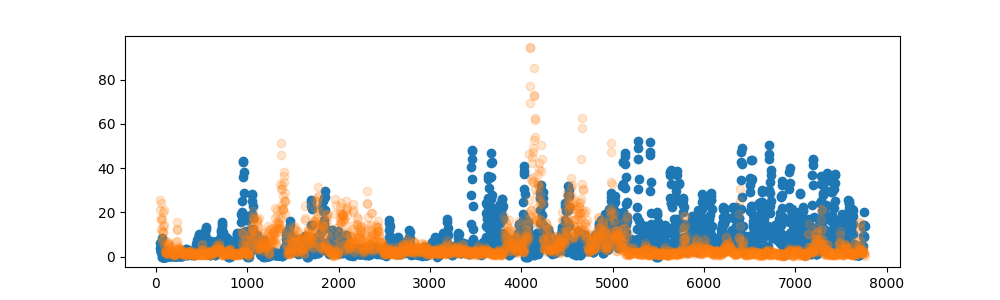

Head
d: 1


/tmp/ipykernel_527480/2680519360.py:505: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


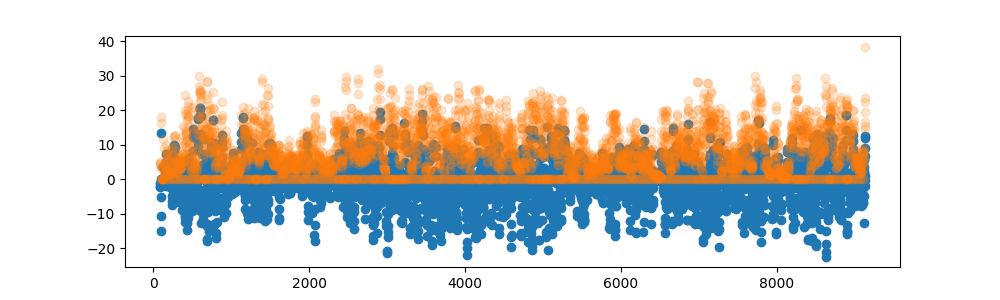

Head
d: 2


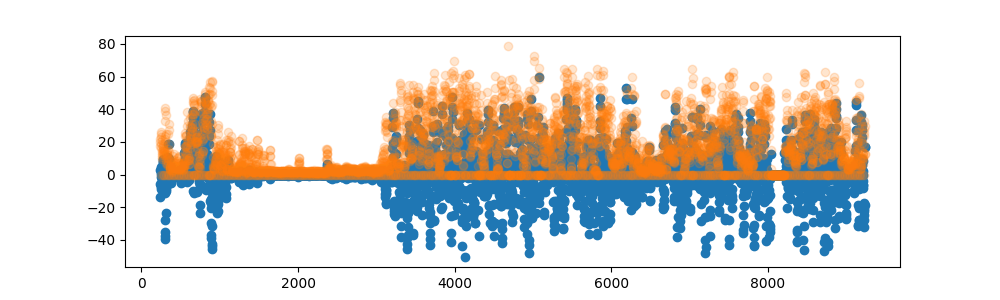

Head
d: 3


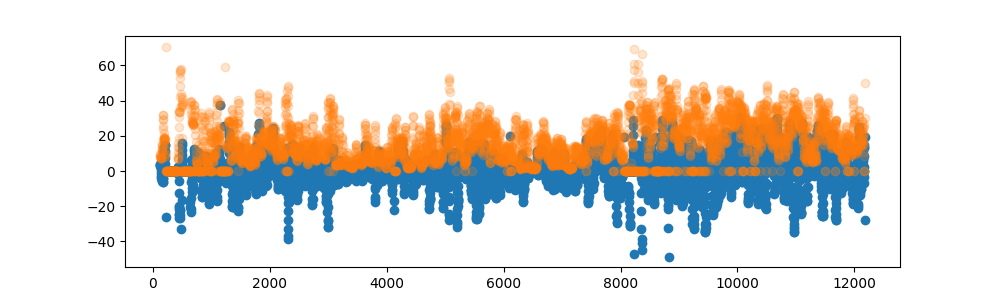

Head
d: 4


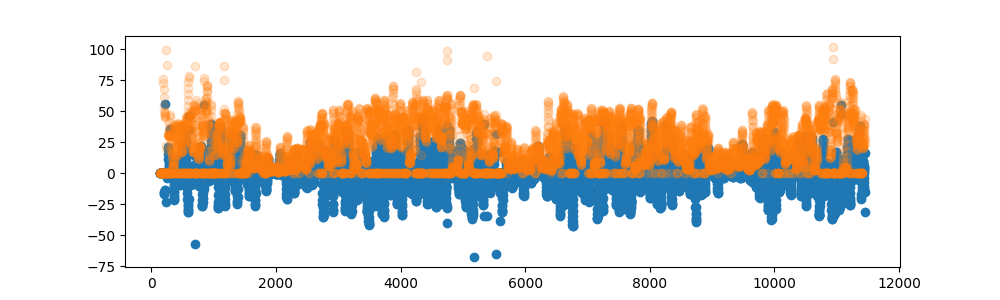

Head


In [130]:
#Define velocity threshold for forward and backward movement
#plot velocity of head
forward_vec= np.zeros((5,8100))
Dorsal_vec = np.zeros((5,8100))
ventral_vec = np.zeros((5,8100))
backward_vec= np.zeros((5,8100))
speed_vec= np.zeros((5,8100))
turn_vec= np.zeros((5,8100))
#%matplotlib widget
velchoice=42
thresh = [0.6,6,6,12,10]# [0.1,0.1,0.1,0.01,0.01]# threshold for forward and backward velocity
head_thresh = [0.2,1.6,3.8,0.006,0.007]
for d in range(5):
    print("d: "+str(d))
    rowsArr_float = copy.deepcopy(MegaData[d,:L[d],:])
    Vel5 = rowsArr_float[:,velchoice]
    Vel5sm = smooth_vec(rowsArr_float[:,velchoice])#dropbottom5perc(droptop5perc(rowsArr_float[:,velchoice],thresh=0.005),thresh=0.005)
    VelH = rowsArr_float[:,22]#dropbottom5perc(droptop5perc(rowsArr_float[:,22],thresh=0.01),thresh=0.01)
    fig = plt.figure(figsize=(10,3))
    ax = fig.add_subplot()
    VelMag = rowsArr_float[:,15]#dropbottom5perc(droptop5perc(rowsArr_float[:,13],thresh=0.005),thresh=0.005)
    VelH_mag = rowsArr_float[:,25]#(droptop5perc(rowsArr_float[:,19],thresh=0.04))
    ax.scatter(rowsArr_float[:,11],rowsArr_float[:,21])
    ax.scatter(rowsArr_float[:,11],VelH_mag,alpha=0.2 )
    #plot_basic_heatmap(rowsArr_float[:,21],VelH_mag)
    plt.show()

    thet = rowsArr_float[:,46]#mid body angular velocity
    print("Head")
    forward_vec[d,:L[d]] = Vel5 > thresh[d]
    backward_vec[d,:L[d]] = Vel5 < -thresh[d]
    speed_vec[d,:L[d]] = VelMag > thresh[d]
    turn_vec[d,:L[d]]  = thet > 10 #moments where the worm takes a turn
    Dorsal_vec = VelH < - head_thresh[d]
    ventral_vec = VelH > head_thresh[d]

In [104]:
# define bins of different variables. and number of bins for each recording
m=1
max_neurons=13
neurons = [0,1,2,3,4,5,6,7,8,27,28,39,40]



In [107]:
x_labels = ['RIAL', 'RIAR', 'RIML', 'RIMR', 'RIBL', 'RIBR', 'sensory', 
            'nrDL', 'loopL', 'nrDR', 'loopR', 'nrVL', 'nrVR']

In [47]:
velchoice=38
time_interval = 20
CorrSlide = np.zeros((5,6,8100))
CorrSlideSm = np.zeros((5,6,8100))
for d in range(5):
    w = convert_time_tofr(time_interval,MegaData[d,:L[d],:])
    CorrSlide[d,:,:L[d]],CorrSlideSm[d,:,:L[d]]= compute_row_correlation_sliding(MegaData[d,:L[d],:], velchoice, [7,8,27,28,39,40],w)

/tmp/ipykernel_527480/2680519360.py:505: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


35.04479968547821


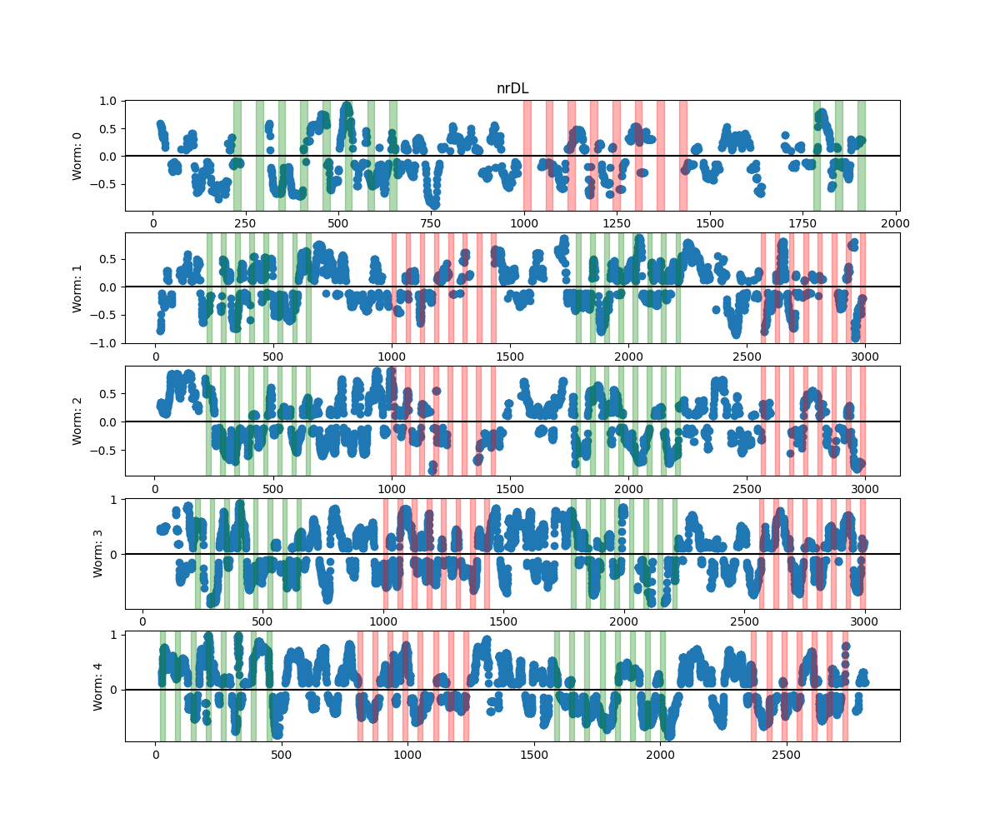

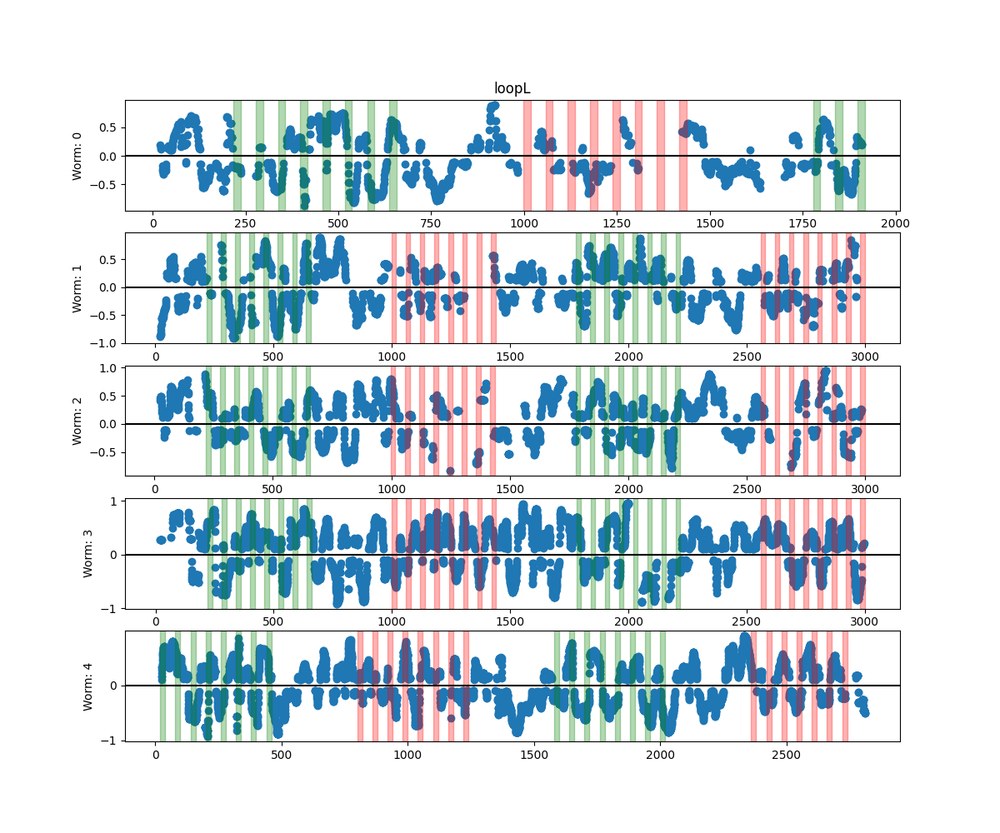

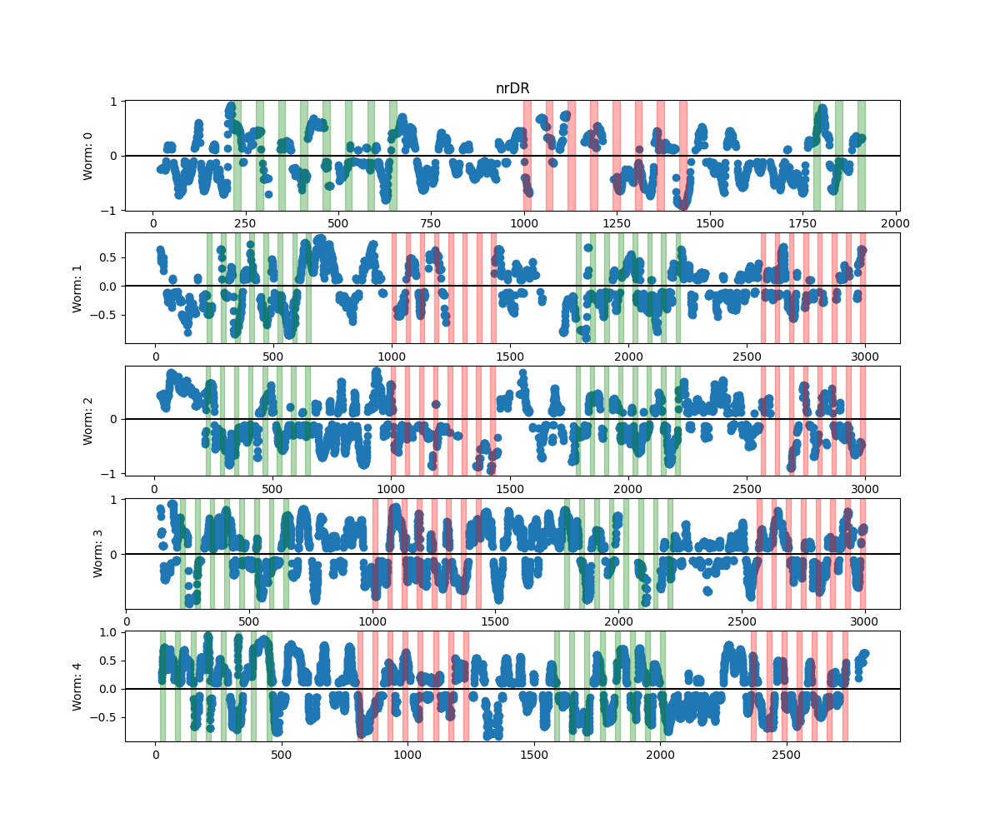

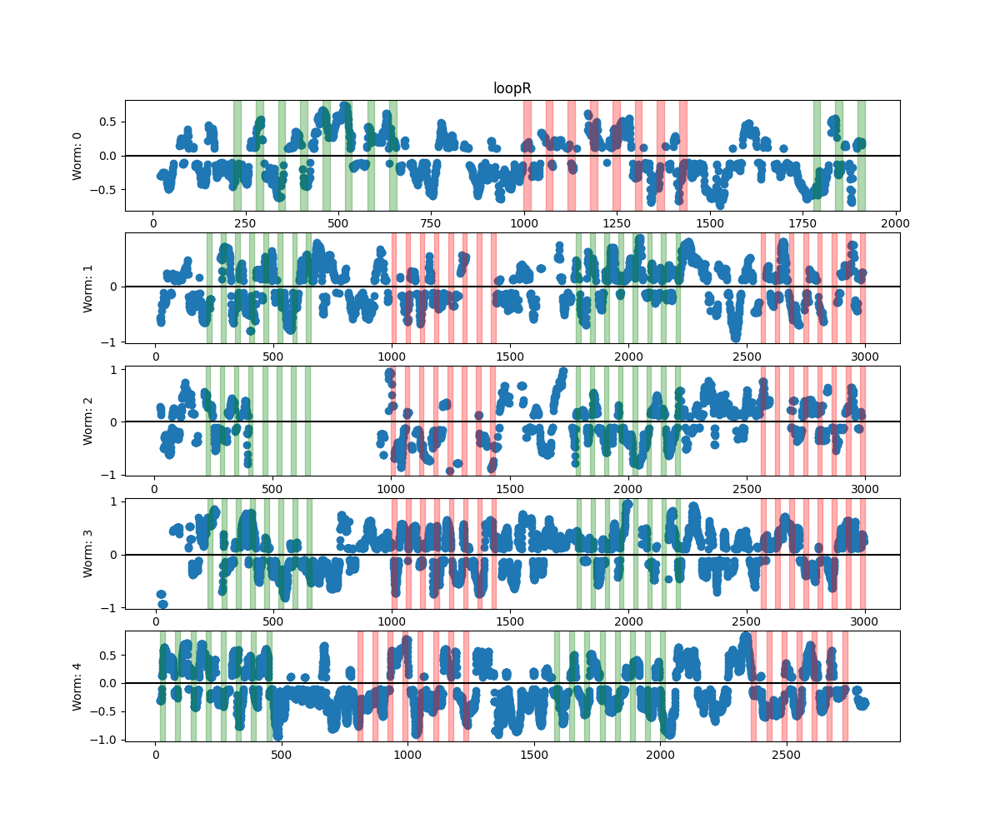

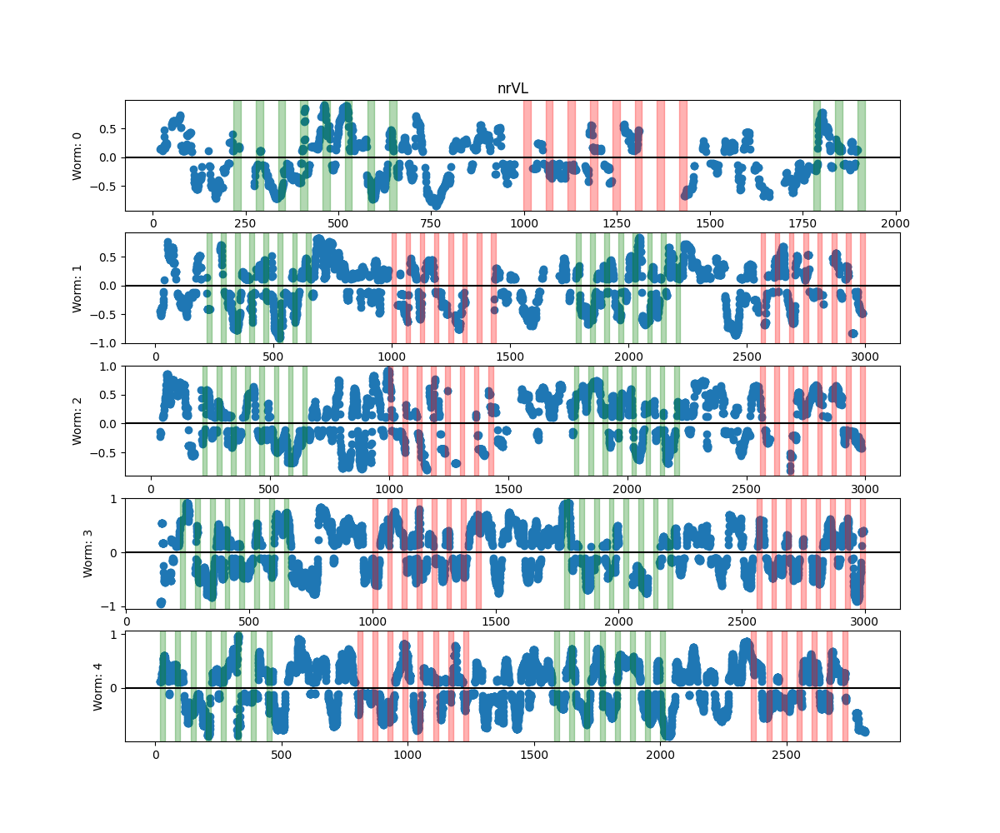

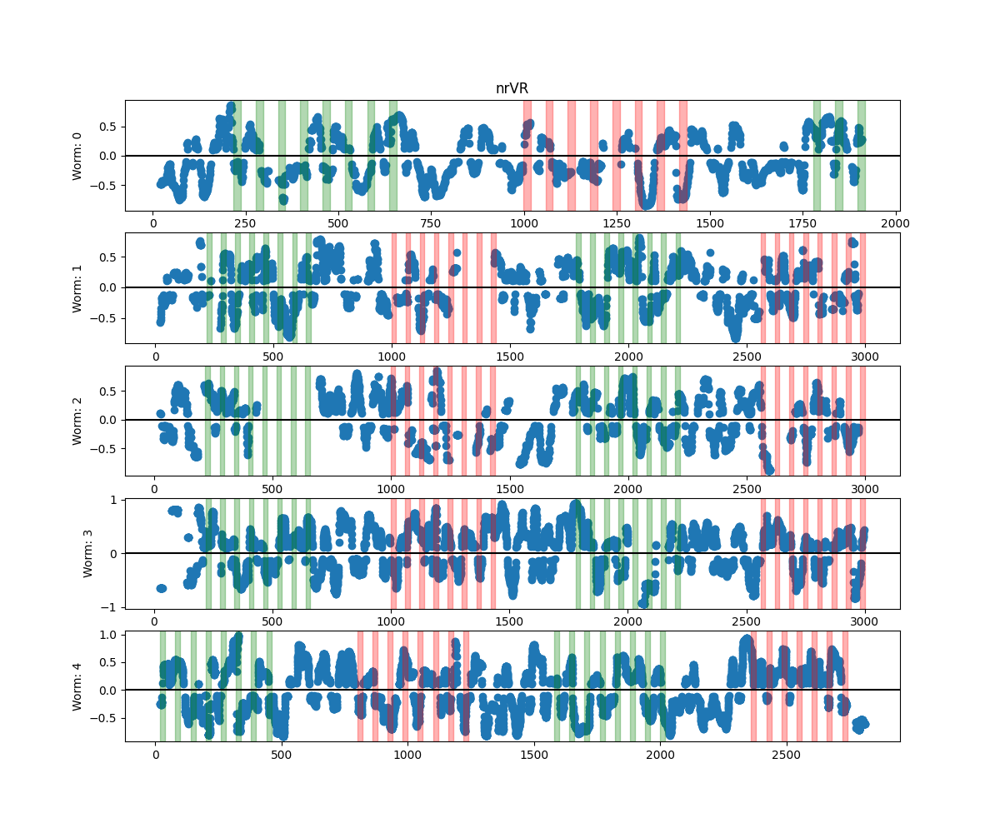

In [49]:
%matplotlib widget
d=4
x_labels = ['RIAL', 'RIAR', 'RIML', 'RIMR', 'RIBL', 'RIBR', 'sensory', 
           'nrDL', 'loopL', 'nrDR', 'loopR', 'nrVL', 'nrVR']
n_label = x_labels[7:]
print(MegaData0[d,103,12]-MegaData0[d,3,12]) 

CorrSlide2 = copy.deepcopy(CorrSlide)
CorrSlide2[np.abs(CorrSlide2)<0.1] = np.nan
CorrSlide2Sm = copy.deepcopy(CorrSlideSm)
CorrSlide2Sm[np.abs(CorrSlide2Sm)<0.1] = np.nan
for n in range(6):
    fig,ax = plt.subplots(5,1,figsize=(12,10))
    for d in range(5):
        startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,:L[d],10]==1)
        start2NN,End2NN = get_nonzero_start_end(MegaData0[d,:L[d],10]==2)
        #rowsArr_float = copy.deepcopy(MegaData[d,:L[d],:])
        ax[d].scatter(MegaData0[d,:L[d],12],CorrSlide2Sm[d,n,:L[d]])
        #ax[d].scatter(MegaData0[d,:L[d],12],V40[n,:],alpha=0.2 )
        ax[d].axhline(0, color='black')
        ax[d].set_ylabel('Worm: '+str(d))
        ax[0].set_title(n_label[n])
        for o in range(len(startIAA)):
            ax[d].axvspan(MegaData0[d,startIAA[o],12],MegaData0[d,EndIAA[o],12], color='green',alpha=0.3)
        for o in range(len(start2NN)):    
            ax[d].axvspan(MegaData0[d,start2NN[o],12],MegaData0[d,End2NN[o],12], color='red',alpha=0.3)
    plt.show()


[2555. 2555. 2555. 2555. 2350.]


/tmp/ipykernel_527480/2680519360.py:505: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


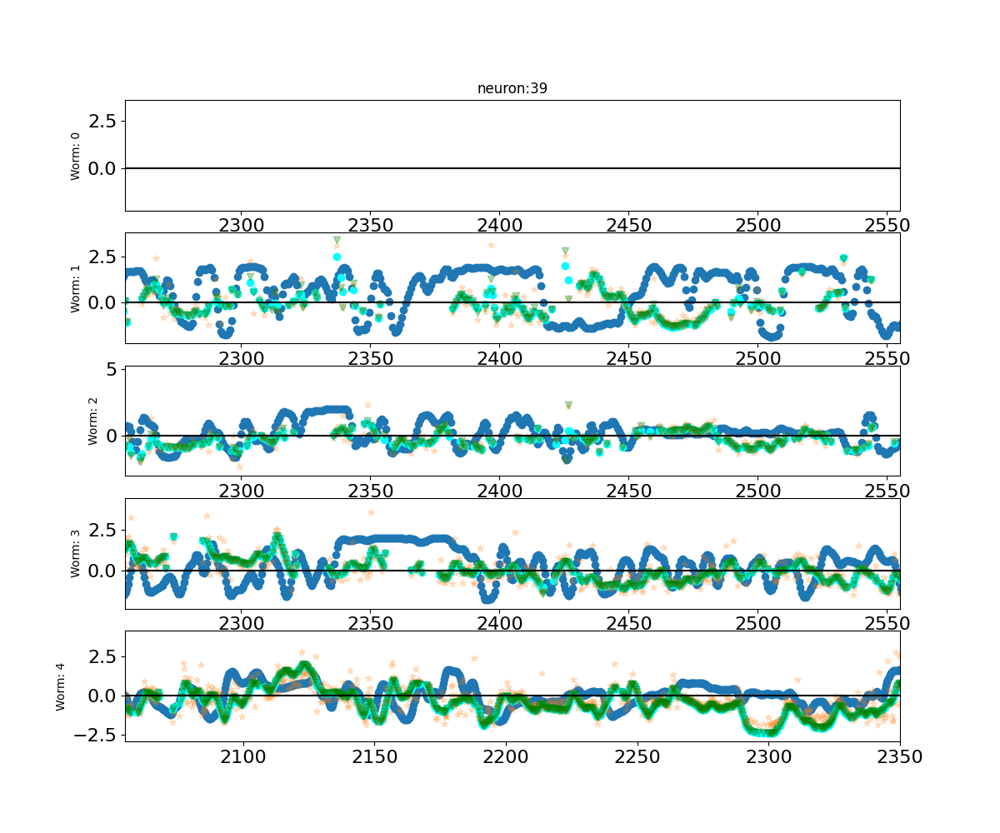

IndexError: index 0 is out of bounds for axis 0 with size 0

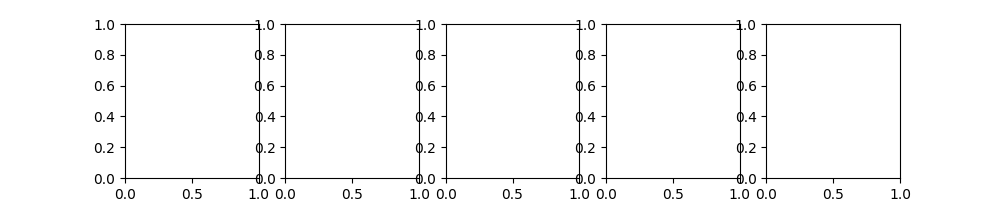

In [59]:
%matplotlib widget
fs=16
#plot 1 behavior variable for all worms
fig,ax = plt.subplots(5,1,figsize=(12,10))

n2=39
velchoice=38
sig=1
roll=-20
Tint = 20
startvec = IAA_int[:,3]# np.ones(5)#IAA_int[:,2]#np.ones(5)#IAA_int[:,2]#np.ones(5)#
endvec = NN_int[:,2]#np.max(MegaData[:,:,12],axis=1)#IAA_int[:,3]#np.max(MegaData[:,:,12],axis=1)#IAA_int[:,3]
roll0 = [0,0,0,0,0]#[29,16,18,21,0]
gap=[7,7,7,10,13]*2
scale = [2,2,2,2,2]
print(endvec)
if True:
    for d in range(5):
        start=0
        end = L[d]
        #start = closest_index(MegaData0[d,:,12],NN_intextra[d,0])
        #end = closest_index(MegaData0[d,:,12],NN_intextra[d,1])
        rowsArr_float = MegaData[d,start:end,:]
        rowsArr_float00 = MegaData0[d,start:end,:]
        rowsArr_float[np.isnan(rowsArr_float[:,velchoice]),velchoice]=0
        for s in range(1,len(rowsArr_float[:,velchoice])):
            if rowsArr_float[s,velchoice]==0:
                rowsArr_float[s,velchoice] = (rowsArr_float[s-1,velchoice]+rowsArr_float[s+1,velchoice])/2
        startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,start:end,10]==1)
        start2NN,End2NN = get_nonzero_start_end(MegaData0[d,start:end,10]==2)
        nonz1  = np.nonzero(rowsArr_float[:,velchoice])        
        Velvec = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        Velvec = np.array(Velvec)
        nonz1  = np.nonzero(rowsArr_float[:,velchoice]) 
        ax[d].scatter(rowsArr_float[nonz1[0],12],scale[d]*((Velvec[nonz1[0]])))
        roll = roll0[d]#0#-convert_time_tofr(Tint,MegaData0[d,:end,:])
        if roll==0:
            n_acti = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        else:
            n_acti = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        n_acti = np.array(n_acti)    
        nonz2=np.nonzero(n_acti)        
        ax[d].scatter(rowsArr_float[nonz2[0],12],(compute_vector_z_score(n_acti[nonz2[0]])),color='cyan')
        ax[d].scatter(rowsArr_float[nonz2[0],12],compute_vector_z_score(rowsArr_float00[nonz2[0],n2]),alpha=0.2,marker='*')
        ax[d].scatter(rowsArr_float[nonz2[0],12],compute_vector_z_score(rowsArr_float[nonz2[0],n2]),alpha=0.3,marker='v',color='green')
        badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,velchoice]==0)
        ax[d].axhline(0, color='black')        
        for o in range(len(startIAA)):
            ax[d].axvspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
        for o in range(len(start2NN)):    
            ax[d].axvspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
        for o in range(len(badfr_start)):
            ax[d].axvspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    
        ax[d].tick_params(axis='x', labelsize=fs)#, rotation=-45)
        ax[d].tick_params(axis='y', labelsize=fs)
        #ax[d].xaxis.set_label_position('top')
        ax[d].set_ylabel('Worm: '+str(d))        
        ax[d].set_xlim(left=startvec[d] ,right=endvec[d]) 
        ax[0].set_title("neuron:"+ str(n2)) 
plt.show()



[2555. 2555. 2555. 2555. 2350.]


/tmp/ipykernel_527480/266934264.py:47: RuntimeWarning: Mean of empty slice
  n_acti = np.nanmean(neuriteActivity,axis=1)


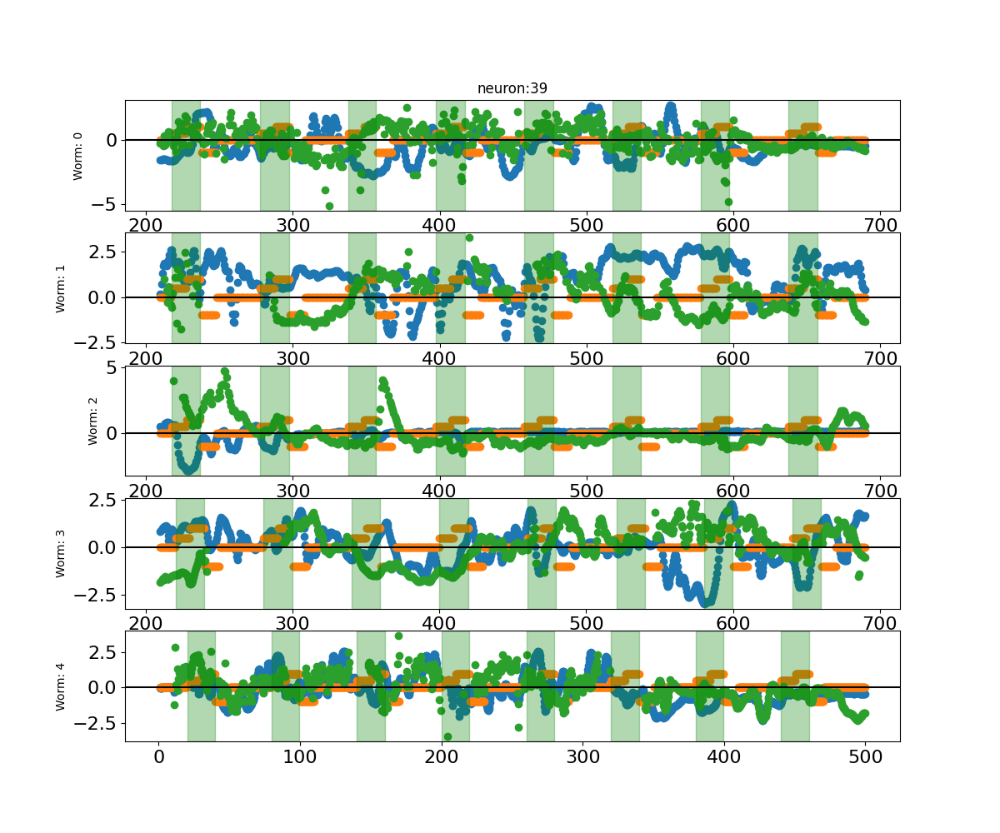

In [131]:
#plot mean of all neurites
%matplotlib widget
fs=16
#plot 1 behavior variable for all worms
fig,ax = plt.subplots(5,1,figsize=(12,10))

n2=39
velchoice=38
sig=1

Tint = 20
startvec = IAA_int[:,3]# np.ones(5)#IAA_int[:,2]#np.ones(5)#IAA_int[:,2]#np.ones(5)#
endvec = NN_int[:,2]#np.max(MegaData[:,:,12],axis=1)#IAA_int[:,3]#np.max(MegaData[:,:,12],axis=1)#IAA_int[:,3]

gap=[7,7,7,10,13]*2
scale = [2,2,2,2,2]
print(endvec)
if True:
    for d in range(5):
        start=0
        end = L[d]
        start = closest_index(MegaData0[d,:,12],IAA_int[d,0])
        end = closest_index(MegaData0[d,:,12],IAA_int[d,1])
        rowsArr_float = MegaData[d,start:end,:]
        rowsArr_float00 = MegaData0[d,start:end,:]
        OdorLabelsSlice = OdorLabels[d,start:end]
        rowsArr_float[np.isnan(rowsArr_float[:,velchoice]),velchoice]=0
        for n in [7,8,27,28,39,40]:
            
            #rowsArr_float[:,n] = smooth_vec_long(rowsArr_float[:,n],sig,gap[d])#add smoothing if needed
            nonz = np.nonzero(rowsArr_float[:,n])
            rowsArr_float[nonz,n] = compute_vector_z_score(rowsArr_float[nonz,n])
            
        for s in range(1,len(rowsArr_float[:,velchoice])):
            if rowsArr_float[s,velchoice]==0:
                rowsArr_float[s,velchoice] = (rowsArr_float[s-1,velchoice]+rowsArr_float[s+1,velchoice])/2
        startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,start:end,10]==1)
        start2NN,End2NN = get_nonzero_start_end(MegaData0[d,start:end,10]==2)
        nonz1  = np.nonzero(rowsArr_float[:,velchoice])        
        Velvec = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        Velvec = np.array(Velvec)
        nonz1  = np.nonzero(rowsArr_float[:,velchoice]) 
        ax[d].scatter(rowsArr_float[nonz1[0],12],scale[d]*(np.arcsin(Velvec[nonz1[0]])))
        ax[d].scatter(rowsArr_float[nonz1[0],12],OdorLabelsSlice[nonz1[0]])
        neuriteActivity = rowsArr_float[:,[7,8,27,28,39,40]]
        neuriteActivity[neuriteActivity==0] = np.nan
        n_acti = np.nanmean(neuriteActivity,axis=1)
        n_acti[np.isnan(n_acti)]=0    
        nonz2=np.nonzero(n_acti)  
        ax[d].scatter(rowsArr_float[nonz2[0],12],(compute_vector_z_score(n_acti[nonz2[0]])))#,color='cyan')
        
        #ax[d].scatter(rowsArr_float[nonz2[0],12],compute_vector_z_score(rowsArr_float00[nonz2[0],n2]),alpha=0.2,marker='*')
        #ax[d].scatter(rowsArr_float[nonz2[0],12],compute_vector_z_score(rowsArr_float[nonz2[0],n2]),alpha=0.3,marker='v',color='green')
        badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,velchoice]==0)
        ax[d].axhline(0, color='black')        
        for o in range(len(startIAA)):
            ax[d].axvspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
        for o in range(len(start2NN)):    
            ax[d].axvspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
        for o in range(len(badfr_start)):
            ax[d].axvspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    
        ax[d].tick_params(axis='x', labelsize=fs)#, rotation=-45)
        ax[d].tick_params(axis='y', labelsize=fs)
        #ax[d].xaxis.set_label_position('top')
        ax[d].set_ylabel('Worm: '+str(d))        
        #ax[d].set_xlim(left=startvec[d] ,right=endvec[d]) 
        ax[0].set_title("neuron:"+ str(n2)) 
plt.show()

/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


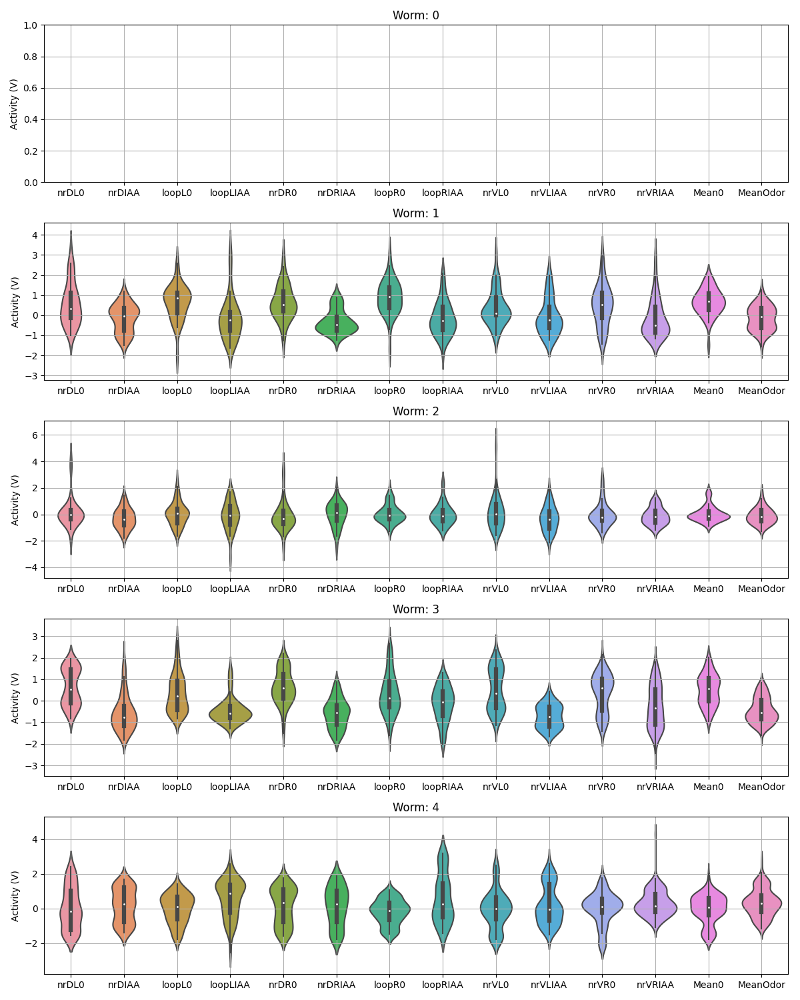

In [150]:
#violin plot during odor
fig, axes = plt.subplots(5, 1, figsize=(12, 15))
IAAonoff = [1.5,-2]#[0.5,-1]

# Loop through each V and create violin plots in subplots
for d in range(5):
    #start=0
    #end = L[d]
    start = closest_index(MegaData0[d,:,12],NN_int[d,2])
    end = closest_index(MegaData0[d,:,12],NN_int[d,3])
    rowsArr_float = MegaData[d,start:end,:]
    for n in [7,8,27,28,39,40]:    
        #rowsArr_float[:,n] = smooth_vec_long(rowsArr_float[:,n],sig,gap[d])#add smoothing if needed
        nonz = np.nonzero(rowsArr_float[:,n])
        rowsArr_float[nonz,n] = compute_vector_z_score(rowsArr_float[nonz,n])
    # Separate V based on odor presence (O)
    odAddLabel = IAAonoff[0]
    odRemoveLabel = IAAonoff[1]
    O = OdorLabels[d,start:end]#MegaData0[d,start:end,10]
    V_odor = rowsArr_float[O == odAddLabel,:]      # Values when odor is present
    V_no_odor = rowsArr_float[O == odRemoveLabel,:]   # Values when odor is absent
    
    neuriteActivity = rowsArr_float[:,[7,8,27,28,39,40]]
    neuriteActivity[neuriteActivity==0] = np.nan
    n_acti = np.nanmean(neuriteActivity,axis=1)
    n_acti[np.isnan(n_acti)]=0 
    Mean_odor = n_acti[O == odAddLabel]      # Values when odor is present
    Mean_no_odor = n_acti[O == odRemoveLabel]

    
    # Prepare data for violin plots
    data = [V_no_odor[np.nonzero(V_no_odor[:,7])[0],7], V_odor[np.nonzero(V_odor[:,7])[0],7],V_no_odor[np.nonzero(V_no_odor[:,8])[0],8],
            V_odor[np.nonzero(V_odor[:,8])[0],8],V_no_odor[np.nonzero(V_no_odor[:,27])[0],27], V_odor[np.nonzero(V_odor[:,27])[0],27],
    V_no_odor[np.nonzero(V_no_odor[:,28])[0],28],V_odor[np.nonzero(V_odor[:,28])[0],28],V_no_odor[np.nonzero(V_no_odor[:,39])[0],39],
    V_odor[np.nonzero(V_odor[:,39])[0],39],V_no_odor[np.nonzero(V_no_odor[:,40])[0],40], V_odor[np.nonzero(V_odor[:,40])[0],40],
    Mean_no_odor[np.nonzero(Mean_no_odor)[0]], Mean_odor[np.nonzero(Mean_odor)[0]]]
    
    # Get the subplot axis
    ax = axes[d]
    
    # Plot the violin plot on the specific axis
    sns.violinplot(data=data, ax=ax)
    Xpose = [0, 1,2,3,4,5,6,7,8,9,10,11,12,13]
    
    # Set labels and title for the subplot
    ax.set_xticks(Xpose)
    ax.set_xticklabels(['nrDL0', 'nrDIAA','loopL0', 'loopLIAA','nrDR0', 'nrDRIAA','loopR0', 'loopRIAA','nrVL0', 'nrVLIAA',
                       'nrVR0', 'nrVRIAA','Mean0','MeanOdor'])
    ax.set_title("Worm: "+ str(d))
    ax.set_ylabel('Activity (V)')

    ax.grid(True)
plt.tight_layout()
plt.show()

/tmp/ipykernel_527480/2984877564.py:25: RuntimeWarning: Mean of empty slice
  n_acti = np.nanmean(neuriteActivity,axis=1)


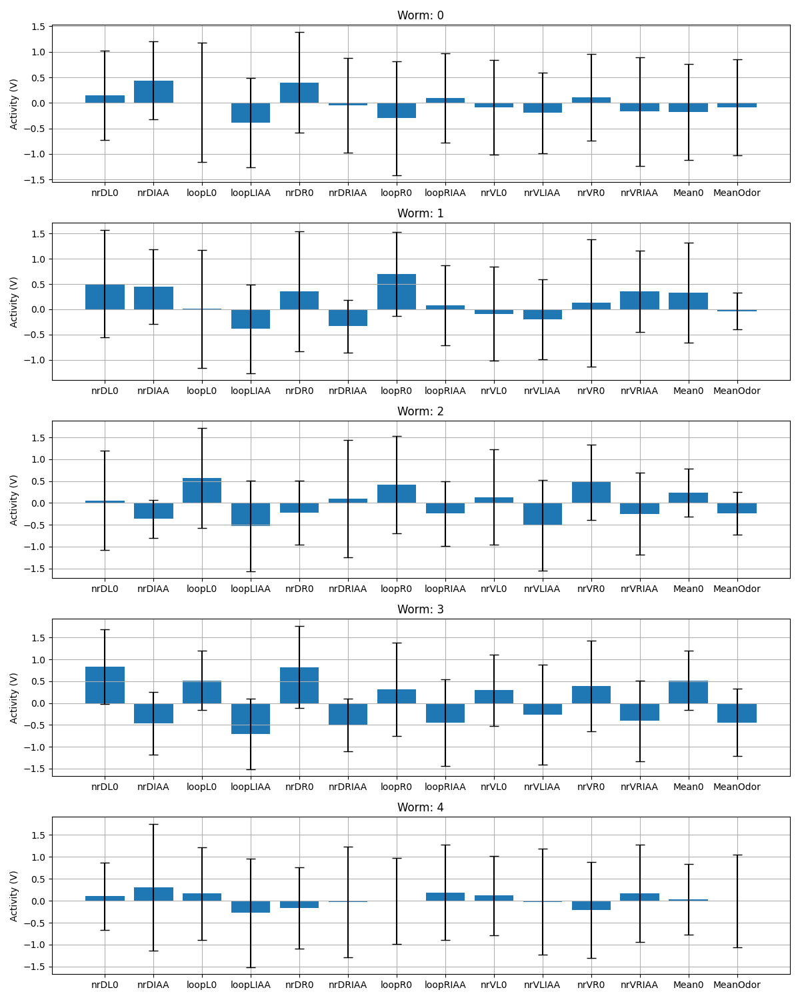

In [149]:
#bar plots
fig, axes = plt.subplots(5, 1, figsize=(12, 15))
IAAonoff = [1.5,-2]#[0.5,-1]

# Loop through each V and create violin plots in subplots
for d in range(5):
    #start=0
    #end = L[d]
    start = closest_index(MegaData0[d,:,12],NN_int[d,0])
    end = closest_index(MegaData0[d,:,12],NN_int[d,1])
    rowsArr_float = MegaData[d,start:end,:]
    for n in [7,8,27,28,39,40]:    
        #rowsArr_float[:,n] = smooth_vec_long(rowsArr_float[:,n],sig,gap[d])#add smoothing if needed
        nonz = np.nonzero(rowsArr_float[:,n])
        rowsArr_float[nonz,n] = compute_vector_z_score(rowsArr_float[nonz,n])
    # Separate V based on odor presence (O)
    odAddLabel = IAAonoff[0]
    odRemoveLabel = IAAonoff[1]
    O = OdorLabels[d,start:end]#MegaData0[d,start:end,10]
    V_odor = rowsArr_float[O == odAddLabel,:]      # Values when odor is present
    V_no_odor = rowsArr_float[O == odRemoveLabel,:]   # Values when odor is absent
    
    neuriteActivity = rowsArr_float[:,[7,8,27,28,39,40]]
    neuriteActivity[neuriteActivity==0] = np.nan
    n_acti = np.nanmean(neuriteActivity,axis=1)
    n_acti[np.isnan(n_acti)]=0 
    Mean_odor = n_acti[O == odAddLabel]      # Values when odor is present
    Mean_no_odor = n_acti[O == odRemoveLabel]

    
    # Prepare data for violin plots
    data = [V_no_odor[np.nonzero(V_no_odor[:,7])[0],7], V_odor[np.nonzero(V_odor[:,7])[0],7],V_no_odor[np.nonzero(V_no_odor[:,8])[0],8],
            V_odor[np.nonzero(V_odor[:,8])[0],8],V_no_odor[np.nonzero(V_no_odor[:,27])[0],27], V_odor[np.nonzero(V_odor[:,27])[0],27],
    V_no_odor[np.nonzero(V_no_odor[:,28])[0],28],V_odor[np.nonzero(V_odor[:,28])[0],28],V_no_odor[np.nonzero(V_no_odor[:,39])[0],39],
    V_odor[np.nonzero(V_odor[:,39])[0],39],V_no_odor[np.nonzero(V_no_odor[:,40])[0],40], V_odor[np.nonzero(V_odor[:,40])[0],40],
    Mean_no_odor[np.nonzero(Mean_no_odor)[0]], Mean_odor[np.nonzero(Mean_odor)[0]]]
    
    means = [np.nanmean(d) for d in data]  # Calculate the mean for each set
    stds = [np.nanstd(d) for d in data]    # Calculate the standard deviation for each set
    ax = axes[d]
    
    # Plot the bar plot on the specific axis
    ax.bar(range(len(means)), means, yerr=stds, capsize=5)
    ax.set_xticks(range(len(means)))
    ax.set_xticklabels(['nrDL0', 'nrDIAA','loopL0', 'loopLIAA','nrDR0', 'nrDRIAA','loopR0', 'loopRIAA','nrVL0', 'nrVLIAA',
                       'nrVR0', 'nrVRIAA','Mean0','MeanOdor'])
    ax.set_title("Worm: "+ str(d))
    ax.set_ylabel('Activity (V)')

    ax.grid(True)
plt.tight_layout()
plt.show()

/tmp/ipykernel_527480/3891451727.py:511: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]
/tmp/ipykernel_527480/3891451727.py:257: RuntimeWarning: Mean of empty slice
  n_acti = np.nanmean(neuriteActivity,axis=1)


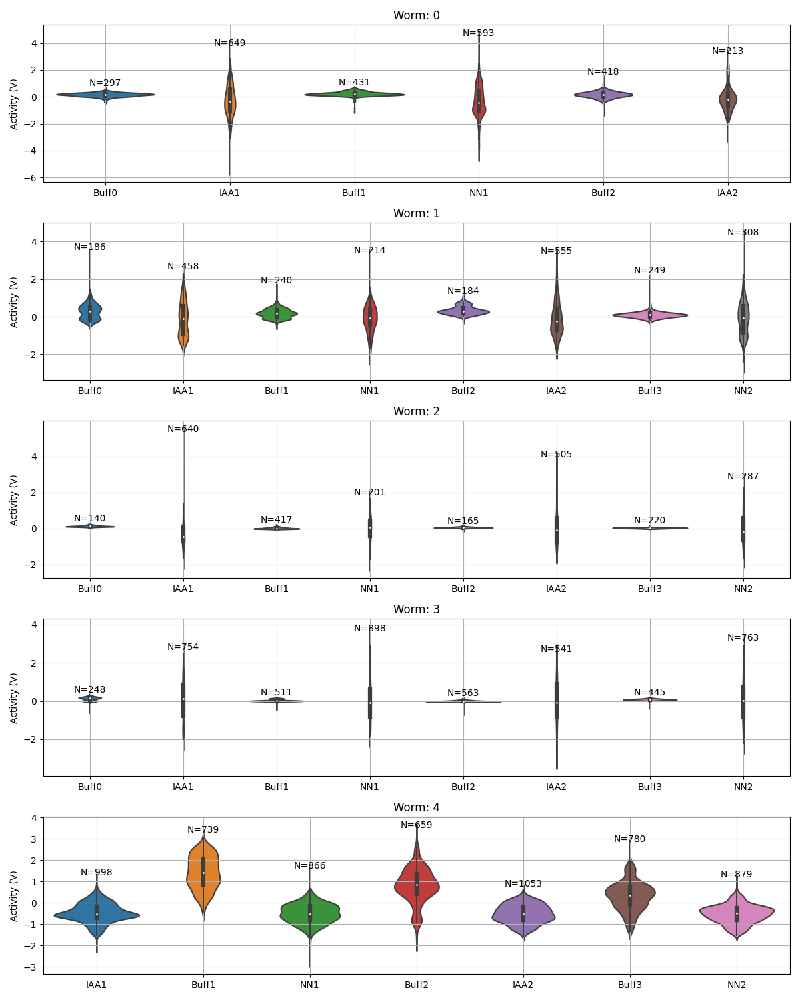

In [174]:
#violin plot during odor
series_label = ['Buff0', 'IAA1','Buff1', 'NN1','Buff2', 'IAA2','Buff3', 'NN2']
Xpose = [0,1,2,3,4,5,6,7]
fig, axes = plt.subplots(5, 1, figsize=(12, 15))
IAAonoff = [1.5,-2]#[0.5,-1]

# Loop through each V and create violin plots in subplots
MegaData2sm = copy.deepcopy(MegaData)
for d in range(5):    
    for n in [7,8,27,28,39,40]:    
        MegaData2sm[d,:,n] = smooth_vec_long(MegaData2sm[d,:,n],sig,gap[d])#add smoothing if needed
        nonz = np.nonzero(MegaData2sm[d,:,n])
        MegaData2sm[d,nonz,n]= compute_vector_z_score(MegaData2sm[d,nonz,n])
    MeanNeurite = get_neurite_nanmean(MegaData2sm[d,:,:])    
    if d<4:
        start = closest_index(MegaData0[d,:,12],2)
        end = closest_index(MegaData0[d,:,12],IAA_int[d,0])
        rowsArr_floatBuff0= MegaData2sm[d,start:end,:]
        MeanBuff0 = MeanNeurite[start:end]

    start = closest_index(MegaData0[d,:,12],IAA_int[d,0])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,1])
    rowsArr_floatIAA1 = MegaData2sm[d,start:end,:]
    MeanIAA1 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],IAA_int[d,1])
    end = closest_index(MegaData0[d,:,12],NN_int[d,0])
    rowsArr_floatBuff1 = MegaData2sm[d,start:end,:]
    MeanBuff1 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],NN_int[d,0])
    end = closest_index(MegaData0[d,:,12],NN_int[d,1])
    rowsArr_floatNN1 = MegaData2sm[d,start:end,:]
    MeanNN1 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],NN_int[d,1])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,2])
    rowsArr_floatBuff2 = MegaData2sm[d,start:end,:]
    MeanBuff2 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],IAA_int[d,2])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,3])
    rowsArr_floatIAA2 = MegaData2sm[d,start:end,:]
    MeanIAA2 = MeanNeurite[start:end]
    if d>0:
        start = closest_index(MegaData0[d,:,12],IAA_int[d,3])
        end = closest_index(MegaData0[d,:,12],NN_int[d,2])
        rowsArr_floatBuff3 = MegaData2sm[d,start:end,:]
        MeanBuff3 = MeanNeurite[start:end]
        start = closest_index(MegaData0[d,:,12],NN_int[d,2])
        end = closest_index(MegaData0[d,:,12],NN_int[d,3])
        rowsArr_floatNN2 = MegaData2sm[d,start:end,:]
        MeanNN2 = MeanNeurite[start:end]
    
    # Separate V based on odor presence (O)
    '''
    odAddLabel = IAAonoff[0]
    odRemoveLabel = IAAonoff[1]
    O = OdorLabels[d,start:end]#MegaData0[d,start:end,10]
    V_odor = rowsArr_float[O == odAddLabel,:]      # Values when odor is present
    V_no_odor = rowsArr_float[O == odRemoveLabel,:]   # Values when odor is absent
    
    neuriteActivity = rowsArr_float[:,[7,8,27,28,39,40]]
    neuriteActivity[neuriteActivity==0] = np.nan
    n_acti = np.nanmean(neuriteActivity,axis=1)
    n_acti[np.isnan(n_acti)]=0 
    Mean_odor = n_acti[O == odAddLabel]      # Values when odor is present
    Mean_no_odor = n_acti[O == odRemoveLabel]
    '''
    
    # Prepare data for violin plots
    if d>0 and d<4:
        data = [MeanBuff0[np.nonzero(MeanBuff0)[0]],MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                MeanBuff3[np.nonzero(MeanBuff3)[0]],MeanNN2[np.nonzero(MeanNN2)[0]]]
        series_label2 =series_label
        Xpose2 = Xpose
    elif d==0: 
        data = [MeanBuff0[np.nonzero(MeanBuff0)[0]],MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                ]
        series_label2 =series_label[:-2]
        Xpose2 = Xpose[:-2]
    elif d==4:
        data = [MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                MeanBuff3[np.nonzero(MeanBuff3)[0]],MeanNN2[np.nonzero(MeanNN2)[0]]]
        series_label2 =series_label[1:]
        Xpose2 = Xpose[:-1]
    # Get the subplot axis
    ax = axes[d]
    
    # Plot the violin plot on the specific axis
    sns.violinplot(data=data, ax=ax)
    for i, dset in enumerate(data):
        num_points = len(dset)
        ax.text(i, max(dset) * 1.05, f'N={num_points}', ha='center', va='bottom', fontsize=10, color='black')
    
    # Set labels and title for the subplot
    ax.set_xticks(Xpose2)
    ax.set_xticklabels(series_label2)
    ax.set_title("Worm: "+ str(d))
    ax.set_ylabel('Activity (V)')
    #ax.set_ylim(bottom=-1 ,top=1) 
    ax.grid(True)
plt.tight_layout()
plt.show()

In [177]:
sig

1

/tmp/ipykernel_527480/3891451727.py:511: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]
/tmp/ipykernel_527480/3891451727.py:257: RuntimeWarning: Mean of empty slice
  n_acti = np.nanmean(neuriteActivity,axis=1)


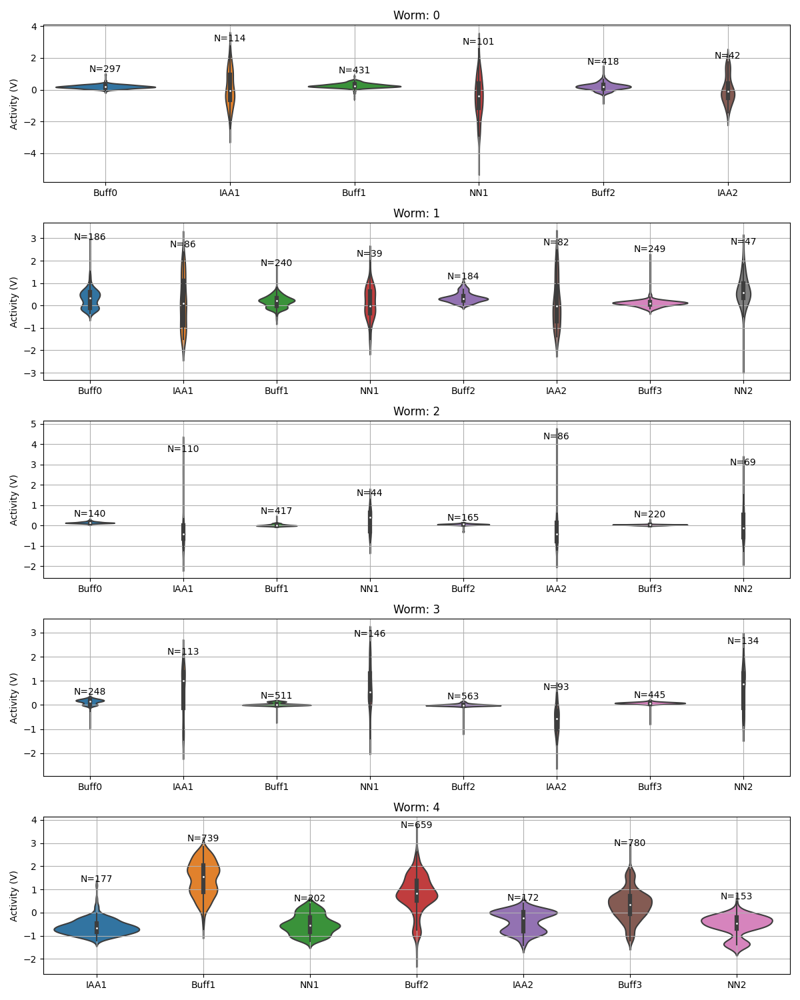

In [179]:

#violin plot during odor series and buffer
series_label = ['Buff0', 'IAA1','Buff1', 'NN1','Buff2', 'IAA2','Buff3', 'NN2']
Xpose = [0,1,2,3,4,5,6,7]
fig, axes = plt.subplots(5, 1, figsize=(12, 15))
IAAonoff = [1.5,-2]#[0.5,-1]
sig=4
# Loop through each V and create violin plots in subplots
MegaData2sm = copy.deepcopy(MegaData)
for d in range(5):    
    for n in [7,8,27,28,39,40]:    
        MegaData2sm[d,:,n] = smooth_vec_long(MegaData2sm[d,:,n],sig,gap[d])#add smoothing if needed
        nonz = np.nonzero(MegaData2sm[d,:,n])
        MegaData2sm[d,nonz,n]= compute_vector_z_score(MegaData2sm[d,nonz,n])
    MeanNeurite = get_neurite_nanmean(MegaData2sm[d,:,:])    
    if d<4:
        start = closest_index(MegaData0[d,:,12],2)
        end = closest_index(MegaData0[d,:,12],IAA_int[d,0])
        rowsArr_floatBuff0= MegaData2sm[d,start:end,:]
        #MeanBuff0 = MeanNeurite[start:end]
        

    start = closest_index(MegaData0[d,:,12],IAA_int[d,0])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,1])
    rowsArr_floatIAA1 = MegaData2sm[d,start:end,:]
    MeanIAA1 = MeanNeurite[start:end]
    O = OdorLabels[d,start:end]
    #MeanIAA1 = MeanIAA1[O<0]
    
    start = closest_index(MegaData0[d,:,12],IAA_int[d,1])
    end = closest_index(MegaData0[d,:,12],NN_int[d,0])
    rowsArr_floatBuff1 = MegaData2sm[d,start:end,:]
    #MeanBuff1 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],NN_int[d,0])
    end = closest_index(MegaData0[d,:,12],NN_int[d,1])
    rowsArr_floatNN1 = MegaData2sm[d,start:end,:]
    MeanNN1 = MeanNeurite[start:end]
    O = OdorLabels[d,start:end]
    #MeanNN1 = MeanNN1[O<0]
    
    start = closest_index(MegaData0[d,:,12],NN_int[d,1])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,2])
    rowsArr_floatBuff2 = MegaData2sm[d,start:end,:]
    MeanBuff2 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],IAA_int[d,2])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,3])
    rowsArr_floatIAA2 = MegaData2sm[d,start:end,:]
    MeanIAA2 = MeanNeurite[start:end]
    O = OdorLabels[d,start:end]
    #MeanIAA2 = MeanIAA2[O<0]
    if d>0:
        start = closest_index(MegaData0[d,:,12],IAA_int[d,3])
        end = closest_index(MegaData0[d,:,12],NN_int[d,2])
        rowsArr_floatBuff3 = MegaData2sm[d,start:end,:]
        MeanBuff3 = MeanNeurite[start:end]
        start = closest_index(MegaData0[d,:,12],NN_int[d,2])
        end = closest_index(MegaData0[d,:,12],NN_int[d,3])
        rowsArr_floatNN2 = MegaData2sm[d,start:end,:]
        MeanNN2 = MeanNeurite[start:end]
        O = OdorLabels[d,start:end]
        #MeanNN2= MeanNN2[O<0]
    
    # Prepare data for violin plots
    if d>0 and d<4:
        data = [MeanBuff0[np.nonzero(MeanBuff0)[0]],MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                MeanBuff3[np.nonzero(MeanBuff3)[0]],MeanNN2[np.nonzero(MeanNN2)[0]]]
        series_label2 =series_label
        Xpose2 = Xpose
    elif d==0: 
        data = [MeanBuff0[np.nonzero(MeanBuff0)[0]],MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                ]
        series_label2 =series_label[:-2]
        Xpose2 = Xpose[:-2]
    elif d==4:
        data = [MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                MeanBuff3[np.nonzero(MeanBuff3)[0]],MeanNN2[np.nonzero(MeanNN2)[0]]]
        series_label2 =series_label[1:]
        Xpose2 = Xpose[:-1]
    # Get the subplot axis
    ax = axes[d]
    
    # Plot the violin plot on the specific axis
    sns.violinplot(data=data, ax=ax)
    for i, dset in enumerate(data):
        num_points = len(dset)
        ax.text(i, max(dset) * 1.05, f'N={num_points}', ha='center', va='bottom', fontsize=10, color='black')
    
    # Set labels and title for the subplot
    ax.set_xticks(Xpose2)
    ax.set_xticklabels(series_label2)
    ax.set_title("Worm: "+ str(d))
    ax.set_ylabel('Activity (V)')
    #ax.set_ylim(bottom=-1 ,top=1) 
    ax.grid(True)
plt.tight_layout()
plt.show()

/tmp/ipykernel_527480/3891451727.py:511: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]
/tmp/ipykernel_527480/3891451727.py:257: RuntimeWarning: Mean of empty slice
  n_acti = np.nanmean(neuriteActivity,axis=1)


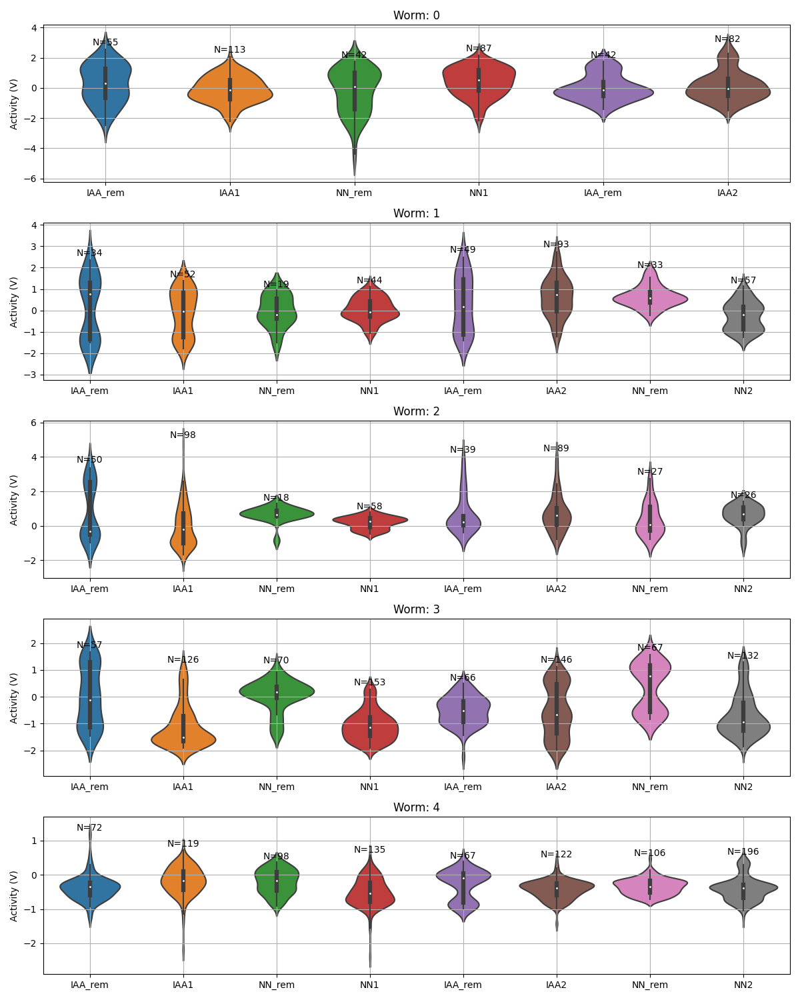

In [184]:

#violin plot during odor
series_label = ['IAA_rem', 'IAA1','NN_rem', 'NN1','IAA_rem', 'IAA2','NN_rem', 'NN2']
Xpose = [0,1,2,3,4,5,6,7]
fig, axes = plt.subplots(5, 1, figsize=(12, 15))
IAAonoff = [1.5,-2]#[0.5,-1]
sig=4
# Loop through each V and create violin plots in subplots
MegaData2sm = copy.deepcopy(MegaData)
for d in range(5):    
    for n in [7,8,27,28,39,40]:    
        MegaData2sm[d,:,n] = smooth_vec_long(MegaData2sm[d,:,n],sig,gap[d])#add smoothing if needed
        nonz = np.nonzero(MegaData2sm[d,:,n])
        MegaData2sm[d,nonz,n]= compute_vector_z_score(MegaData2sm[d,nonz,n])
    MeanNeurite = get_neurite_nanmean(MegaData2sm[d,:,:])    
        
    start = closest_index(MegaData0[d,:,12],IAA_int[d,0])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,1]-240)
    rowsArr_floatIAA1 = MegaData2sm[d,start:end,:]
    MeanIAA1 = MeanNeurite[start:end]
    O = OdorLabels4sec[d,start:end]
    MeanBuff0 = MeanIAA1[O<0]
    MeanIAA1 = MeanIAA1[O>0]
    
    
    start = closest_index(MegaData0[d,:,12],NN_int[d,0])
    end = closest_index(MegaData0[d,:,12],NN_int[d,1]-240)
    rowsArr_floatNN1 = MegaData2sm[d,start:end,:]
    MeanNN1 = MeanNeurite[start:end]
    O = OdorLabels4sec[d,start:end]
    MeanBuff1 = MeanNN1[O<0]
    MeanNN1 = MeanNN1[O>0]
    
    start = closest_index(MegaData0[d,:,12],IAA_int[d,2])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,3]-240)
    rowsArr_floatIAA2 = MegaData2sm[d,start:end,:]
    MeanIAA2 = MeanNeurite[start:end]
    O = OdorLabels4sec[d,start:end]
    MeanBuff2 = MeanIAA2[O<0]
    MeanIAA2 = MeanIAA2[O>0]
    if d>0:
        start = closest_index(MegaData0[d,:,12],NN_int[d,2])
        end = closest_index(MegaData0[d,:,12],NN_int[d,3]-240)
        rowsArr_floatNN2 = MegaData2sm[d,start:end,:]
        MeanNN2 = MeanNeurite[start:end]
        O = OdorLabels4sec[d,start:end]
        MeanBuff3 = MeanNN2[O<0]
        MeanNN2= MeanNN2[O>0]
    
    # Prepare data for violin plots
    if d>0:
        data = [MeanBuff0[np.nonzero(MeanBuff0)[0]],MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                MeanBuff3[np.nonzero(MeanBuff3)[0]],MeanNN2[np.nonzero(MeanNN2)[0]]]
        series_label2 =series_label
        Xpose2 = Xpose
    elif d==0: 
        data = [MeanBuff0[np.nonzero(MeanBuff0)[0]],MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                ]
        series_label2 =series_label[:-2]
        Xpose2 = Xpose[:-2]
    # Get the subplot axis
    ax = axes[d]
    
    # Plot the violin plot on the specific axis
    sns.violinplot(data=data, ax=ax)
    for i, dset in enumerate(data):
        num_points = len(dset)
        ax.text(i, max(dset) * 1.05, f'N={num_points}', ha='center', va='bottom', fontsize=10, color='black')
    
    # Set labels and title for the subplot
    ax.set_xticks(Xpose2)
    ax.set_xticklabels(series_label2)
    ax.set_title("Worm: "+ str(d))
    ax.set_ylabel('Activity (V)')
    #ax.set_ylim(bottom=-1 ,top=1) 
    ax.grid(True)
plt.tight_layout()
plt.show()

/tmp/ipykernel_527480/3891451727.py:511: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


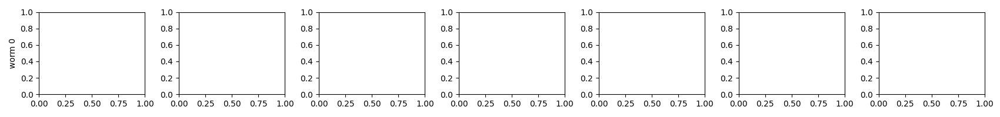

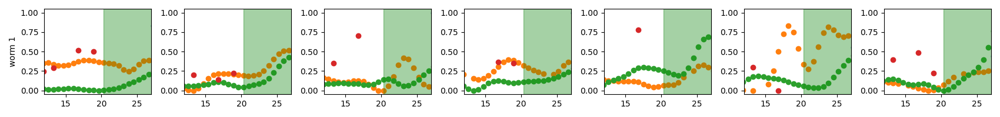

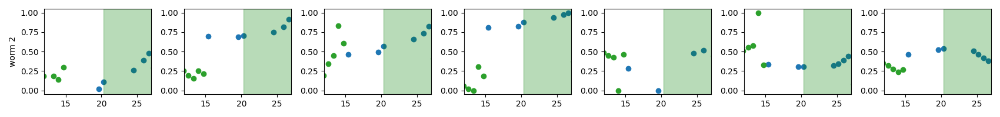

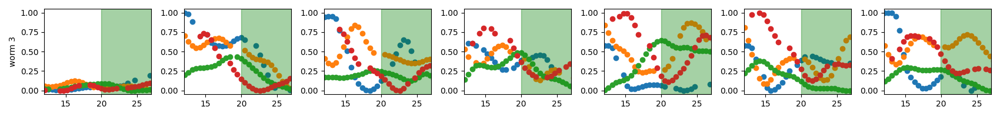

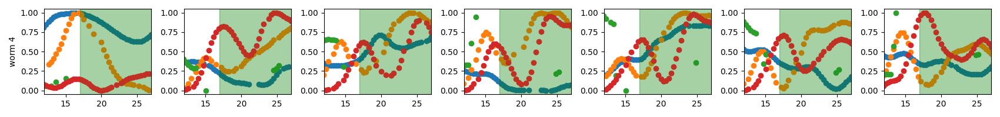

In [229]:
neurons=[6,7,8,27,28,39,40]
o0=24
of=28
sig=1
MegaData2sm = copy.deepcopy(MegaData)
for d in range(5):
    for n in [6,7,8,27,28,39,40]:    
        MegaData2sm[d,:,n] = smooth_vec_long(MegaData2sm[d,:,n],sig,gap[d])#add smoothing if needed
        nonz = np.nonzero(MegaData2sm[d,:,n])
        #MegaData2sm[d,nonz,n]= compute_vector_z_score(MegaData2sm[d,nonz,n])
for d in range(5):
    rowsArr_float = np.copy(MegaData2sm[d,:L[d],:])
    sec0 = closest_index(MegaData0[d,:,12],2)
    sec20 = closest_index(MegaData0[d,:,12],22)
    sec40 = closest_index(MegaData0[d,:,12],42)
    interval20 = int(sec20-sec0)
    interval40 = int(sec40-sec0)
    start,end = get_nonzero_start_end(MegaData0[d,:L[d],10])
    fig,ax = plt.subplots(1,7,figsize=(17,2))
    num_time_pts = int(interval20+interval40)#start[1]-start[0]#make the number of timepoint bigger for the data_odor matrix
    data_odor = np.zeros((of-o0,num_time_pts,len(neurons)))
    ax[0].set_ylabel('worm '+str(d))  
    
    for o in range(o0,of):# number of odor pulses
        count=0#neurons count
        if o <len(start):
            s = start[o]-interval20
            e = int(start[o]+interval40)
            for n in neurons:
                activity = compute_vector_z_score(rowsArr_float[s:e,n])
                nonz = np.nonzero(activity)[0]
                if d==0:
                    ax[count].set_title(str(n))
                if len(nonz)>2:
                    time = MegaData0[d,s:e,12]
                    activity[nonz] = (activity[nonz] - np.min(activity[nonz]))/(np.max(activity[nonz]) - np.min(activity[nonz]))#(activity[nonz] - activity[nonz[0]])#start activity from zero
                    lim = np.min([len(time),activity.shape[0]])
                    data_odor[o-o0,:lim,count]= activity
                    ax[count].scatter(time[nonz]-time[0],activity[nonz])#,c='blue')
                    Odortime = time[interval20]-time[0]
                    if d<4:
                        ax[count].axvspan(Odortime,Odortime+20,color='green',alpha=0.1)
                    else:
                         ax[count].axvspan(Odortime-3,Odortime+17,color='green',alpha=0.1)
                    #ax[count].set_ylim(-1,1.5)
                    ax[count].set_xlim(12,27)
                count=count+1    
      
    mean_odor = np.nanmean(data_odor,axis=0)
    count=0#neurons count
    for n in neurons:
        #ax[count].scatter(rowsArr_float[:num_time_pts,12],mean_odor[:,count],color='black')#,lw=4)#,c='blue')
        count=count+1
    plt.tight_layout()  
    plt.show()

/tmp/ipykernel_527480/3891451727.py:511: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]
/tmp/ipykernel_527480/3891451727.py:257: RuntimeWarning: Mean of empty slice
  n_acti = np.nanmean(neuriteActivity,axis=1)


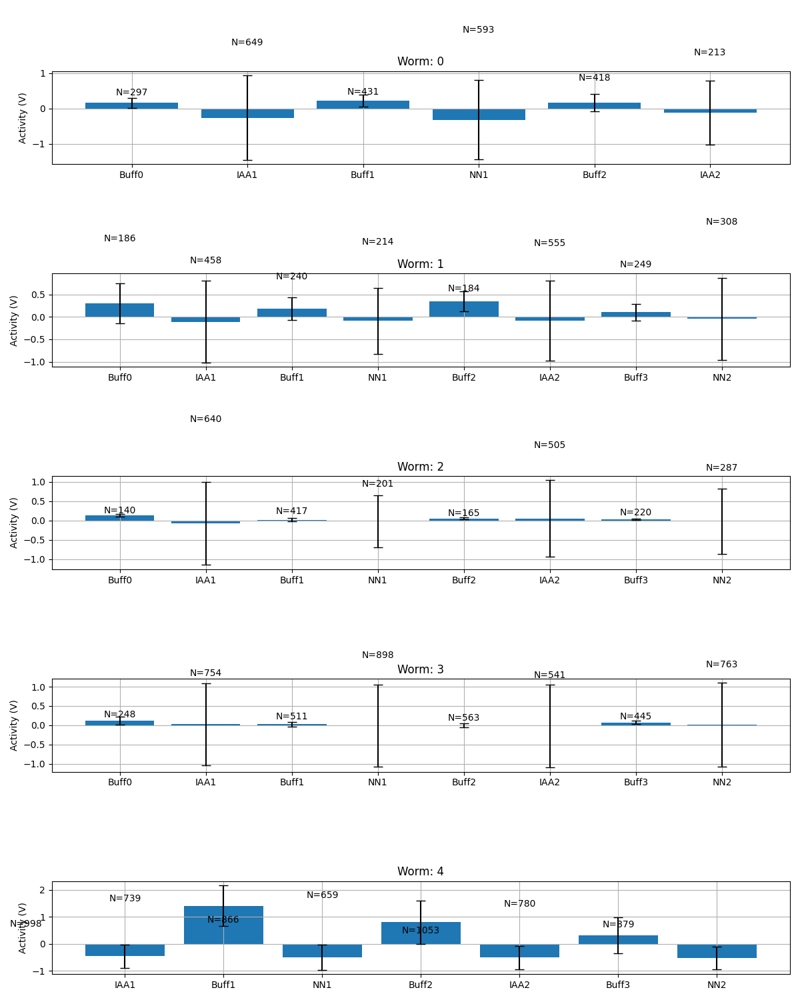

In [172]:
#bar plots at each series
series_label = ['Buff0', 'IAA1','Buff1', 'NN1','Buff2', 'IAA2','Buff3', 'NN2']
Xpose = [0, 1,2,3,4,5,6,7]
fig, axes = plt.subplots(5, 1, figsize=(12, 15))
IAAonoff = [1.5,-2]#[0.5,-1]

# Loop through each V and create violin plots in subplots
MegaData2sm = copy.deepcopy(MegaData)
for d in range(5):    
    for n in [7,8,27,28,39,40]:    
        MegaData2sm[d,:,n] = smooth_vec_long(MegaData2sm[d,:,n],sig,gap[d])#add smoothing if needed
        nonz = np.nonzero(MegaData2sm[d,:,n])
        MegaData2sm[d,nonz,n]= compute_vector_z_score(MegaData2sm[d,nonz,n])
    MeanNeurite = get_neurite_nanmean(MegaData2sm[d,:,:])    
    if d<4:
        start = closest_index(MegaData0[d,:,12],2)
        end = closest_index(MegaData0[d,:,12],IAA_int[d,0])
        rowsArr_floatBuff0= MegaData2sm[d,start:end,:]
        MeanBuff0 = MeanNeurite[start:end]
    start = closest_index(MegaData0[d,:,12],IAA_int[d,0])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,1])
    rowsArr_floatIAA1 = MegaData2sm[d,start:end,:]
    MeanIAA1 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],IAA_int[d,1])
    end = closest_index(MegaData0[d,:,12],NN_int[d,0])
    rowsArr_floatBuff1 = MegaData2sm[d,start:end,:]
    MeanBuff1 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],NN_int[d,0])
    end = closest_index(MegaData0[d,:,12],NN_int[d,1])
    rowsArr_floatNN1 = MegaData2sm[d,start:end,:]
    MeanNN1 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],NN_int[d,1])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,2])
    rowsArr_floatBuff2 = MegaData2sm[d,start:end,:]
    MeanBuff2 = MeanNeurite[start:end]
    
    start = closest_index(MegaData0[d,:,12],IAA_int[d,2])
    end = closest_index(MegaData0[d,:,12],IAA_int[d,3])
    rowsArr_floatIAA2 = MegaData2sm[d,start:end,:]
    MeanIAA2 = MeanNeurite[start:end]
    if d>0:
        start = closest_index(MegaData0[d,:,12],IAA_int[d,3])
        end = closest_index(MegaData0[d,:,12],NN_int[d,2])
        rowsArr_floatBuff3 = MegaData2sm[d,start:end,:]
        MeanBuff3 = MeanNeurite[start:end]
        start = closest_index(MegaData0[d,:,12],NN_int[d,2])
        end = closest_index(MegaData0[d,:,12],NN_int[d,3])
        rowsArr_floatNN2 = MegaData2sm[d,start:end,:]
        MeanNN2 = MeanNeurite[start:end]
    
    # Separate V based on odor presence (O)
    '''
    odAddLabel = IAAonoff[0]
    odRemoveLabel = IAAonoff[1]
    O = OdorLabels[d,start:end]#MegaData0[d,start:end,10]
    V_odor = rowsArr_float[O == odAddLabel,:]      # Values when odor is present
    V_no_odor = rowsArr_float[O == odRemoveLabel,:]   # Values when odor is absent
    
    neuriteActivity = rowsArr_float[:,[7,8,27,28,39,40]]
    neuriteActivity[neuriteActivity==0] = np.nan
    n_acti = np.nanmean(neuriteActivity,axis=1)
    n_acti[np.isnan(n_acti)]=0 
    Mean_odor = n_acti[O == odAddLabel]      # Values when odor is present
    Mean_no_odor = n_acti[O == odRemoveLabel]
    '''
    
    # Prepare data for violin plots
    if d>0 and d<4:
        data = [MeanBuff0[np.nonzero(MeanBuff0)[0]],MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                MeanBuff3[np.nonzero(MeanBuff3)[0]],MeanNN2[np.nonzero(MeanNN2)[0]]]
        series_label2 =series_label
        Xpose2 = Xpose
    elif d==0: 
        data = [MeanBuff0[np.nonzero(MeanBuff0)[0]],MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                ]
        series_label2 =series_label[:-2]
        Xpose2 = Xpose[:-2]
    elif d==4:
        data = [MeanIAA1[np.nonzero(MeanIAA1)[0]],MeanBuff1[np.nonzero(MeanBuff1)[0]],
                MeanNN1[np.nonzero(MeanNN1)[0]],MeanBuff2[np.nonzero(MeanBuff2)[0]],MeanIAA2[np.nonzero(MeanIAA2)[0]],
                MeanBuff3[np.nonzero(MeanBuff3)[0]],MeanNN2[np.nonzero(MeanNN2)[0]]]
        series_label2 =series_label[1:]
        Xpose2 = Xpose[1:]
    # Get the subplot axis
    ax = axes[d]
    
    means = [np.nanmean(d) for d in data]  # Calculate the mean for each set
    stds = [np.nanstd(d) for d in data]    # Calculate the standard deviation for each set
    ax = axes[d]
    
    # Plot the bar plot on the specific axis
    ax.bar(Xpose2, means, yerr=stds, capsize=5)
    ax.set_xticks(Xpose2)
    for i, dset in enumerate(data):
        num_points = len(dset)
        ax.text(i, max(dset) * 0.5, f'N={num_points}', ha='center', va='bottom', fontsize=10, color='black')
    
    # Set labels and title for the subplot
    ax.set_xticks(Xpose2)
    ax.set_xticklabels(series_label2)
    ax.set_title("Worm: "+ str(d))
    ax.set_ylabel('Activity (V)')
    #ax.set_ylim(bottom=-1 ,top=1) 
    ax.grid(True)
plt.tight_layout()
plt.show()

In [212]:
#compute cross correlation of head direction with neurite activity in different intervals
velchoice=38
corrNheadExTime = np.zeros((6,12,5))#2 is for odor and after odor

Tint=10#how much to shift the activity
sig=2
rolltot = 0#determine to whether go for custom roll or a fixed one
gap=[7,7,7,10,13]#[10,10,10,14,20]#
if rolltot==0:
    roll=0
roll0 = [0,14,5,6,0]   
Neu_num = [7,8,27,28,39,40]
for n0 in range(len(Neu_num)):
    n2 = Neu_num[n0]
    for d in range(5):
        start = closest_index(MegaData0[d,:,12],IAA_int[d,0] )
        end = closest_index(MegaData0[d,:,12],IAA_int[d,1])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        if rolltot!=0:   
            roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        # Find indices where both A and B are nonzero
        indices1 = np.nonzero(MegaData0[d,start:end,10]==1)[0]
        indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
        A1=np.array(A[indices1])
        A0=np.array(A[indices0])
        B1=np.array(B[indices1])
        B0=np.array(B[indices0])
        nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
        if (len(nonzero_indices1[0])>12):
            X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
            Y1 = A1[nonzero_indices1[0]]
            corr1=np.corrcoef(X1,Y1)
            corrNheadExTime[n0,1,d] = (corr1[0,1])
        
        nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
        X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
        Y0 = A0[nonzero_indices0[0]]
        corr0=np.corrcoef(X0,Y0)
        corrNheadExTime[n0,2,d] = (corr0[0,1])


        start = closest_index(MegaData0[d,:,12],IAA_int[d,2] )
        end = closest_index(MegaData0[d,:,12],IAA_int[d,3])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        if rolltot!=0:    
            roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        indices1 = np.nonzero(MegaData0[d,start:end,10]==1)[0]
        indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
        A1=np.array(A[indices1])
        A0=np.array(A[indices0])
        B1=np.array(B[indices1])
        B0=np.array(B[indices0])
        nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
        if (len(nonzero_indices1[0])>12):
            X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
            Y1 = A1[nonzero_indices1[0]]
            corr1=np.corrcoef(X1,Y1)
            corrNheadExTime[n0,7,d] = (corr1[0,1])
        
        nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
        X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
        Y0 = A0[nonzero_indices0[0]]
        corr0=np.corrcoef(X0,Y0)
        corrNheadExTime[n0,8,d] = (corr0[0,1])

        ### 2-Nonanone section 
        start = closest_index(MegaData0[d,:,12],NN_int[d,0] )
        end = closest_index(MegaData0[d,:,12],NN_int[d,1])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])        
        if rolltot!=0:   
            roll = roll0[d]
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        indices1 = np.nonzero(MegaData0[d,start:end,10]==2)[0]
        indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
        A1=np.array(A[indices1])
        A0=np.array(A[indices0])
        B1=np.array(B[indices1])
        B0=np.array(B[indices0])
        nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
        if (len(nonzero_indices1[0])>12):
            X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
            Y1 = A1[nonzero_indices1[0]]
            corr1=np.corrcoef(X1,Y1)
            corrNheadExTime[n0,4,d] = (corr1[0,1])
        
        nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
        X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
        Y0 = A0[nonzero_indices0[0]]
        corr0=np.corrcoef(X0,Y0)
        corrNheadExTime[n0,5,d] = (corr0[0,1])
        ####NN2
        start = closest_index(MegaData0[d,:,12],NN_int[d,2] )
        end = closest_index(MegaData0[d,:,12],NN_int[d,3])
        if d>0:
            rowsArr_float = MegaData[d,start:end,:]
            A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
            if rolltot==0:
                roll=0
            else:    
                roll = roll0[d]
            if roll!=0:
                B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
            else:    
                B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
            indices1 = np.nonzero(MegaData0[d,start:end,10]==2)[0]
            indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
            A1=np.array(A[indices1])
            A0=np.array(A[indices0])
            B1=np.array(B[indices1])
            B0=np.array(B[indices0])
            nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
            if (len(nonzero_indices1[0])>12):
                X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
                Y1 = A1[nonzero_indices1[0]]
                corr1=np.corrcoef(X1,Y1)
                corrNheadExTime[n0,10,d] = (corr1[0,1])
            
            nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
            X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
            Y0 = A0[nonzero_indices0[0]]
            corr0=np.corrcoef(X0,Y0)
            corrNheadExTime[n0,11,d] = (corr0[0,1])

        ### buffer sections
        start = closest_index(MegaData0[d,:,12],IAA_int[d,1] )
        end = closest_index(MegaData0[d,:,12],NN_int[d,0])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        if rolltot==0:
            roll=0
        else:    
            roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])  
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        # Find indices where both A and B are nonzero
        nonzero_indices = np.nonzero((A != 0) & (B != 0))
        if (len(nonzero_indices[0])>12):
            X = compute_vector_z_score(B[nonzero_indices[0]])
            Y = A[nonzero_indices[0]]
    
            corr=np.corrcoef(X,Y)
            corrNheadExTime[n0,3,d] = (corr[0,1])
        

        start = closest_index(MegaData0[d,:,12],NN_int[d,1] )
        end = closest_index(MegaData0[d,:,12],IAA_int[d,2])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        if rolltot==0:
            roll=0
        else:    
            roll = roll0[d] 
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        # Find indices where both A and B are nonzero
        nonzero_indices = np.nonzero((A != 0) & (B != 0))
        if (len(nonzero_indices[0])>12):
            X = compute_vector_z_score(B[nonzero_indices[0]])
            Y = A[nonzero_indices[0]]
            corr=np.corrcoef(X,Y)
            corrNheadExTime[n0,6,d] = (corr[0,1])
        
        
        start = closest_index(MegaData0[d,:,12],IAA_int[d,3] )
        end = closest_index(MegaData0[d,:,12],NN_int[d,2])
        if d>0:
            rowsArr_float = MegaData[d,start:end,:]
            A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
            if rolltot==0:
                roll=0
            else:    
                roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])   
            if roll!=0:
                B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
            else:    
                B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero((A != 0) & (B != 0))
            if (len(nonzero_indices[0])>12):
                X = compute_vector_z_score(B[nonzero_indices[0]])
                Y = A[nonzero_indices[0]]
                corr=np.corrcoef(X,Y)
                corrNheadExTime[n0,9,d] = (corr[0,1])
            
            
        start = closest_index(MegaData0[d,:,12],1 )
        end = closest_index(MegaData0[d,:,12],IAA_int[d,0])   
        if d<4:
            rowsArr_float = MegaData[d,start:end,:]
            A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
            if rolltot==0:
                roll=0
            else:    
                roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])     
            if roll!=0:
                B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
            else:    
                B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero((A != 0) & (B != 0))
            if (len(nonzero_indices[0])>12):
                X = compute_vector_z_score(B[nonzero_indices[0]])
                Y = A[nonzero_indices[0]]
                corr=np.corrcoef(X,Y)
                corrNheadExTime[n0,0,d] = (corr[0,1])
             


/tmp/ipykernel_218624/799734524.py:505: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


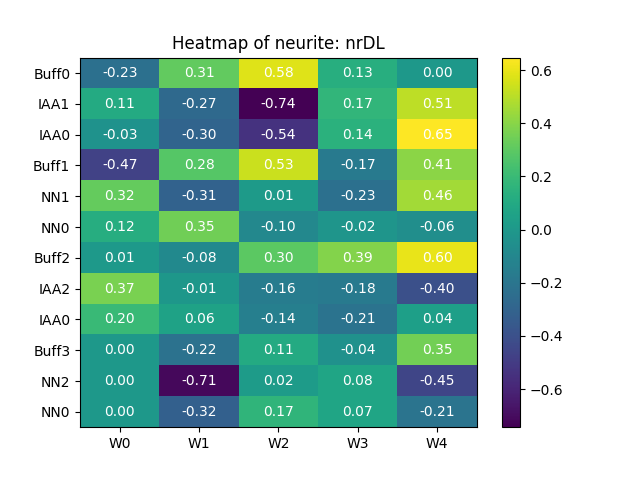

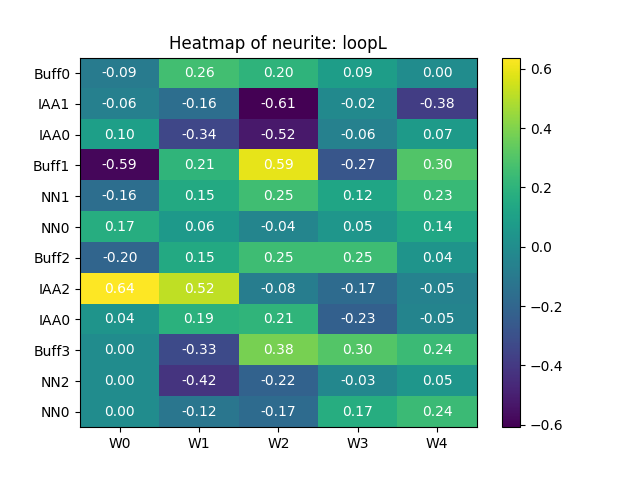

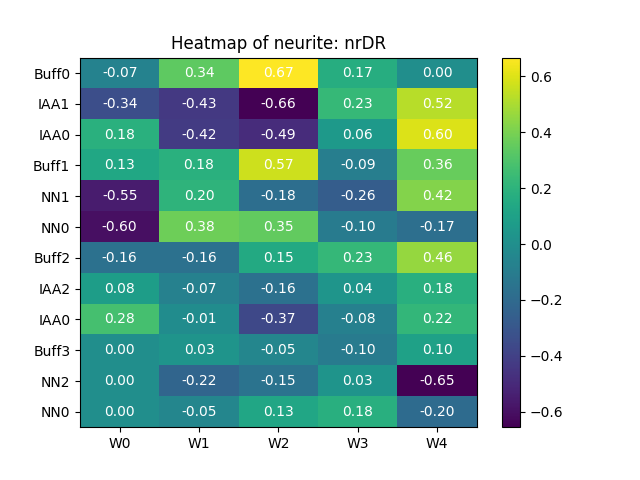

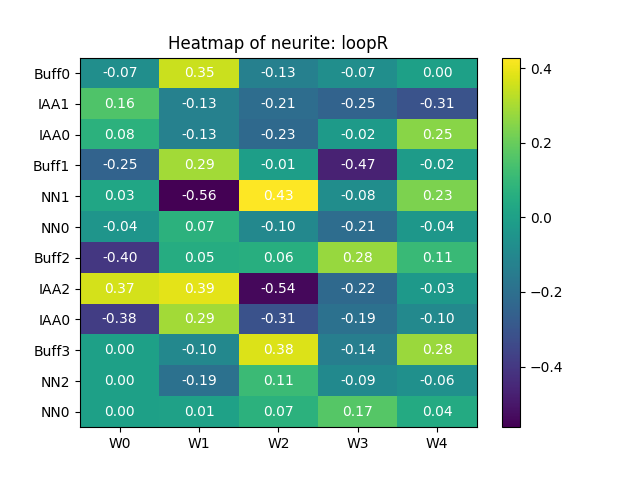

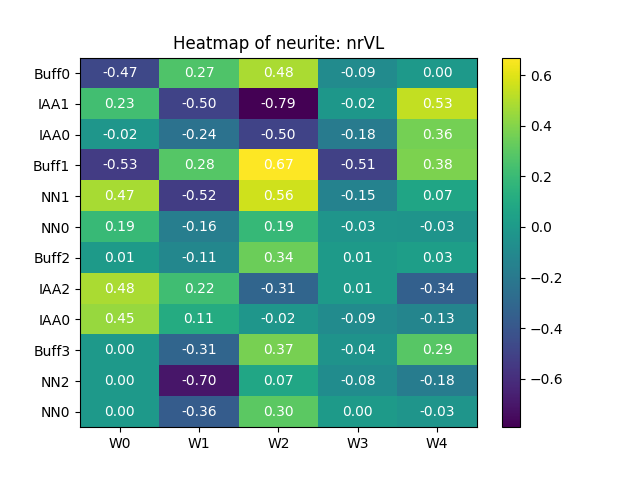

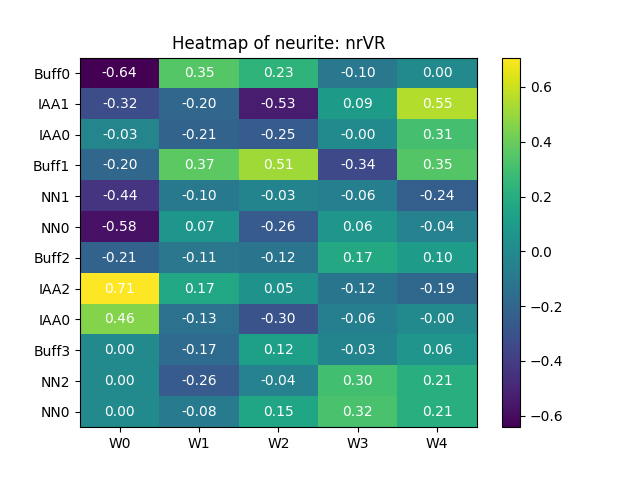

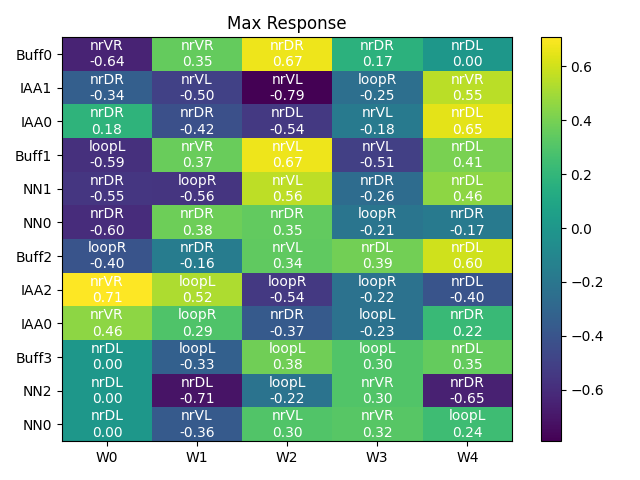

In [213]:
y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN1','NN0', 'Buff2', 'IAA2','IAA0', 'Buff3','NN2','NN0']
x_labels2 = ['W0','W1','W2','W3','W4']#x_labels[7:]
x_labels = ['RIAL', 'RIAR', 'RIML', 'RIMR', 'RIBL', 'RIBR', 'sensory', 
            'nrDL', 'loopL', 'nrDR', 'loopR', 'nrVL', 'nrVR']
n_label = x_labels[7:]
for n in range(len(Neu_num)):
    fig, ax = plt.subplots()
    Mat = corrNheadExTime[n,:,:]
    cax = ax.imshow(Mat, cmap='viridis', aspect='auto')
    cbar = fig.colorbar(cax)
    # Annotate the values on the heatmap
    for i in range(Mat.shape[0]):
        for j in range(Mat.shape[1]):
            ax.text(j, i, f'{Mat[i, j]:.2f}', ha='center', va='center', color='white')
    
    # Set labels and title (optional)
    ax.set_title('Heatmap of neurite: '+n_label[n])
    
    
    ax.set_yticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
    ax.set_yticklabels(y_labels2)
    ax.set_xticks(np.arange(len(x_labels2)))  # Set the y-ticks to the number of rows
    ax.set_xticklabels(x_labels2)
    plt.show()

###plot neurites with maximum response
#corrNheadExTime[corrNheadExTime==0]=np.nan
max_indices = np.argmax(np.abs(corrNheadExTime), axis=0)
max_neur_response = np.zeros((12, 5))

# Extract the actual values (not absolute) from the original matrix using the indices
for i in range(12):
    for j in range(5):
        max_neur_response[i, j] = corrNheadExTime[max_indices[i, j], i, j]
fig, ax = plt.subplots()
Mat = max_neur_response
Maxind = max_indices
cax = ax.imshow(Mat, cmap='viridis', aspect='auto')
fig.colorbar(cax)
for i in range(Mat.shape[0]): 
    for j in range(Mat.shape[1]):  
        ax.text(j, i, f'{n_label[Maxind[i, j]]}\n{Mat[i, j]:.2f}', ha='center', va='center', color='white')
ax.set_title('Max Response')
ax.set_yticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
ax.set_yticklabels(y_labels2)
ax.set_xticks(np.arange(len(x_labels2)))  # Set the y-ticks to the number of rows
ax.set_xticklabels(x_labels2)
plt.tight_layout()
plt.show()

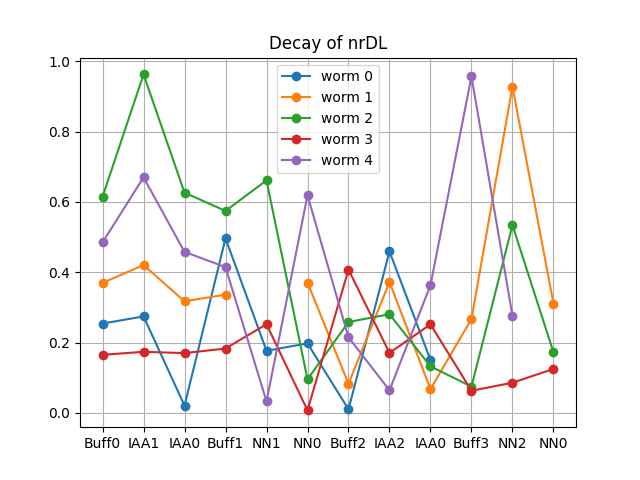

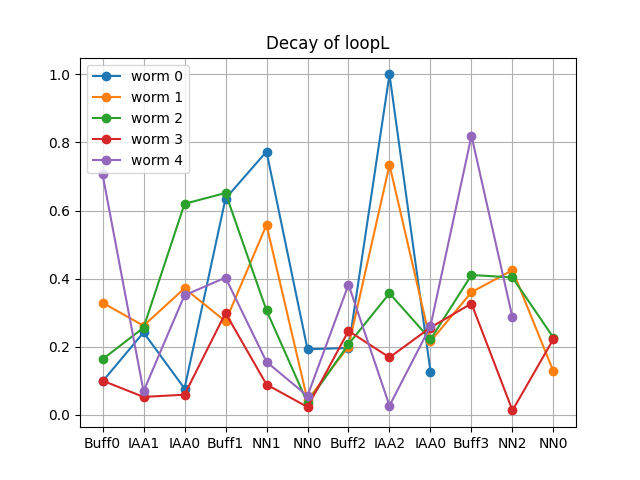

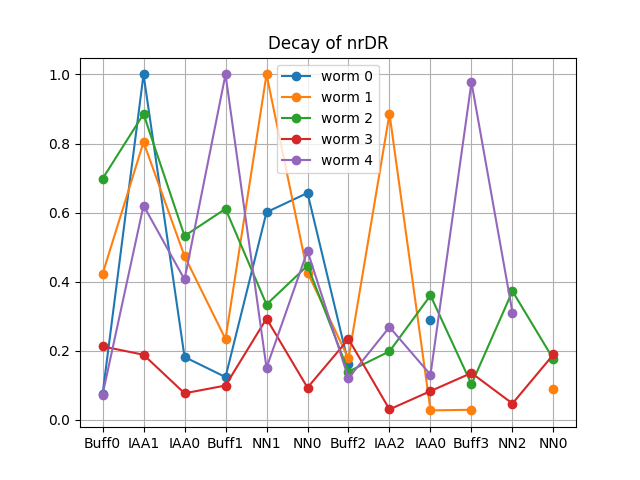

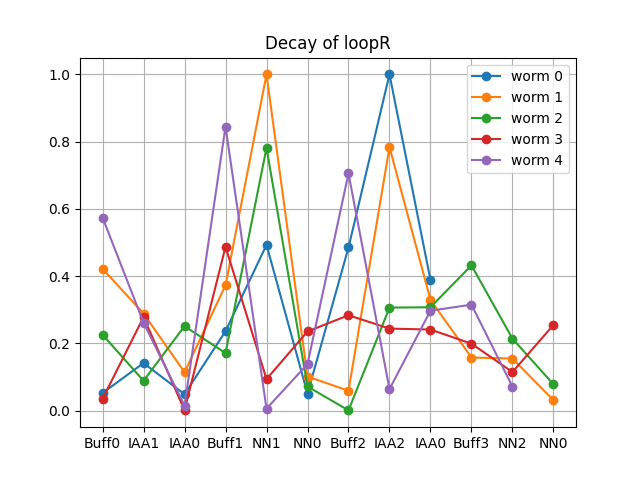

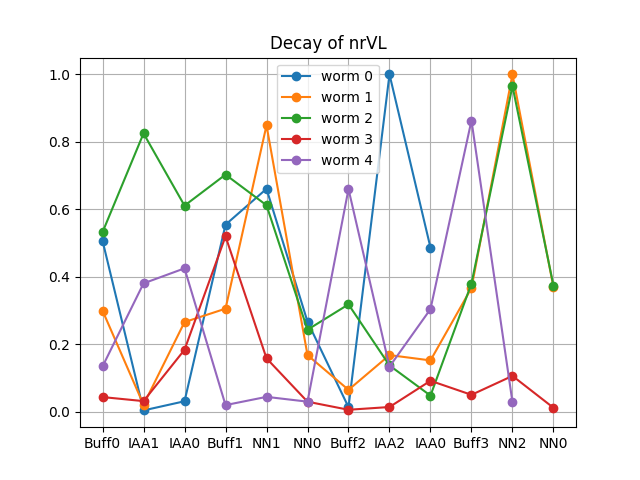

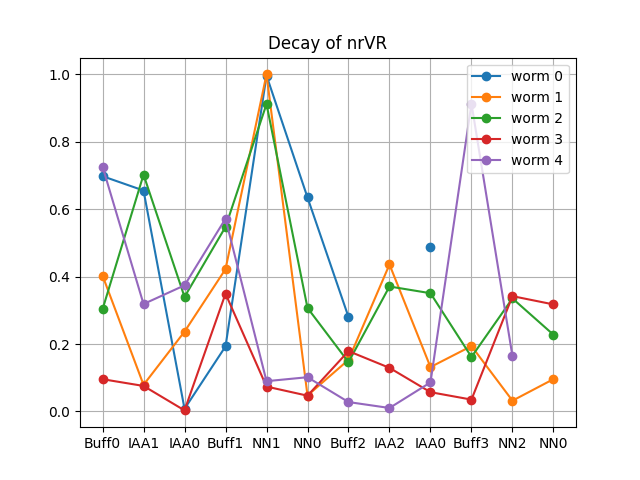

In [55]:
#plot neurite response decay
y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN1','NN0', 'Buff2', 'IAA2','IAA0', 'Buff3','NN2','NN0']
x_labels2 = ['W0','W1','W2','W3','W4']#x_labels[7:]
n_label = x_labels[7:]
for n in range(len(Neu_num)):
    fig, ax = plt.subplots()
    Mat = np.abs(corrNheadExTime[n,:,:])
    for d in range(5):
        nonzero = np.nonzero(Mat[:,d])
        ax.plot(Mat[nonzero[0],d], marker='o', label=f'worm {d}')
    # Set labels and title (optional)
    ax.set_title("Decay of "+ n_label[n])
    ax.set_xticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
    ax.set_xticklabels(y_labels2)
    plt.legend()
    plt.grid(True)
    plt.show()

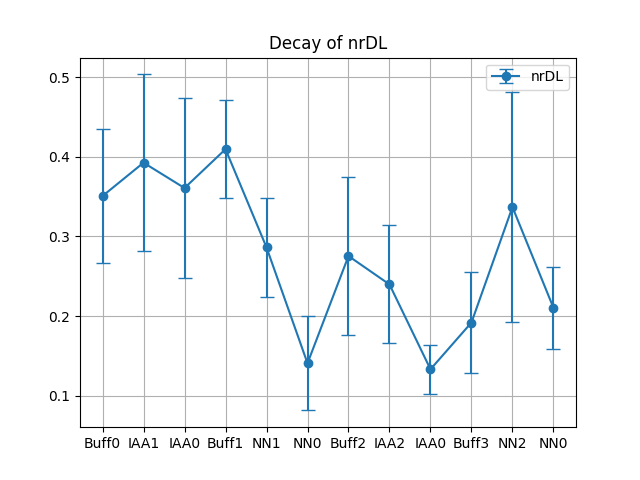

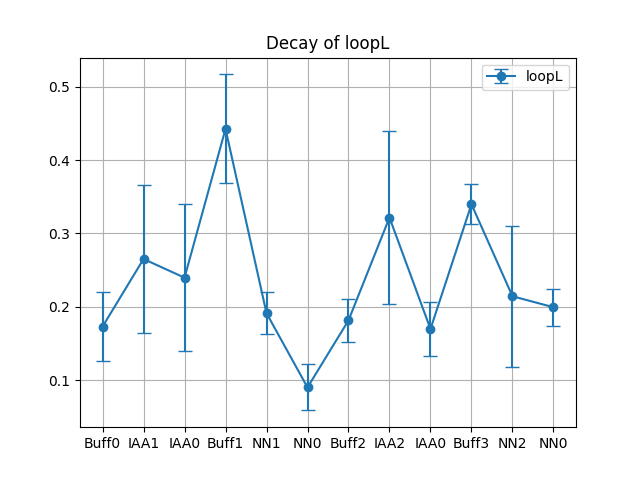

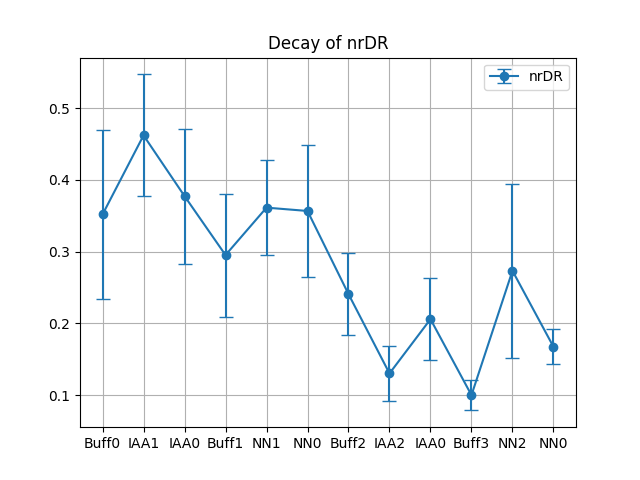

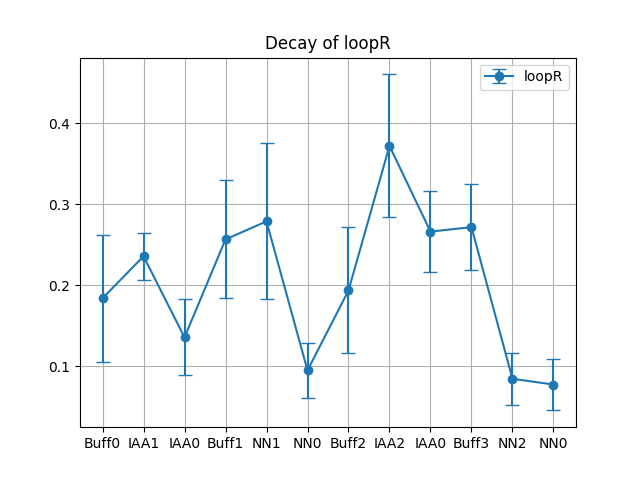

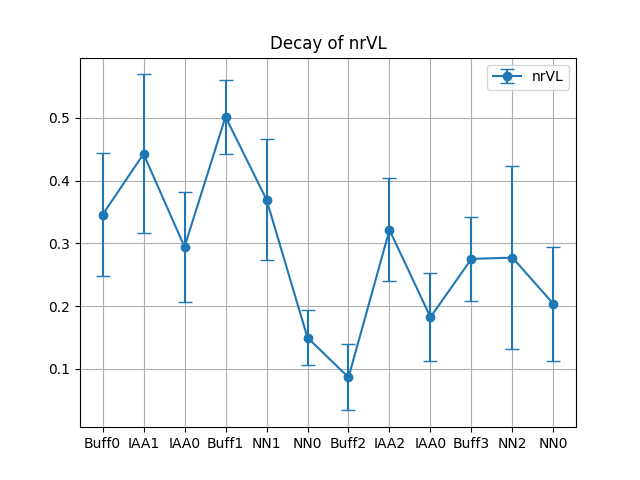

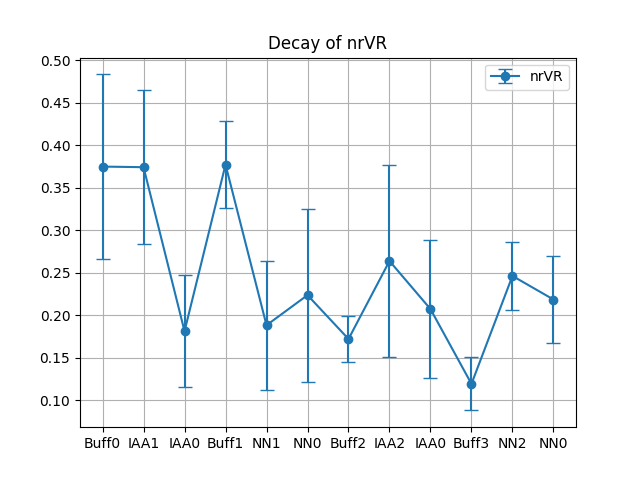

In [193]:
#plot neurite response decay
y_labels2 =['Buff0', 'IAA1','IAA0', 'Buff1', 'NN1','NN0', 'Buff2', 'IAA2','IAA0', 'Buff3','NN2','NN0']
x_labels2 = ['W0','W1','W2','W3','W4']#x_labels[7:]
n_label = x_labels[7:]
for n in range(len(Neu_num)):
    fig, ax = plt.subplots()
    Mat = np.abs(corrNheadExTime[n,:,:])
    Mat[Mat==0] =  np.nan    
    means = np.nanmean(Mat, axis=1)
    stds = np.nanstd(Mat, axis=1)/np.sqrt(np.sum(~np.isnan(Mat), axis=1))
    ax.errorbar(np.arange(len(means)),means, yerr=stds, capsize=5, fmt='-o', label=n_label[n])
    # Set labels and title (optional)
    ax.set_title("Decay of "+ n_label[n])
    ax.set_xticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
    ax.set_xticklabels(y_labels2)
    plt.legend()
    plt.grid(True)
    plt.show()

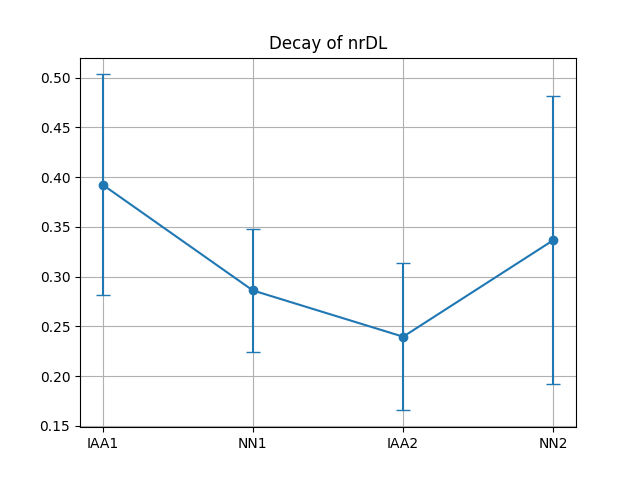

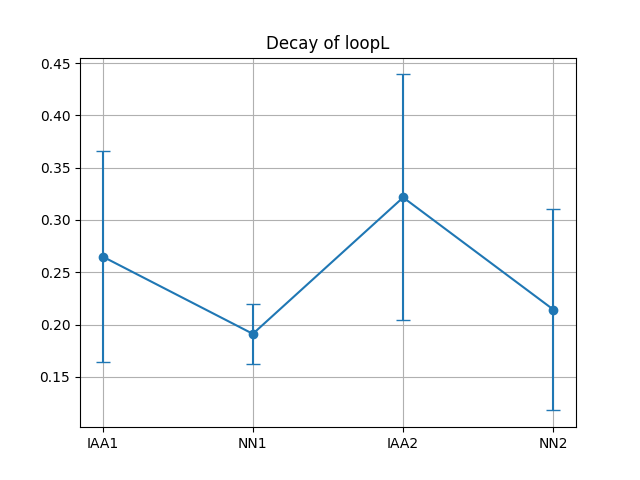

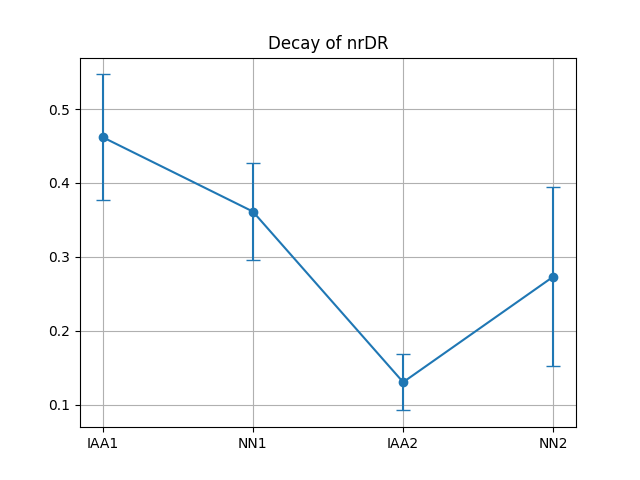

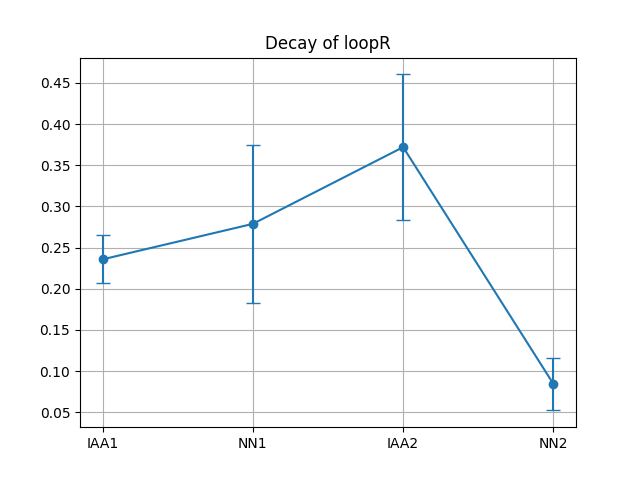

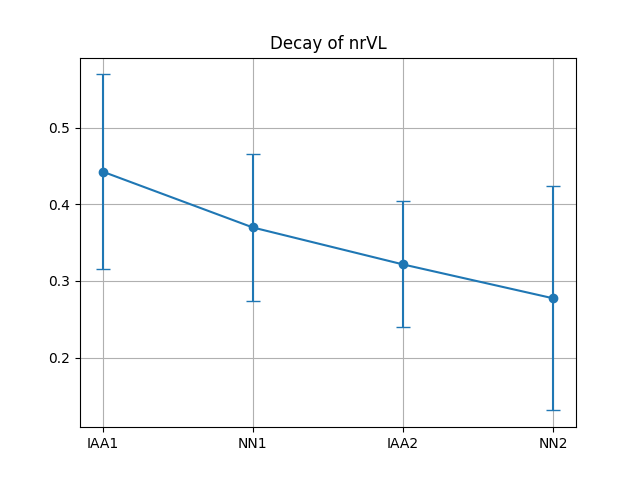

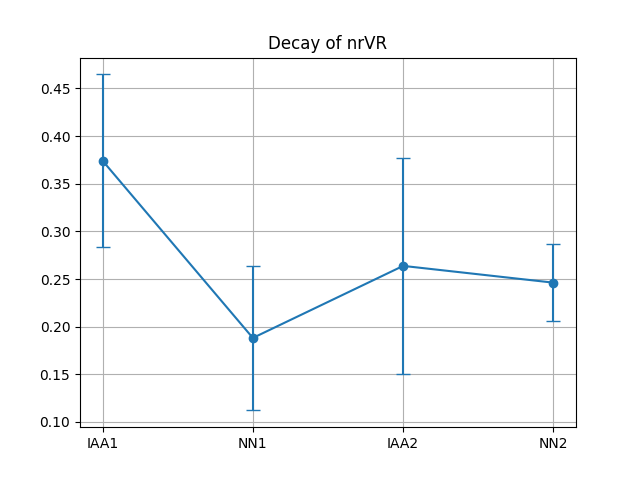

In [194]:
#plot neurite response decay during odors
y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN1','NN0', 'Buff2', 'IAA2','IAA0', 'Buff3','NN2','NN0']
x_labels2 = ['W0','W1','W2','W3','W4']#x_labels[7:]
n_label = x_labels[7:]
for n in range(len(Neu_num)):
    fig, ax = plt.subplots()
    Mat = np.abs(corrNheadExTime[n,:,:])
    Mat[Mat==0] =  np.nan    
    means = np.nanmean(Mat, axis=1)
    stds = np.nanstd(Mat, axis=1)/np.sqrt(np.sum(~np.isnan(Mat), axis=1))
    Xax = np.arange(len(means))
    ax.errorbar(Xax[1::3],means[1::3], yerr=stds[1::3], capsize=5, fmt='-o', label=n_label[n])
    # Set labels and title (optional)
    ax.set_title("Decay of "+ n_label[n])
    ax.set_xticks(3*np.arange(len(y_labels2[1::3]))+1)  # Set the y-ticks to the number of rows
    ax.set_xticklabels(y_labels2[1::3])
    #plt.legend()
    plt.grid(True)
    plt.show()

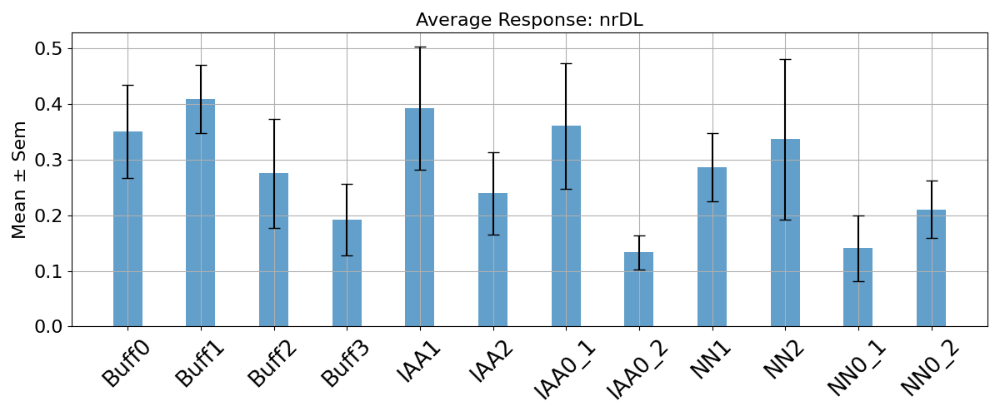

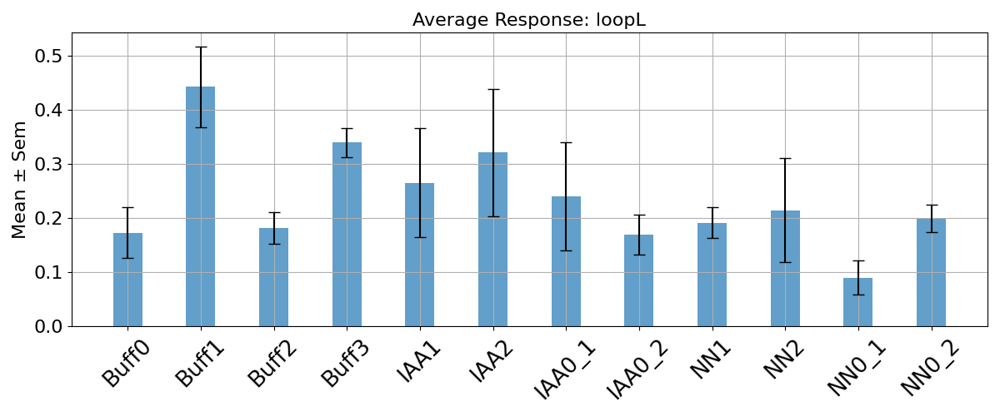

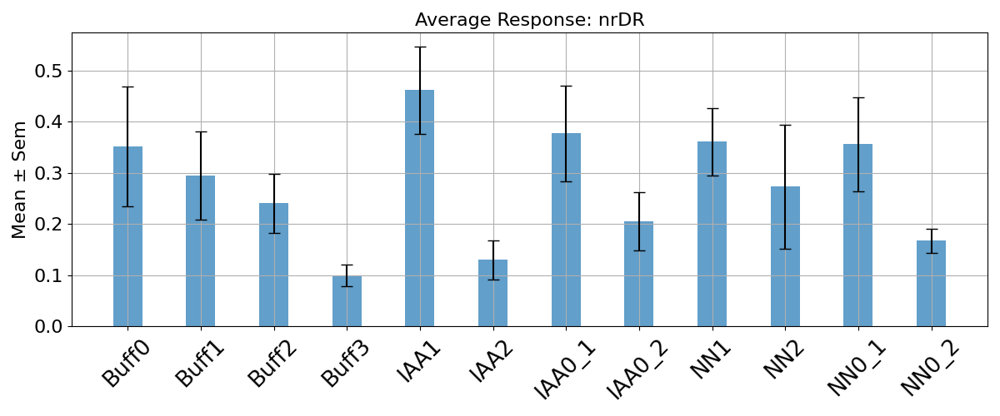

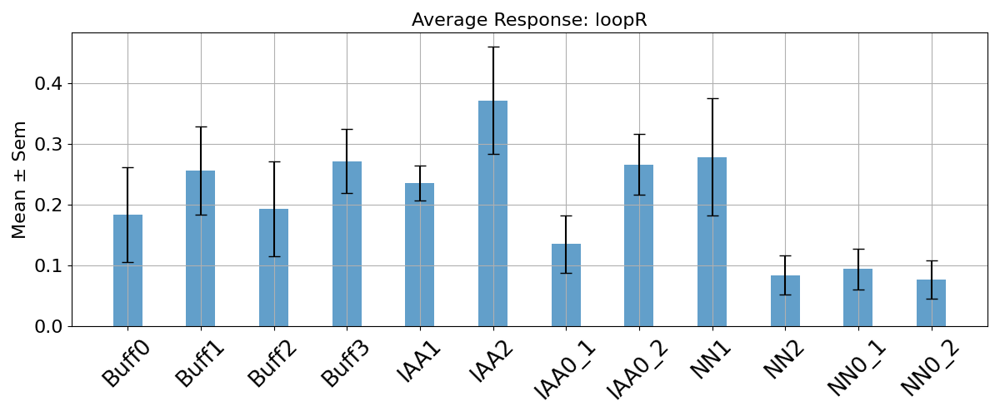

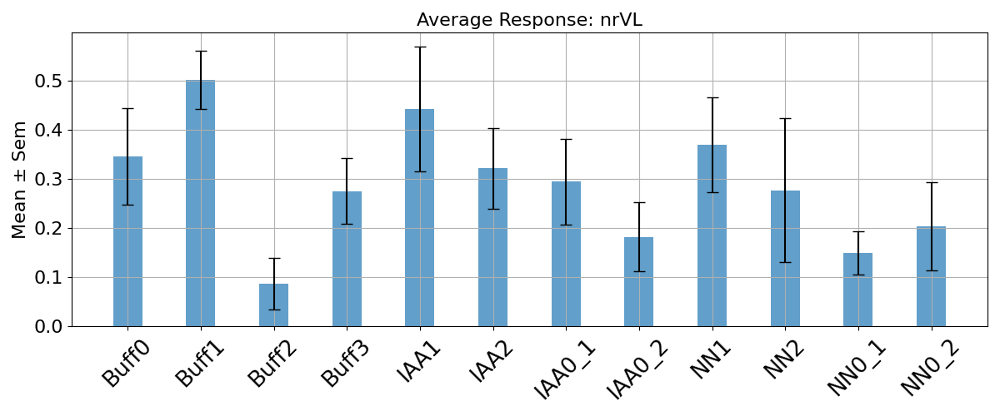

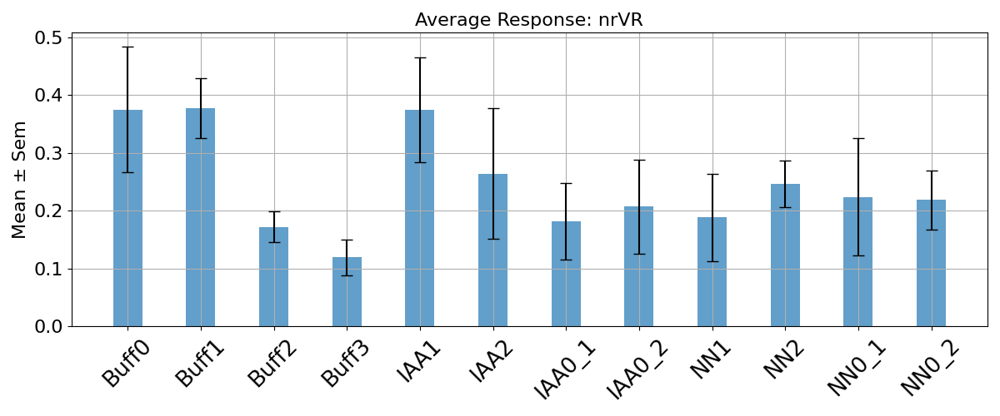

In [195]:
#each neurite averaged across worms
fs=16
matrix = np.abs(corrNheadExTime[:,:,:])

#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN1','NN0', 'Buff2', 'IAA2','IAA0', 'Buff3','NN2','NN0']
y_labels2swap = [ 'Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
for n in range(6):
    current_matrix0 = matrix[n, :, :]
    current_matrix = current_matrix0[[0,3,6,9,1,7,2,8,4,10,5,11],:]
    means = np.nanmean(current_matrix, axis=1)
    stds = np.nanstd(current_matrix, axis=1)/np.sqrt(np.sum(~np.isnan(current_matrix), axis=1))
    plt.figure(figsize=(12, 5))
    plt.bar(np.arange(current_matrix.shape[0]), means, yerr=stds, capsize=5, alpha=0.7, width=0.4)
    plt.title("Average Response: "+n_label[n],fontsize=fs)
    plt.ylabel('Mean ± Sem',fontsize=fs)
    plt.xticks(np.arange(len(y_labels2)), labels=y_labels2swap,fontsize=fs+3,rotation=45) 
    plt.tick_params(axis='y', labelsize=fs)
    plt.tight_layout()
    plt.grid(True)
    plt.show()

/tmp/ipykernel_218624/2087367944.py:12: RuntimeWarning: Mean of empty slice
  means = np.nanmean(current_matrix, axis=0)


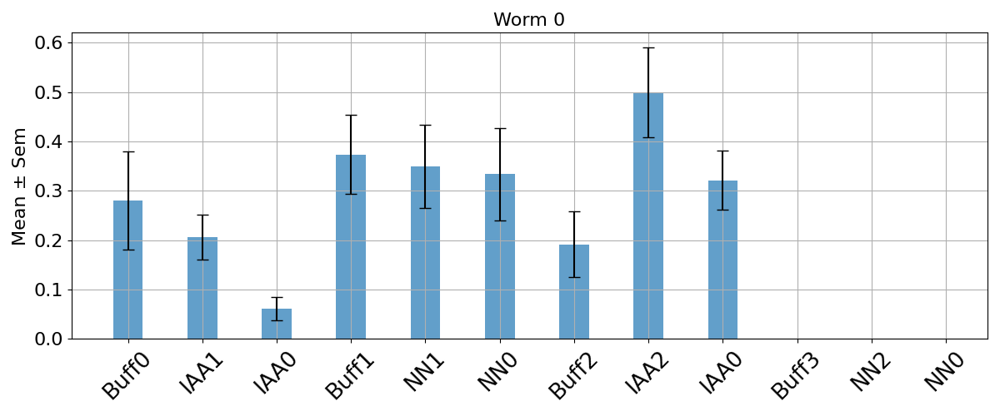

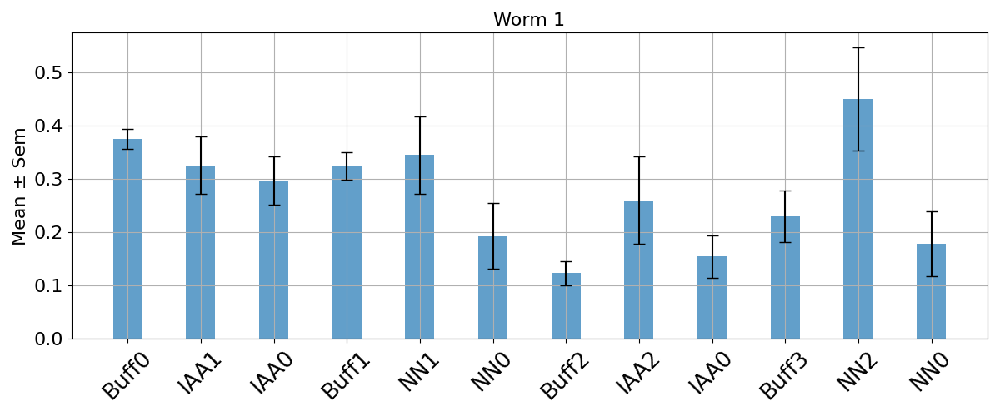

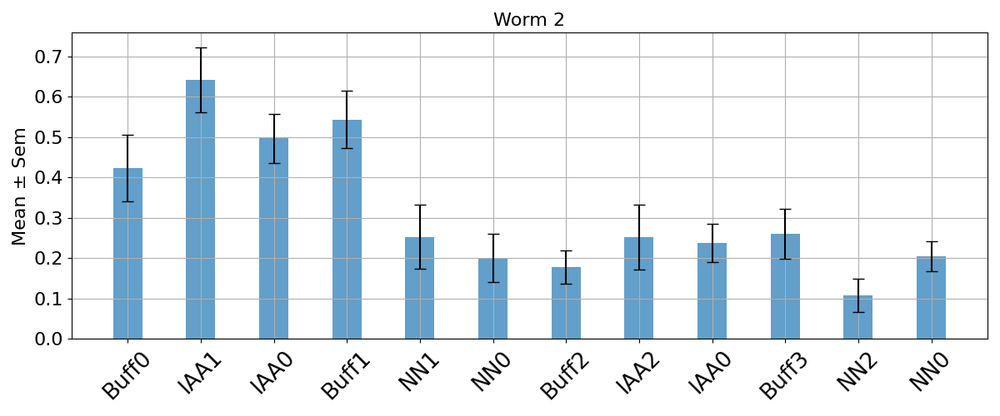

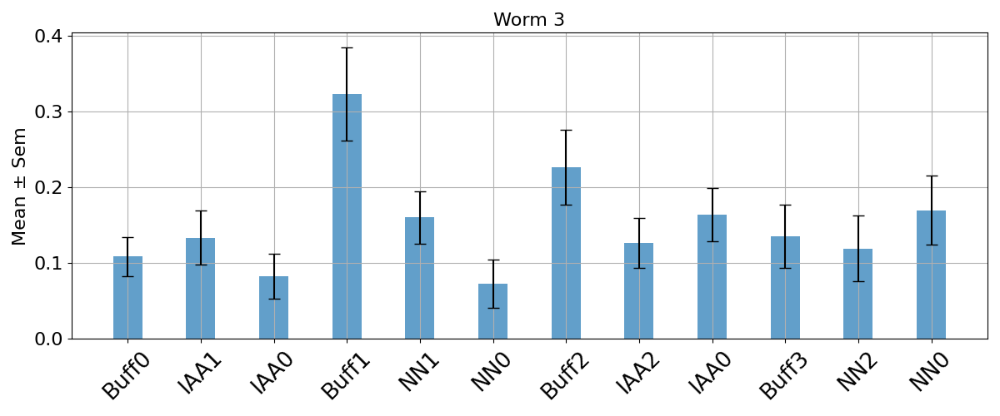

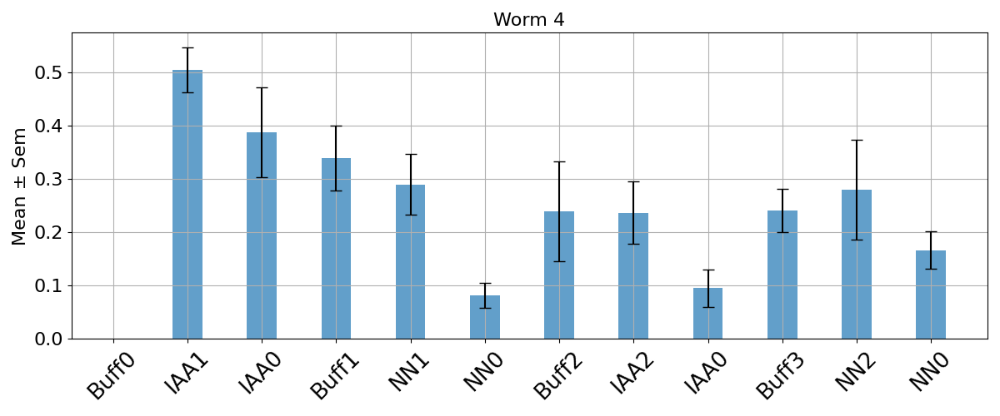

In [197]:
#each worm all neurites
fs=16
matrix = np.abs(corrNheadExTime[:,:,:])

#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2swap = ['Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
for d in range(5):
    current_matrix0 = matrix[:, :, d]
    #current_matrix = current_matrix0[:,[0,3,6,9,1,7,2,8,4,10,5,11]]
    current_matrix = current_matrix0[:,:]
    means = np.nanmean(current_matrix, axis=0)
    stds = np.nanstd(current_matrix, axis=0)/np.sqrt(np.sum(~np.isnan(current_matrix), axis=0))
    plt.figure(figsize=(12, 5))
    plt.bar(np.arange(current_matrix.shape[1]), means, yerr=stds, capsize=5, alpha=0.7, width=0.4)
    plt.title("Worm "+str(d),fontsize=fs)
    plt.ylabel('Mean ± Sem',fontsize=fs)
    plt.xticks(np.arange(len(y_labels2)), labels=y_labels2,fontsize=fs+3,rotation=45) 
    plt.tick_params(axis='y', labelsize=fs)
    plt.tight_layout()
    plt.grid(True)
    plt.show()

(6, 12, 4)


/tmp/ipykernel_218624/3493221419.py:13: RuntimeWarning: Mean of empty slice
  means_perworm = np.nanmean(current_matrix, axis=0)


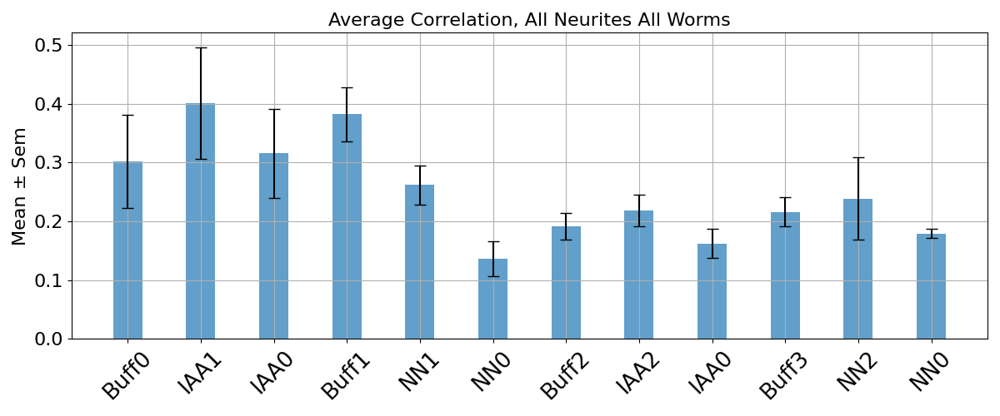

In [204]:
#all neurites all worms
print(np.shape(matrix))
fs=16
matrix = np.abs(corrNheadExTime[:,:,1:])
#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2swap = [ 'Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
current_matrix0 = matrix
#current_matrix = current_matrix0[:,[0,3,6,9,1,7,2,8,4,10,5,11],:]
current_matrix = current_matrix0[:,:,:]
#means = np.nanmean(current_matrix, axis=(0,2))
#stds = np.nanstd(current_matrix, axis=(0,2))/np.sqrt(np.sum(~np.isnan(current_matrix), axis=(0,2)))
means_perworm = np.nanmean(current_matrix, axis=0)
means = np.nanmean(means_perworm, axis=1)
stds = np.nanstd(means_perworm, axis=1)/np.sqrt(np.sum(~np.isnan(means_perworm), axis=1))

plt.figure(figsize=(12, 5))
plt.grid(True)
plt.bar(np.arange(current_matrix.shape[1]), means, yerr=stds, capsize=5, alpha=0.7, width=0.4)
plt.title("Average Correlation, All Neurites All Worms",fontsize=fs)
plt.ylabel('Mean ± Sem',fontsize=fs)
plt.xticks(np.arange(len(y_labels2)), labels=y_labels2,fontsize=fs+3,rotation=45) 
plt.tick_params(axis='y', labelsize=fs)
plt.tight_layout()

plt.show()

(6, 12, 5)


/tmp/ipykernel_218624/472430529.py:11: RuntimeWarning: All-NaN slice encountered
  means = np.nanmax(current_matrix, axis=0)


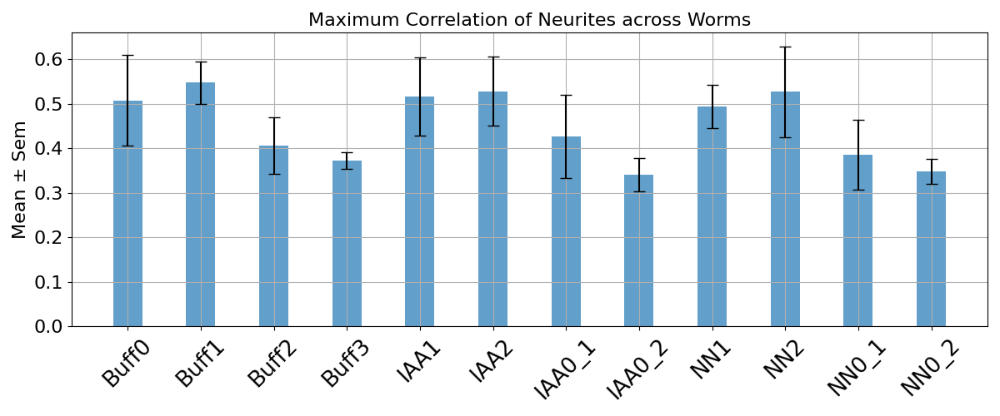

In [202]:
#maximum neurites all worms
print(np.shape(matrix))
fs=16
matrix = np.abs(corrNheadExTime[:,:,:])
#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2swap = [ 'Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
current_matrix0 = matrix
current_matrix = current_matrix0[:,[0,3,6,9,1,7,2,8,4,10,5,11],:]
#current_matrix = current_matrix0[:,:,:]
means = np.nanmax(current_matrix, axis=0)
means0 = np.nanmean(means, axis=1)#average maximums across worms
stds = np.nanstd(means, axis=1)/np.sqrt(np.sum(~np.isnan(means), axis=1))
plt.figure(figsize=(12, 5))
plt.grid(True)
plt.bar(np.arange(means.shape[0]), means0, yerr=stds, capsize=5, alpha=0.7, width=0.4)
plt.title("Maximum Correlation of Neurites across Worms",fontsize=fs)
plt.ylabel('Mean ± Sem',fontsize=fs)
plt.xticks(np.arange(len(y_labels2)), labels=y_labels2swap,fontsize=fs+3,rotation=45) 
plt.tick_params(axis='y', labelsize=fs)
plt.tight_layout()

plt.show()

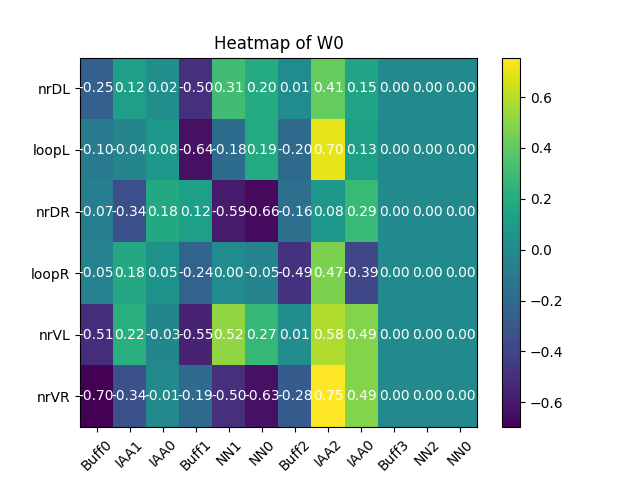

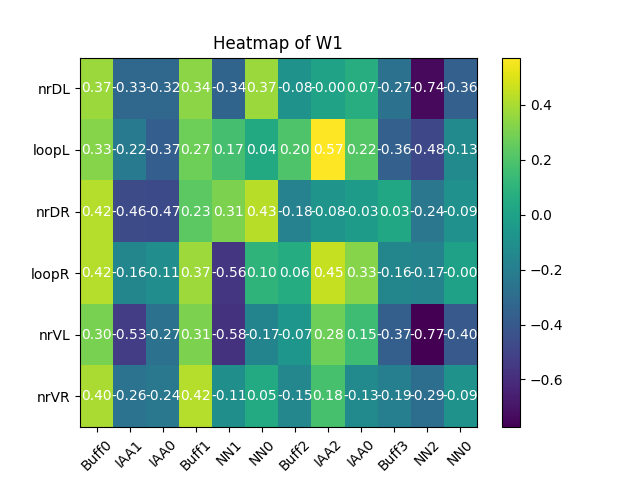

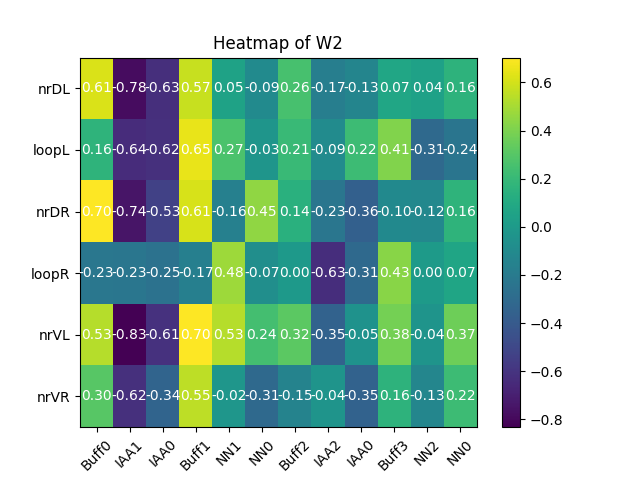

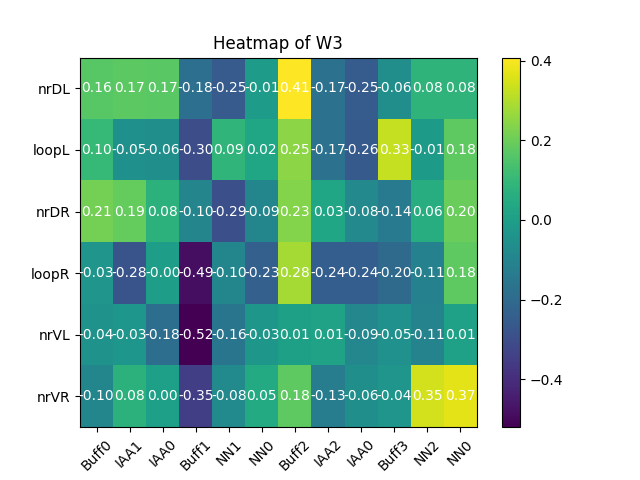

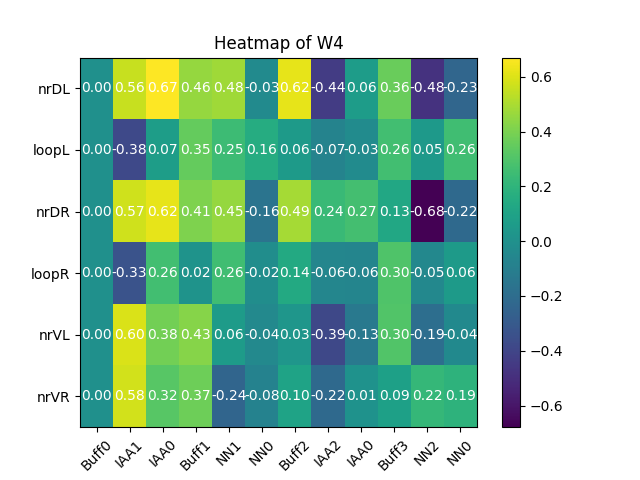

In [205]:
y_labels2 = y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN1','NN0', 'Buff2', 'IAA2','IAA0', 'Buff3','NN2','NN0']
x_labels2 = ['W0','W1','W2','W3','W4']
n_label = x_labels[7:]
for d in range(5):
    fig, ax = plt.subplots()
    Mat = corrNheadExTime[:,:,d]
    cax = ax.imshow(Mat, cmap='viridis', aspect='auto')
    cbar = fig.colorbar(cax)
    # Annotate the values on the heatmap
    for i in range(Mat.shape[0]):
        for j in range(Mat.shape[1]):
            ax.text(j, i, f'{Mat[i, j]:.2f}', ha='center', va='center', color='white')
    
    # Set labels and title (optional)
    ax.set_title('Heatmap of '+x_labels2[d])
    
    
    ax.set_yticks(np.arange(len(n_label)))  # Set the y-ticks to the number of rows
    ax.set_yticklabels(n_label)
    ax.set_xticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
    ax.set_xticklabels(y_labels2,rotation=45)
    plt.show()

In [164]:
y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN11','NN01','NN12','NN02', 'Buff2', 'IAA2','IAA0', 'Buff3','NN21','NN01','NN22','NN02']
y_labels2swap = [ 'Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
NN_intextra = np.zeros((5,6))
NN_intextra[0,:] = [997,1240,1477,2555,2750,3000]#997
NN_intextra[1,:] = [997,1240,1477,2555,2750,3000]
NN_intextra[2,:] = [997,1240,1477,2555,2750,3000]
NN_intextra[3,:] = [997,1240,1477,2555,2750,3000]
NN_intextra[3,:] = [997,1240,1477,2555,2750,3000]
NN_intextra[4,:] = [797,1040,1277,2350,2560,2780]

neurooooooooooooooooooooooooon7
d###############################0
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
75
d###############################1
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
74
NN2
B1:103
B0:176
103
NN3
B1:125
B0:244
d###############################2
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
52
NN2
B1:103
B0:176
103
NN3
B1:125
B0:236
d###############################3
NN0
B1:171
B0:310
171
NN1
B1:134
B0:298
287
NN2
B1:133
B0:238
133
NN3
B1:171
B0:334
d###############################4
NN0
B1:257
B0:465
257
NN1
B1:200
B0:447
246
NN2
B1:228
B0:371
228
NN3
B1:172
B0:598
neurooooooooooooooooooooooooon8
d###############################0
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
66
d###############################1
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
66
NN2
B1:103
B0:176
103
NN3
B1:125
B0:244
d###############################2
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
46


/tmp/ipykernel_218624/799734524.py:505: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


NN2
B1:103
B0:176
103
NN3
B1:125
B0:236
d###############################3
NN0
B1:171
B0:310
171
NN1
B1:134
B0:298
293
NN2
B1:133
B0:238
133
NN3
B1:171
B0:334
d###############################4
NN0
B1:257
B0:465
257
NN1
B1:200
B0:447
223
NN2
B1:228
B0:371
228
NN3
B1:172
B0:598
neurooooooooooooooooooooooooon27
d###############################0
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
179
d###############################1
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
46
NN2
B1:103
B0:176
103
NN3
B1:125
B0:244
d###############################2
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
52
NN2
B1:103
B0:176
103
NN3
B1:125
B0:236
d###############################3
NN0
B1:171
B0:310
171
NN1
B1:134
B0:298
281
NN2
B1:133
B0:238
133
NN3
B1:171
B0:334
d###############################4
NN0
B1:257
B0:465
257
NN1
B1:200
B0:447
188
NN2
B1:228
B0:371
228
NN3
B1:172
B0:598
neurooooooooooooooooooooooooon28
d###############################0
NN0
B1:133
B0:229
133
NN1
B1:97
B0:227
222
d###############################1
NN

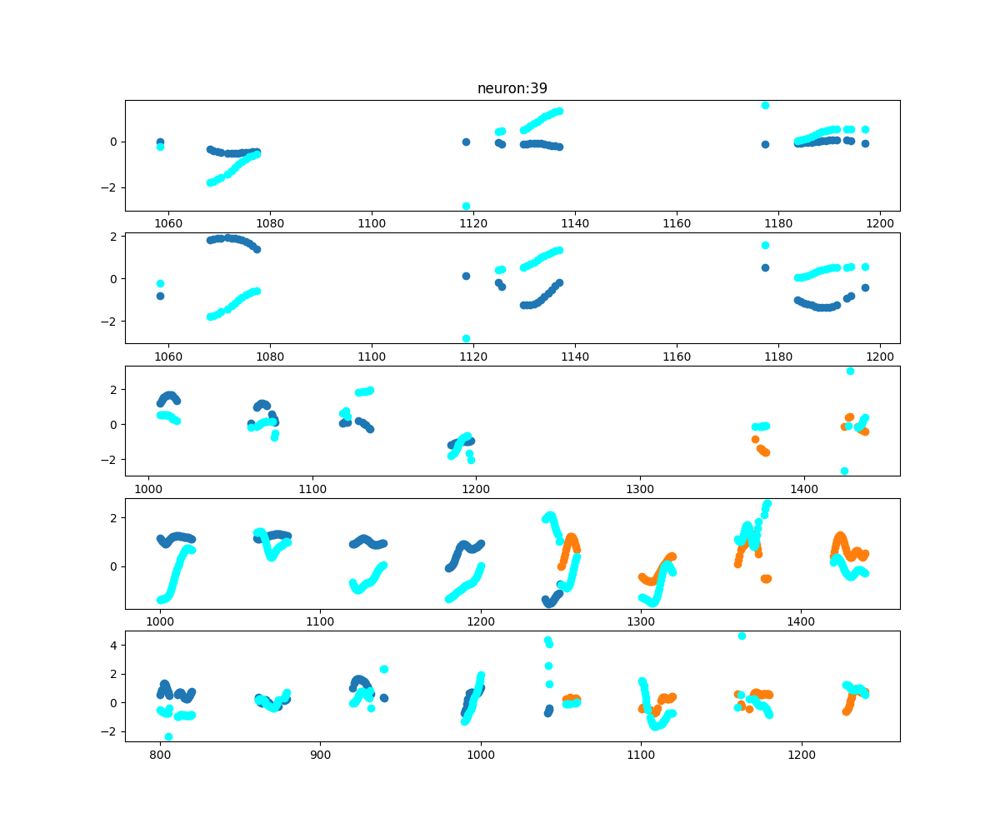

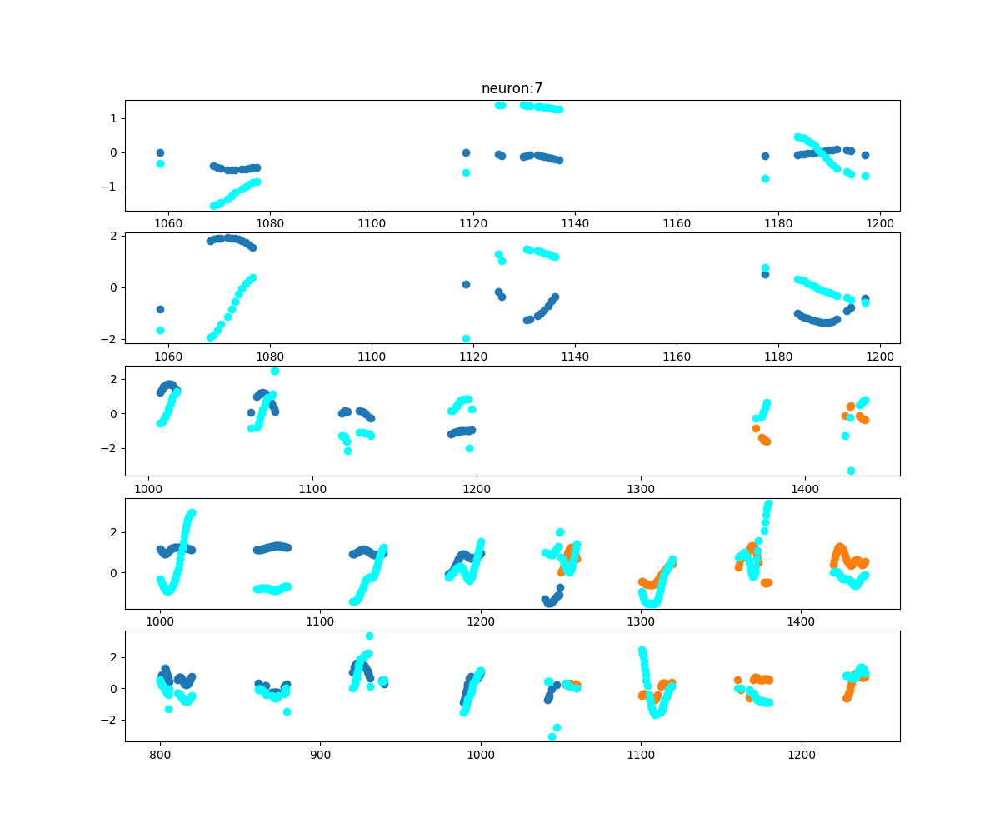

In [206]:

#compute cross correlation of head direction with neurite activity in different intervals
fig,ax = plt.subplots(5,1,figsize=(12,10))
fig2,ax2 = plt.subplots(5,1,figsize=(12,10))
ax[0].set_title("neuron:"+ str(7))
ax2[0].set_title("neuron:"+ str(39))
velchoice=38
corrN7head = np.zeros((3,4,5))#dimension1 is IAA,2NN, and buffer respectively
corrNheadExTime = np.zeros((6,16,5))#2 is for odor and after odor

Tint=10#how much to shift the activity
sig=4
rolltot = 0#determine to whether go for custom roll or a fixed one
gap=[7,7,7,10,13]#[10,10,10,14,20]#
if rolltot==0:
    roll=0
roll0 = [0,14,5,6,0]   
Neu_num = [7,8,27,28,39,40]
for n0 in range(len(Neu_num)):
    
    n2 = Neu_num[n0]
    print("neurooooooooooooooooooooooooon"+str(n2))
    for d in range(5):
        start = closest_index(MegaData0[d,:,12],IAA_int[d,0] )
        end = closest_index(MegaData0[d,:,12],IAA_int[d,1])
        rowsArr_float = MegaData[d,start:end,:]
        
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        for s in range(1,len(A)):
            if A[s]==0:
                A[s] = (A[s-1]+A[s+1])/2
        if rolltot!=0:   
            roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        # Find indices where both A and B are nonzero
        indices1 = np.nonzero(MegaData0[d,start:end,10]==1)[0]
        indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
        A1=np.array(A[indices1])
        A0=np.array(A[indices0])
        B1=np.array(B[indices1])
        B0=np.array(B[indices0])
        nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
        if (len(nonzero_indices1[0])>12):
            X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
            Y1 = A1[nonzero_indices1[0]]
            corr1=np.corrcoef(X1,Y1)
            corrNheadExTime[n0,1,d] = (corr1[0,1])
            
        nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
        X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
        Y0 = A0[nonzero_indices0[0]]
        corr0=np.corrcoef(X0,Y0)
        corrNheadExTime[n0,2,d] = (corr0[0,1])


        start = closest_index(MegaData0[d,:,12],IAA_int[d,2] )
        end = closest_index(MegaData0[d,:,12],IAA_int[d,3])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        if rolltot!=0:    
            roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        indices1 = np.nonzero(MegaData0[d,start:end,10]==1)[0]
        indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
        A1=np.array(A[indices1])
        A0=np.array(A[indices0])
        B1=np.array(B[indices1])
        B0=np.array(B[indices0])
        nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
        if (len(nonzero_indices1[0])>12):
            X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
            Y1 = A1[nonzero_indices1[0]]
            corr1=np.corrcoef(X1,Y1)
            corrNheadExTime[n0,9,d] = (corr1[0,1])
            
        nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
        X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
        Y0 = A0[nonzero_indices0[0]]
        corr0=np.corrcoef(X0,Y0)
        corrNheadExTime[n0,10,d] = (corr0[0,1])

        ### 2-Nonanone section 
        print("d###############################"+str(d))
        start = closest_index(MegaData0[d,:,12],NN_int[d,0] )
        end = closest_index(MegaData0[d,:,12],NN_intextra[d,1])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])    
        if False:#for s in range(1,len(A)):
            if A[s]==0:
                A[s] = (A[s-1]+A[s+1])/2
        if rolltot!=0:   
            roll = roll0[d]
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        indices1 = np.nonzero(MegaData0[d,start:end,10]==2)[0]
        indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
        A1=np.array(A[indices1])
        A0=np.array(A[indices0])
        B1=np.array(B[indices1])
        B0=np.array(B[indices0])
        T = MegaData0[d,start+indices1,12]
        nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))        
        print("NN0")
        print("B1:"+str(len(B1)))
        print("B0:"+str(len(B0)))
        print(len(indices1))
        if (len(nonzero_indices1[0])>12):
            X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
            Y1 = A1[nonzero_indices1[0]]
            corr1=np.corrcoef(X1,Y1)
            corrNheadExTime[n0,4,d] = (corr1[0,1])
            if n2==7:
                ax[d].scatter(T[nonzero_indices1[0]],scale[d]*Y1)
                ax[d].scatter(T[nonzero_indices1[0]],X1,color='cyan')
            if n2==39:
                ax2[d].scatter(T[nonzero_indices1[0]],scale[d]*Y1)
                ax2[d].scatter(T[nonzero_indices1[0]],X1,color='cyan')            
        nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
        X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
        Y0 = A0[nonzero_indices0[0]]
        corr0=np.corrcoef(X0,Y0)
        corrNheadExTime[n0,5,d] = (corr0[0,1])

        start = closest_index(MegaData0[d,:,12],NN_intextra[d,1])
        end = closest_index(MegaData0[d,:,12],NN_intextra[d,2])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])  
        if False:#for s in range(1,len(A)):
            if A[s]==0:
                A[s] = (A[s-1]+A[s+1])/2
        if rolltot!=0:   
            roll = roll0[d]
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        indices1 = np.nonzero(MegaData0[d,start:end,10]==2)[0]
        indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
        A1=np.array(A[indices1])
        A0=np.array(A[indices0])
        B1=np.array(B[indices1])
        B0=np.array(B[indices0])
        T = MegaData0[d,start+indices1,12]
        nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
        print("NN1")
        print("B1:"+str(len(B1)))
        print("B0:"+str(len(B0)))        
        if (len(nonzero_indices1[0])>12):
            X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
            Y1 = A1[nonzero_indices1[0]]
            corr1=np.corrcoef(X1,Y1)
            corrNheadExTime[n0,6,d] = (corr1[0,1])
            if n2==7:
                ax[d].scatter(T[nonzero_indices1[0]],scale[d]*Y1)
                ax[d].scatter(T[nonzero_indices1[0]],X1,color='cyan')
            if n2==39:
                ax2[d].scatter(T[nonzero_indices1[0]],scale[d]*Y1)
                ax2[d].scatter(T[nonzero_indices1[0]],X1,color='cyan')   
        
        nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
        print(len(nonzero_indices0[0]))
        X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
        Y0 = A0[nonzero_indices0[0]]
        corr0=np.corrcoef(X0,Y0)
        corrNheadExTime[n0,7,d] = (corr0[0,1])
        ####NN2
        start = closest_index(MegaData0[d,:,12],NN_intextra[d,3] )
        end = closest_index(MegaData0[d,:,12],NN_intextra[d,4])
        
        if d>0:
            rowsArr_float = MegaData[d,start:end,:]
            A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
            if False:#for s in range(1,len(A)):
                if A[s]==0:
                    A[s] = (A[s-1]+A[s+1])/2
            if rolltot==0:
                roll=0
            else:    
                roll = roll0[d]
            if roll!=0:
                B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
            else:    
                B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
            indices1 = np.nonzero(MegaData0[d,start:end,10]==2)[0]
            indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
            A1=np.array(A[indices1])
            A0=np.array(A[indices0])
            B1=np.array(B[indices1])
            B0=np.array(B[indices0])
            print("NN2")
            print("B1:"+str(len(B1)))
            print("B0:"+str(len(B0)))
            print(len(indices1))
            nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
            if (len(nonzero_indices1[0])>12):
                X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
                Y1 = A1[nonzero_indices1[0]]
                corr1=np.corrcoef(X1,Y1)
                corrNheadExTime[n0,12,d] = (corr1[0,1])
            nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))
            X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
            Y0 = A0[nonzero_indices0[0]]
            corr0=np.corrcoef(X0,Y0)
            corrNheadExTime[n0,13,d] = (corr0[0,1])
            
        start = closest_index(MegaData0[d,:,12],NN_intextra[d,4] )
        end = closest_index(MegaData0[d,:,12],NN_intextra[d,5])
        if d>0:
            rowsArr_float = MegaData[d,start:end,:]
            A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
            if False:#for s in range(1,len(A)):
                if A[s]==0:
                    A[s] = (A[s-1]+A[s+1])/2
            if rolltot==0:
                roll=0
            else:    
                roll = roll0[d]
            if roll!=0:
                B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
            else:    
                B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
            indices1 = np.nonzero(MegaData0[d,start:end,10]==2)[0]
            indices0 = np.nonzero(MegaData0[d,start:end,10]==0)[0]
            A1=np.array(A[indices1])
            A0=np.array(A[indices0])
            B1=np.array(B[indices1])
            B0=np.array(B[indices0])
            nonzero_indices1 = np.nonzero((A1 != 0) & (B1 != 0))
            print("NN3")
            print("B1:"+str(len(B1)))
            print("B0:"+str(len(B0)))
            if (len(nonzero_indices1[0])>12):
                X1 = compute_vector_z_score(B1[nonzero_indices1[0]])
                Y1 = A1[nonzero_indices1[0]]
                corr1=np.corrcoef(X1,Y1)
                corrNheadExTime[n0,14,d] = (corr1[0,1])
            nonzero_indices0 = np.nonzero((A0 != 0) & (B0 != 0))            
            X0 = compute_vector_z_score(B0[nonzero_indices0[0]])
            Y0 = A0[nonzero_indices0[0]]
            corr0=np.corrcoef(X0,Y0)
            corrNheadExTime[n0,15,d] = (corr0[0,1])
        ### buffer sections
        start = closest_index(MegaData0[d,:,12],IAA_int[d,1] )
        end = closest_index(MegaData0[d,:,12],NN_int[d,0])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        if rolltot==0:
            roll=0
        else:    
            roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])  
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        # Find indices where both A and B are nonzero
        nonzero_indices = np.nonzero((A != 0) & (B != 0))
        X = compute_vector_z_score(B[nonzero_indices[0]])
        Y = A[nonzero_indices[0]]

        corr=np.corrcoef(X,Y)
        corrNheadExTime[n0,3,d] = (corr[0,1])
        

        start = closest_index(MegaData0[d,:,12],NN_int[d,1] )
        end = closest_index(MegaData0[d,:,12],IAA_int[d,2])
        rowsArr_float = MegaData[d,start:end,:]
        A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
        if rolltot==0:
            roll=0
        else:    
            roll = roll0[d] 
        if roll!=0:
            B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
        else:    
            B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
        # Find indices where both A and B are nonzero
        nonzero_indices = np.nonzero((A != 0) & (B != 0))
        X = compute_vector_z_score(B[nonzero_indices[0]])
        Y = A[nonzero_indices[0]]
        corr=np.corrcoef(X,Y)
        corrNheadExTime[n0,8,d] = (corr[0,1])
        
        
        start = closest_index(MegaData0[d,:,12],IAA_int[d,3] )
        end = closest_index(MegaData0[d,:,12],NN_int[d,2])
        if d>0:
            rowsArr_float = MegaData[d,start:end,:]
            A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
            if rolltot==0:
                roll=0
            else:    
                roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])   
            if roll!=0:
                B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
            else:    
                B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero((A != 0) & (B != 0))
            X = compute_vector_z_score(B[nonzero_indices[0]])
            Y = A[nonzero_indices[0]]
            corr=np.corrcoef(X,Y)
            corrNheadExTime[n0,11,d] = (corr[0,1])
            
            
        start = closest_index(MegaData0[d,:,12],1 )
        end = closest_index(MegaData0[d,:,12],IAA_int[d,0])   
        if d<4:
            rowsArr_float = MegaData[d,start:end,:]
            A = smooth_vec_long(rowsArr_float[:,velchoice],sig,gap[d])
            if rolltot==0:
                roll=0
            else:    
                roll = roll0[d]#convert_time_tofr(Tint,MegaData0[d,:end,:])     
            if roll!=0:
                B = smooth_vec_long(np.roll(rowsArr_float[:,n2],roll),sig,gap[d])#positive for A correponding to B in the past
            else:    
                B = smooth_vec_long(rowsArr_float[:,n2],sig,gap[d])
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero((A != 0) & (B != 0))
            X = compute_vector_z_score(B[nonzero_indices[0]])
            Y = A[nonzero_indices[0]]
            corr=np.corrcoef(X,Y)
            corrNheadExTime[n0,0,d] = (corr[0,1])
             
plt.show()

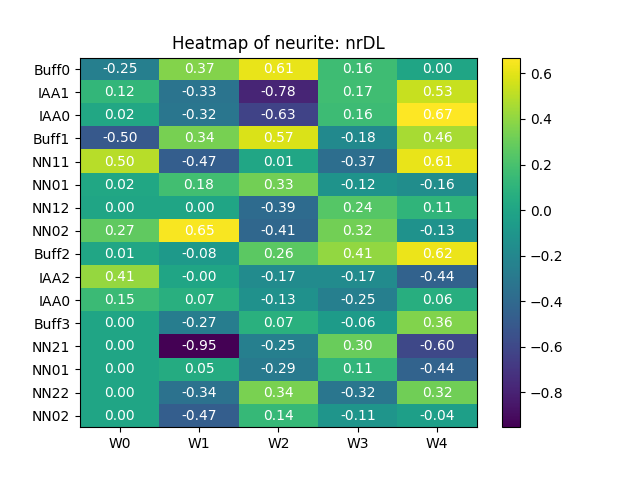

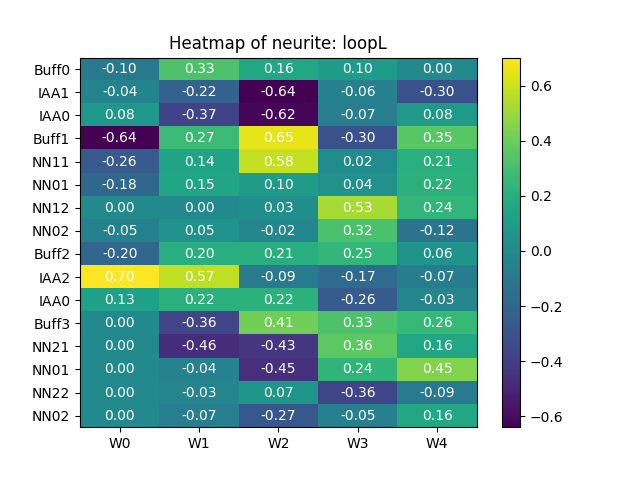

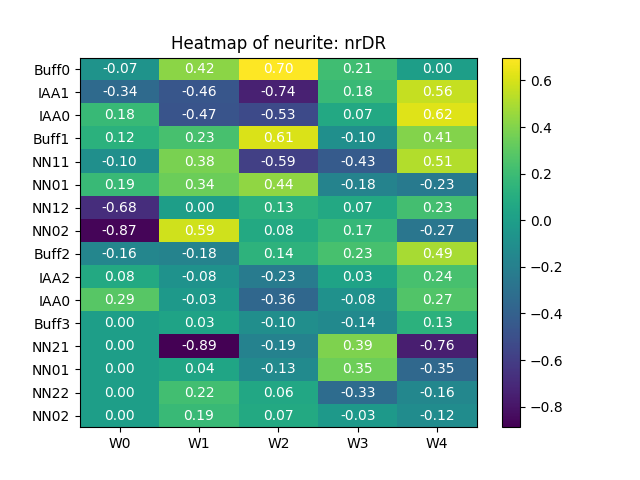

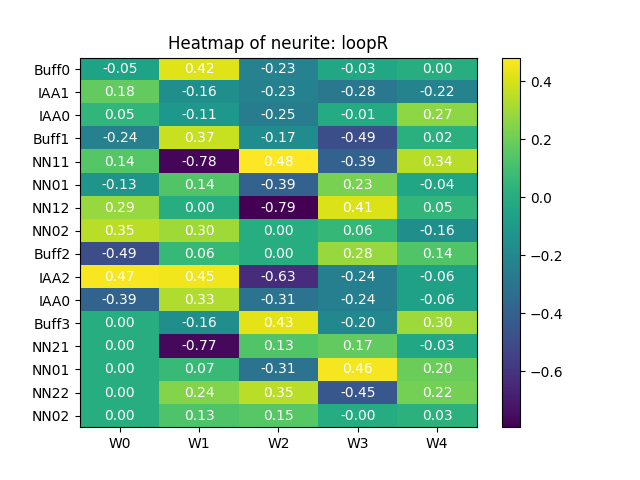

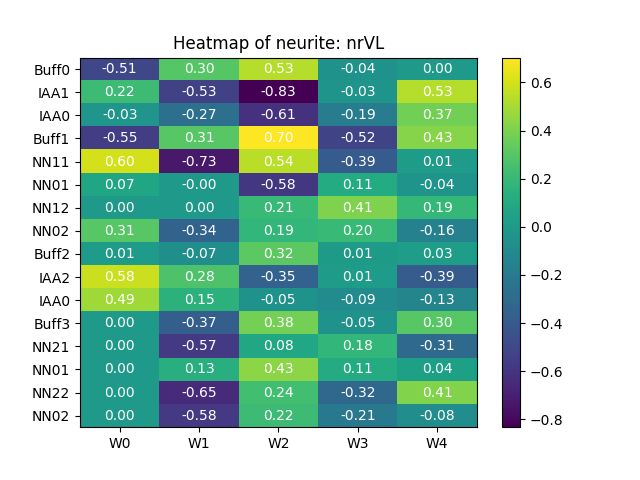

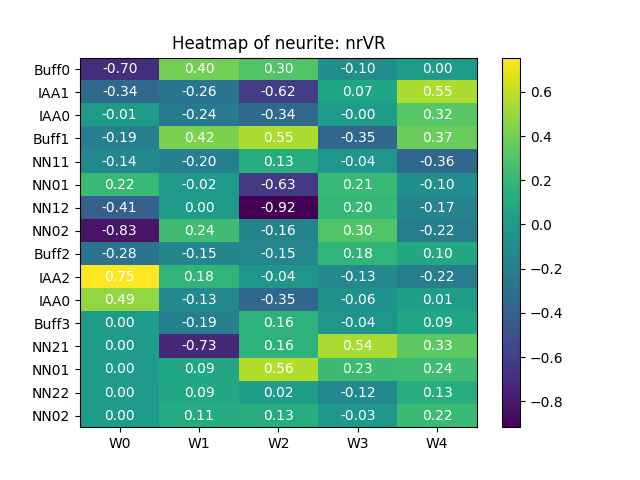

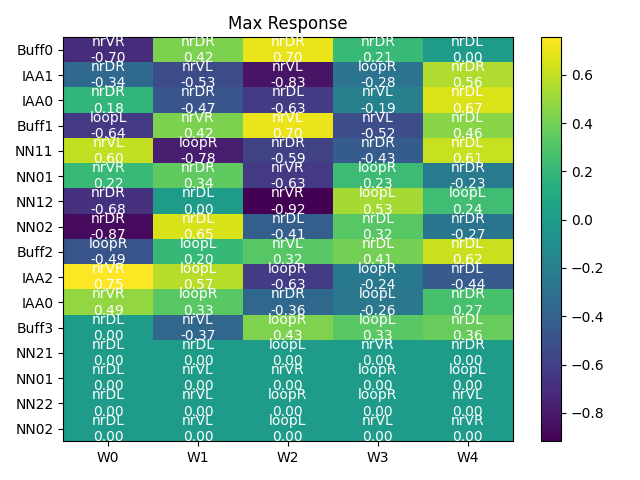

In [207]:
y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN11','NN01','NN12','NN02', 'Buff2', 'IAA2','IAA0', 'Buff3','NN21','NN01','NN22','NN02']
y_labels2swap = [ 'Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
x_labels2 = ['W0','W1','W2','W3','W4']#x_labels[7:]
x_labels = ['RIAL', 'RIAR', 'RIML', 'RIMR', 'RIBL', 'RIBR', 'sensory', 
            'nrDL', 'loopL', 'nrDR', 'loopR', 'nrVL', 'nrVR']
n_label = x_labels[7:]
for n in range(len(Neu_num)):
    fig, ax = plt.subplots()
    Mat = corrNheadExTime[n,:,:]
    cax = ax.imshow(Mat, cmap='viridis', aspect='auto')
    cbar = fig.colorbar(cax)
    # Annotate the values on the heatmap
    for i in range(Mat.shape[0]):
        for j in range(Mat.shape[1]):
            ax.text(j, i, f'{Mat[i, j]:.2f}', ha='center', va='center', color='white')
    
    # Set labels and title (optional)
    ax.set_title('Heatmap of neurite: '+n_label[n])
    
    
    ax.set_yticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
    ax.set_yticklabels(y_labels2)
    ax.set_xticks(np.arange(len(x_labels2)))  # Set the y-ticks to the number of rows
    ax.set_xticklabels(x_labels2)
    plt.show()

###plot neurites with maximum response
#corrNheadExTime[corrNheadExTime==0]=np.nan
max_indices = np.argmax(np.abs(corrNheadExTime), axis=0)
max_neur_response = np.zeros((16, 5))

# Extract the actual values (not absolute) from the original matrix using the indices
for i in range(12):
    for j in range(5):
        max_neur_response[i, j] = corrNheadExTime[max_indices[i, j], i, j]
fig, ax = plt.subplots()
Mat = max_neur_response
Maxind = max_indices
cax = ax.imshow(Mat, cmap='viridis', aspect='auto')
fig.colorbar(cax)
for i in range(Mat.shape[0]): 
    for j in range(Mat.shape[1]):  
        ax.text(j, i, f'{n_label[Maxind[i, j]]}\n{Mat[i, j]:.2f}', ha='center', va='center', color='white')
ax.set_title('Max Response')
ax.set_yticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
ax.set_yticklabels(y_labels2)
ax.set_xticks(np.arange(len(x_labels2)))  # Set the y-ticks to the number of rows
ax.set_xticklabels(x_labels2)
plt.tight_layout()
plt.show()

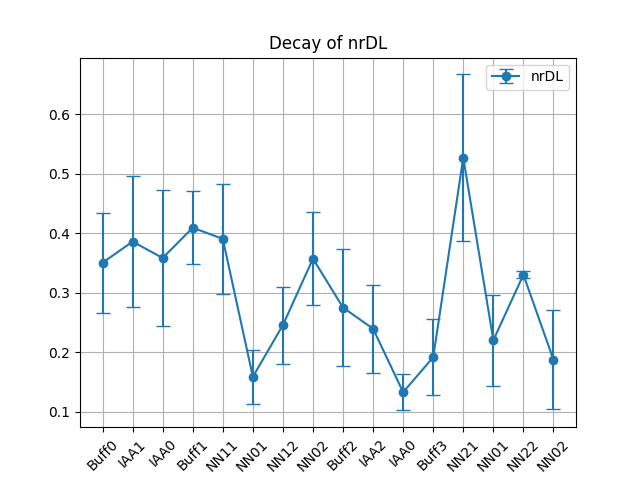

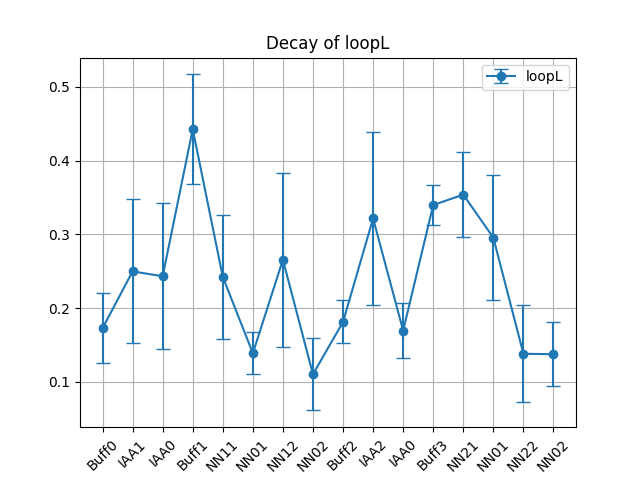

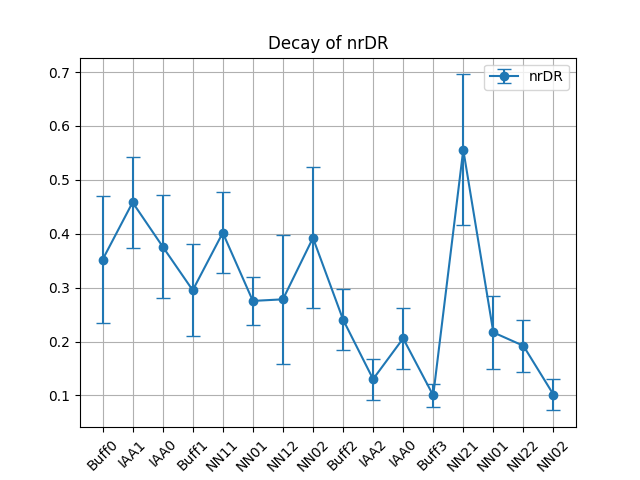

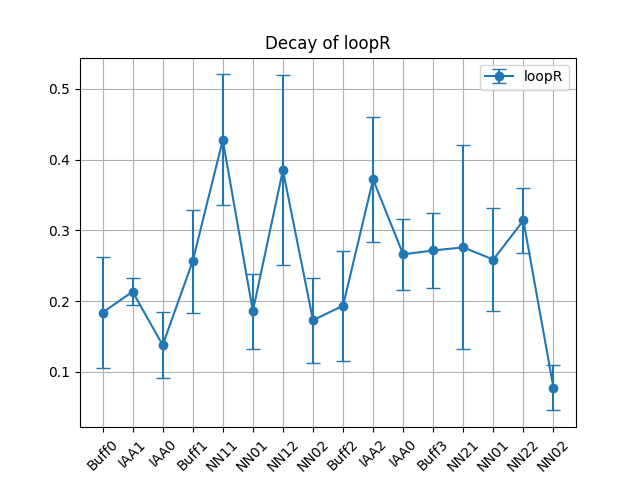

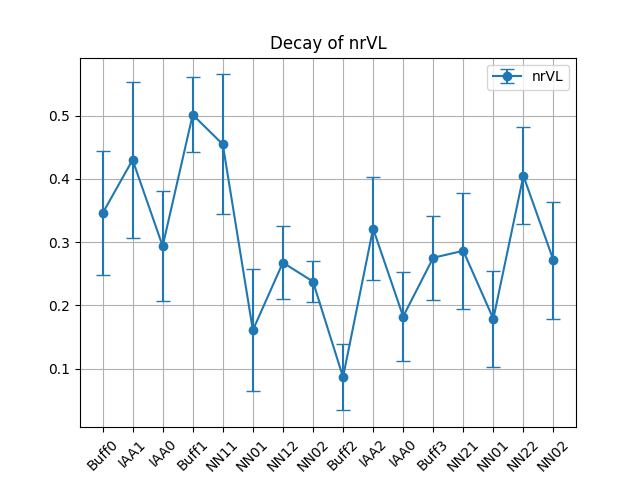

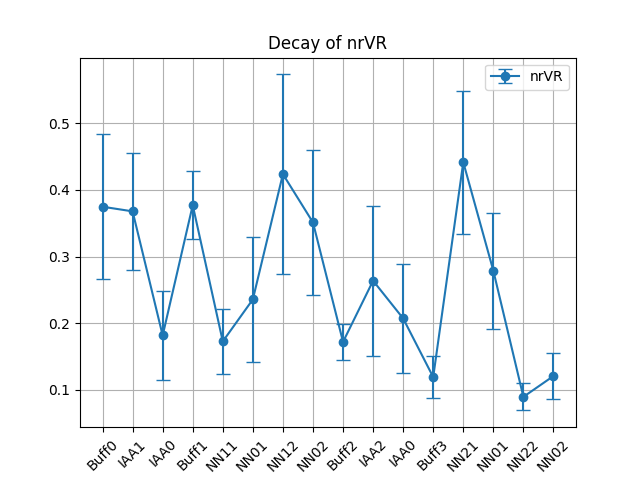

In [209]:
#plot neurite response decay during odors
y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN11','NN01','NN12','NN02', 'Buff2', 'IAA2','IAA0', 'Buff3','NN21','NN01','NN22','NN02']
y_labels2swap = [ 'Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
x_labels2 = ['W0','W1','W2','W3','W4']#x_labels[7:]
n_label = x_labels[7:]
#plot neurite response decay

x_labels2 = ['W0','W1','W2','W3','W4']#x_labels[7:]
n_label = x_labels[7:]
for n in range(len(Neu_num)):
    fig, ax = plt.subplots()
    Mat = np.abs(corrNheadExTime[n,:,:])
    Mat[Mat==0] =  np.nan    
    means = np.nanmean(Mat, axis=1)
    stds = np.nanstd(Mat, axis=1)/np.sqrt(np.sum(~np.isnan(Mat), axis=1))
    ax.errorbar(np.arange(len(means)),means, yerr=stds, capsize=5, fmt='-o', label=n_label[n])
    # Set labels and title (optional)
    ax.set_title("Decay of "+ n_label[n])
    ax.set_xticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
    ax.set_xticklabels(y_labels2,rotation=45)
    plt.legend()
    plt.grid(True)
    plt.show()

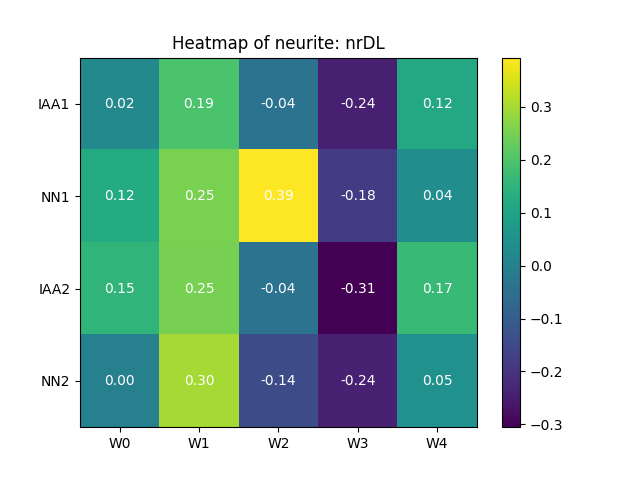

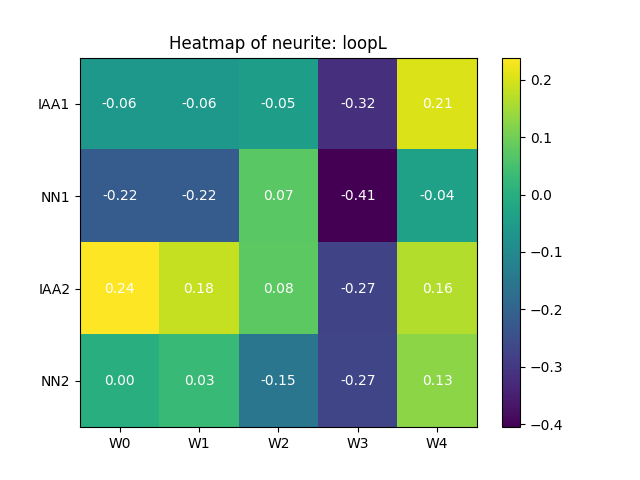

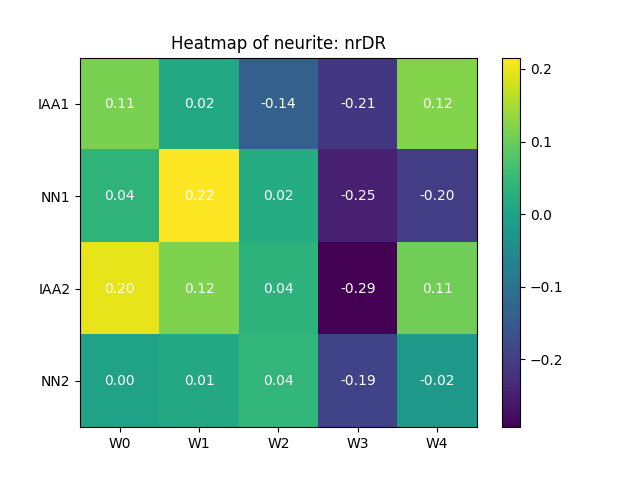

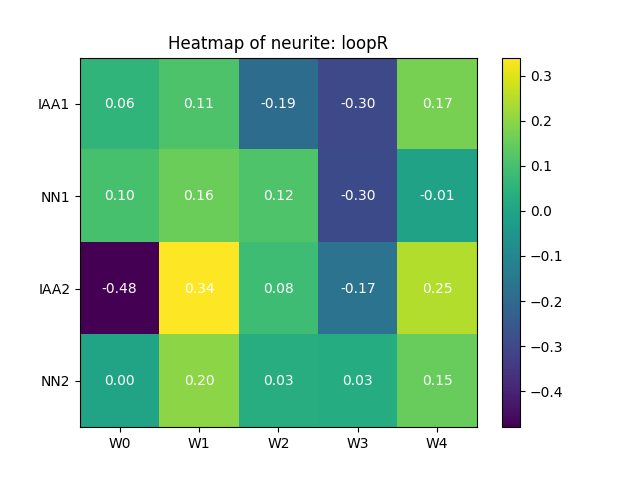

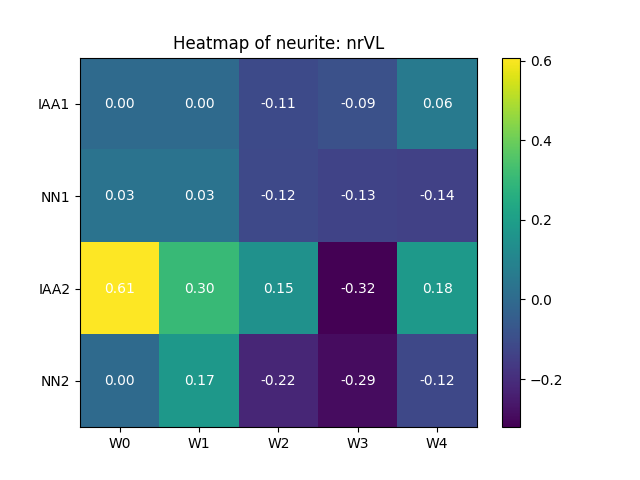

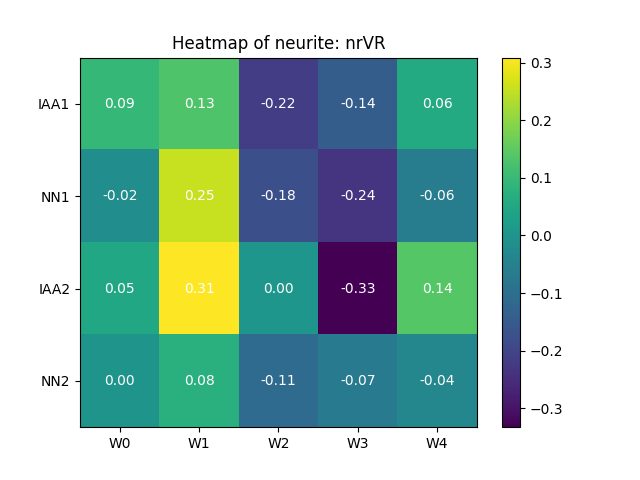

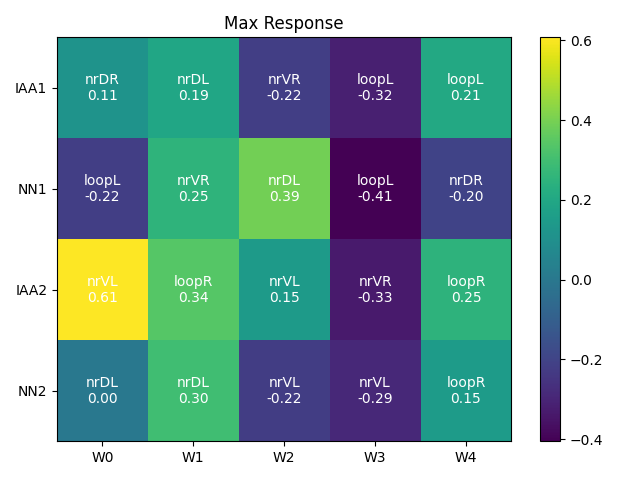

In [266]:
#each neurite averaged across worms
fs=16
matrix = np.abs(corrNheadExTime[:,:,:])

#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2 = ['Buff0', 'IAA1','IAA0', 'Buff1', 'NN11','NN01','NN12','NN02', 'Buff2', 'IAA2','IAA0', 'Buff3','NN21','NN01','NN22','NN02']
y_labels2swap = [ 'Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
y_labels2swap = [ 'Buff0','Buff1','Buff2','Buff3','IAA1', 'IAA2','IAA0_1', 'IAA0_2','NN1','NN2','NN0_1','NN0_2']
for n in range(6):
    current_matrix0 = matrix[n, :, :]
    current_matrix = current_matrix0[[0,3,6,9,1,7,2,8,4,10,5,11],:]
    means = np.nanmean(current_matrix, axis=1)
    stds = np.nanstd(current_matrix, axis=1)/np.sqrt(np.sum(~np.isnan(current_matrix), axis=1))
    plt.figure(figsize=(12, 5))
    plt.bar(np.arange(current_matrix.shape[0]), means, yerr=stds, capsize=5, alpha=0.7, width=0.4)
    plt.title("Average Response: "+n_label[n],fontsize=fs)
    plt.ylabel('Mean ± Sem',fontsize=fs)
    plt.xticks(np.arange(len(y_labels2)), labels=y_labels2swap,fontsize=fs+3,rotation=45) 
    plt.tick_params(axis='y', labelsize=fs)
    plt.tight_layout()
    plt.grid(True)
    plt.show()

In [154]:
print(max_neur_response)
print(max_indices)

[[ 0.          0.          0.          0.          0.        ]
 [ 0.11412741  0.19420258 -0.21726782 -0.31736338  0.20572571]
 [ 0.          0.          0.          0.          0.        ]
 [-0.21748132  0.25370204  0.3933584  -0.40542941 -0.20144176]
 [ 0.          0.          0.          0.          0.        ]
 [ 0.60732408  0.34067293  0.14712719 -0.33294164  0.24744431]
 [ 0.          0.          0.          0.          0.        ]
 [ 0.          0.29823553 -0.22081288 -0.2890877   0.15141426]]
[[0 0 0 0 0]
 [2 0 5 1 1]
 [0 0 0 0 0]
 [1 5 0 1 2]
 [0 0 0 0 0]
 [4 3 4 5 3]
 [0 0 0 0 0]
 [0 0 4 4 3]]


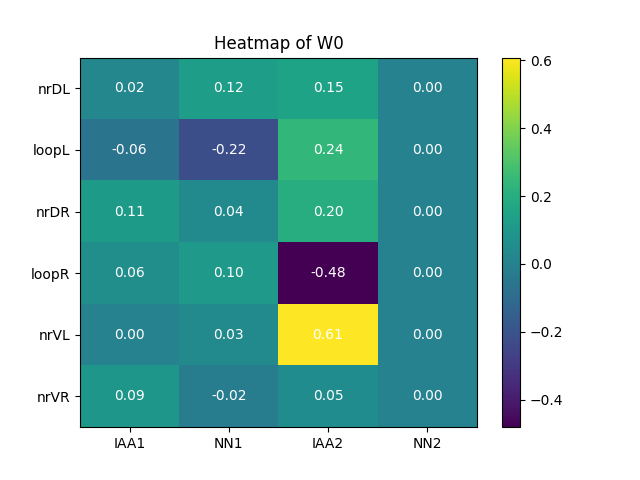

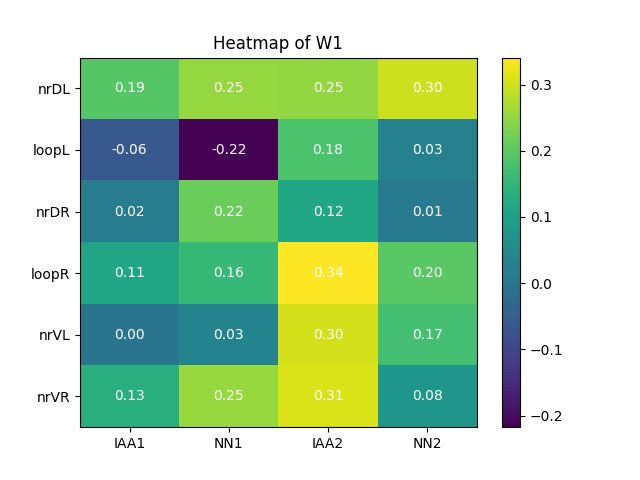

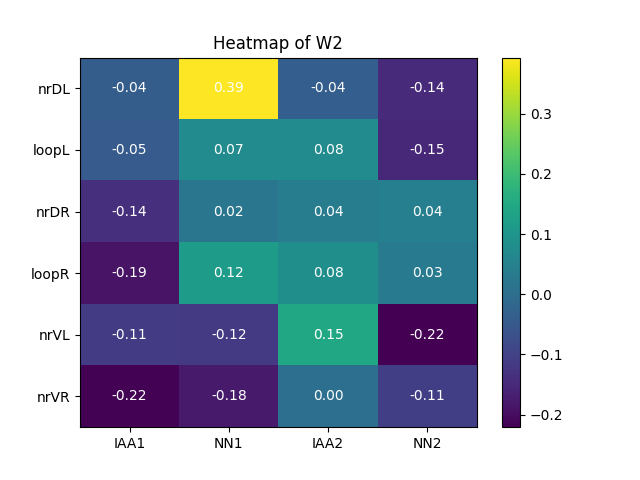

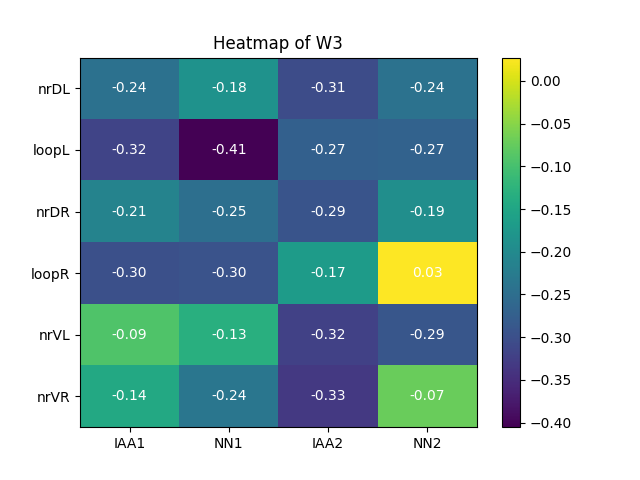

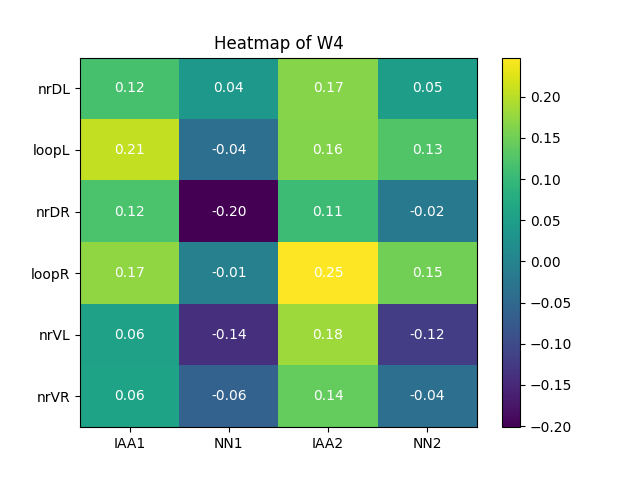

In [144]:
y_labels2 = [ 'IAA1', 'NN1', 'IAA2','NN2']
x_labels2 = ['W0','W1','W2','W3','W4']#x_labels[7:]
n_label = x_labels[7:]
for d in range(5):
    fig, ax = plt.subplots()
    Mat = corrNodorTEMPORAL[:,1::2,d]
    cax = ax.imshow(Mat, cmap='viridis', aspect='auto')
    cbar = fig.colorbar(cax)
    # Annotate the values on the heatmap
    for i in range(Mat.shape[0]):
        for j in range(Mat.shape[1]):
            ax.text(j, i, f'{Mat[i, j]:.2f}', ha='center', va='center', color='white')
    
    # Set labels and title (optional)
    ax.set_title('Heatmap of '+x_labels2[d])
    
    
    ax.set_yticks(np.arange(len(n_label)))  # Set the y-ticks to the number of rows
    ax.set_yticklabels(n_label)
    ax.set_xticks(np.arange(len(y_labels2)))  # Set the y-ticks to the number of rows
    ax.set_xticklabels(y_labels2)
    plt.show()

/tmp/ipykernel_6231/2337424169.py:10: RuntimeWarning: Mean of empty slice
  means = np.nanmean(current_matrix, axis=0)
/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


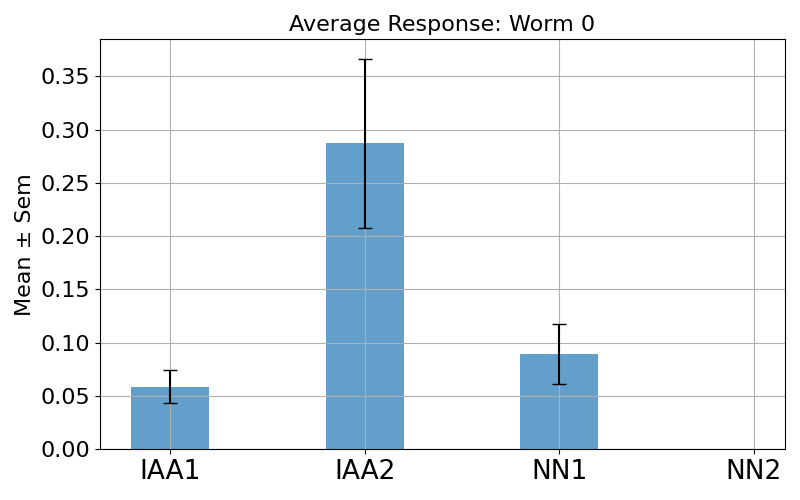

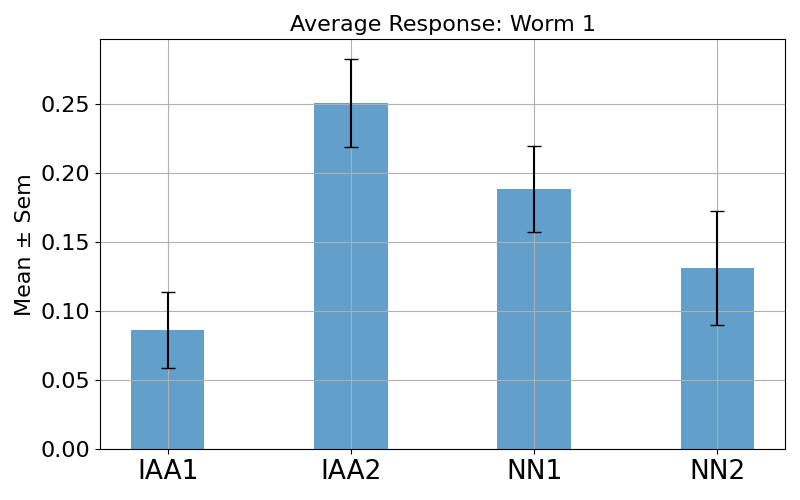

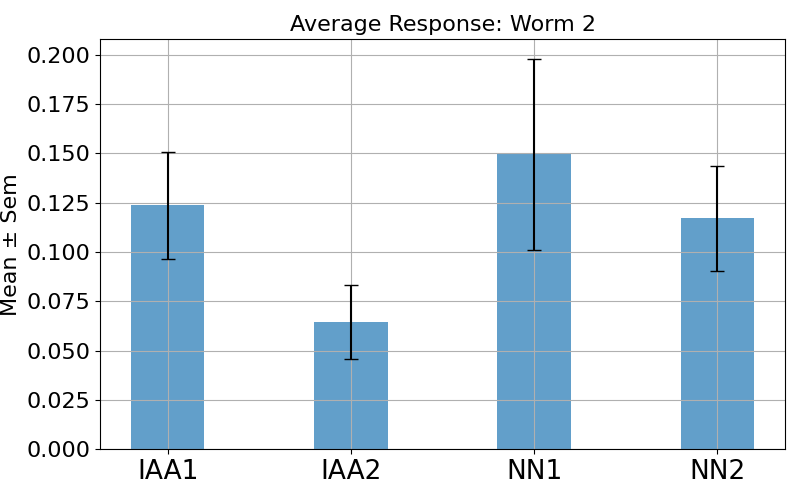

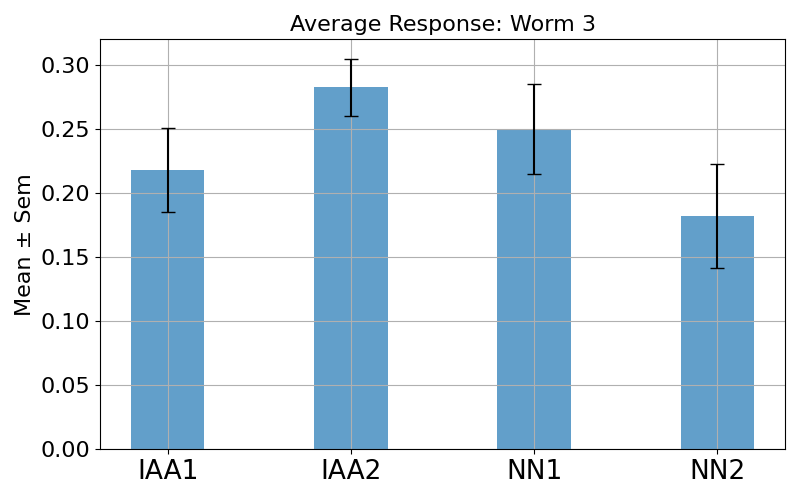

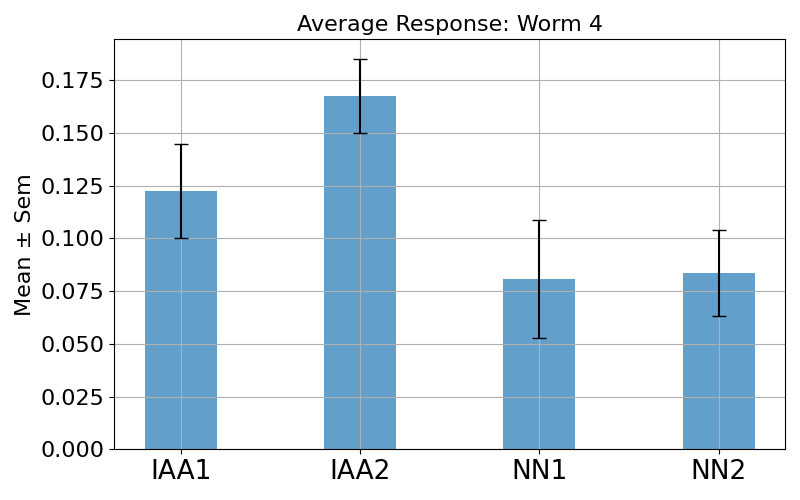

In [333]:
fs=16
matrix = np.abs(corrNodorTEMPORAL[:,1::2,:])
#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2Oswap = [ 'IAA1', 'IAA2', 'NN1','NN2']
for d in range(5):
    current_matrix0 = matrix[:, :, d]
    print()
    current_matrix = current_matrix0[:, [0,2, 1,3]]
    means = np.nanmean(current_matrix, axis=0)
    stds = np.nanstd(current_matrix, axis=0)/np.sqrt(np.sum(~np.isnan(current_matrix), axis=0))

    plt.figure(figsize=(8, 5))
    plt.bar(np.arange(current_matrix.shape[1]), means, yerr=stds, capsize=5, alpha=0.7, width=0.4)
    plt.title("Average Response: Worm "+str(d),fontsize=fs)
    plt.ylabel('Mean ± Sem',fontsize=fs)
    plt.xticks(np.arange(len(y_labels2O)), labels=y_labels2Oswap,fontsize=fs+3) 
    plt.tick_params(axis='y', labelsize=fs)
    plt.tight_layout()
    plt.grid(True)
    plt.show()

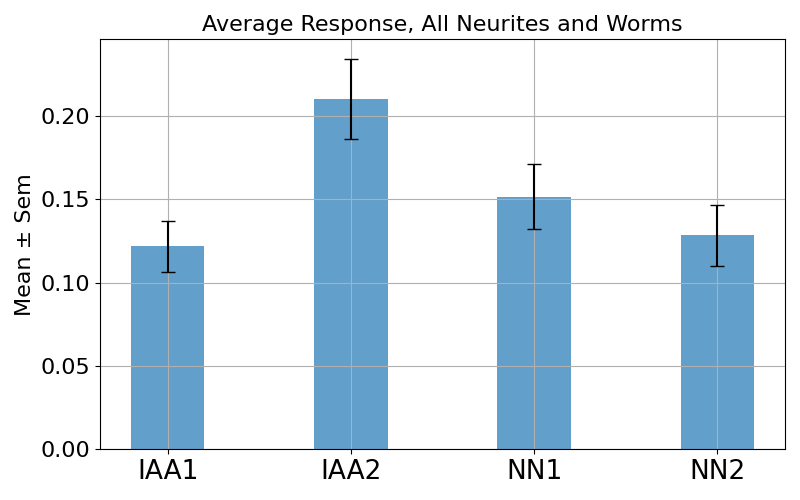

In [332]:
#mean across worm and neurite
fs=16
matrix = np.abs(corrNodorTEMPORAL[:,1::2,:])
#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2swap = [ 'IAA1', 'IAA2', 'NN1','NN2']
if True:
    current_matrix0 = matrix
    current_matrix = current_matrix0[:, [0,2, 1,3],:]
    means = np.nanmean(current_matrix, axis=(0,2))
    stds = np.nanstd(current_matrix, axis=(0,2))/np.sqrt(np.sum(~np.isnan(current_matrix), axis=(0,2)))

    plt.figure(figsize=(8, 5))
    plt.grid(True)
    plt.bar(np.arange(current_matrix.shape[1]), means, yerr=stds, capsize=5, alpha=0.7, width=0.4)
    plt.title("Average Response, All Neurites and Worms",fontsize=fs)
    plt.ylabel('Mean ± Sem',fontsize=fs)
    plt.xticks(np.arange(len(y_labels2O)), labels=y_labels2swapO,fontsize=fs+3) 
    plt.tick_params(axis='y', labelsize=fs)
    plt.tight_layout()
    plt.show()

(6, 4, 5)


/tmp/ipykernel_6231/56983006.py:12: RuntimeWarning: All-NaN slice encountered
  Maxim = np.nanmax(current_matrix, axis=0)


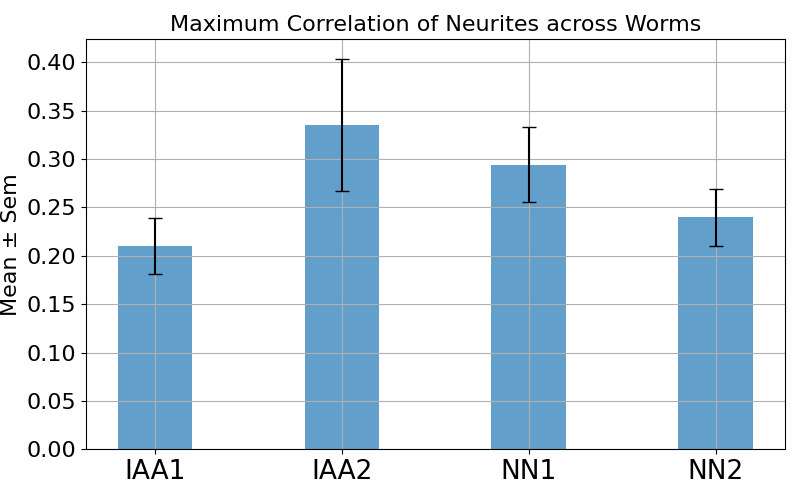

In [328]:
#Max neurites all worms
print(np.shape(matrix))
fs=16
matrix = np.abs(corrNodorTEMPORAL[:,1::2,:])
#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2swapO = [ 'IAA1', 'IAA2', 'NN1','NN2']
y_labels2O = [ 'IAA1', 'NN1', 'IAA2','NN2']
current_matrix0 = matrix
current_matrix = current_matrix0[:,[0,2, 1,3],:]
#current_matrix = current_matrix0[:,:,:]
Maxim = np.nanmax(current_matrix, axis=0)
means0 = np.nanmean(Maxim, axis=1)#average maximums across worms
stds = np.nanstd(Maxim, axis=1)/np.sqrt(np.sum(~np.isnan(Maxim), axis=1))
plt.figure(figsize=(8, 5))
plt.grid(True)
plt.bar(np.arange(Maxim.shape[0]), means0, yerr=stds, capsize=5, alpha=0.7, width=0.4)
plt.title("Maximum Correlation of Neurites across Worms",fontsize=fs)
plt.ylabel('Mean ± Sem',fontsize=fs)
plt.xticks(np.arange(len(y_labels2O)), labels=y_labels2swapO,fontsize=fs+3) 
plt.tick_params(axis='y', labelsize=fs)
plt.tight_layout()

plt.show()

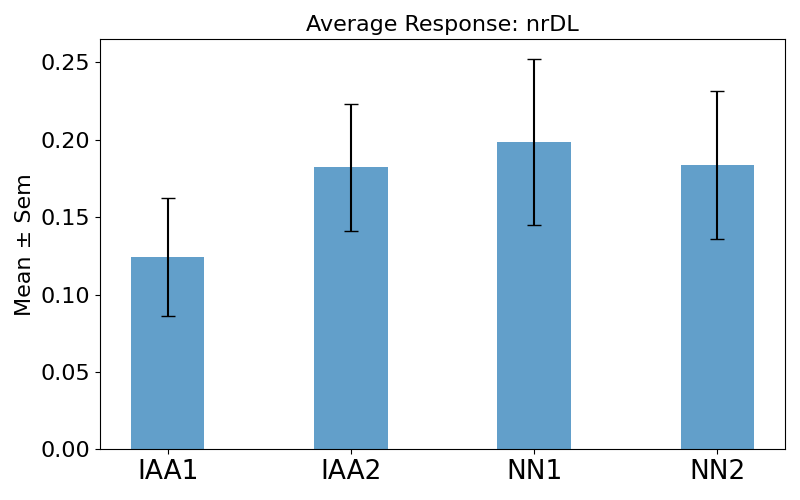

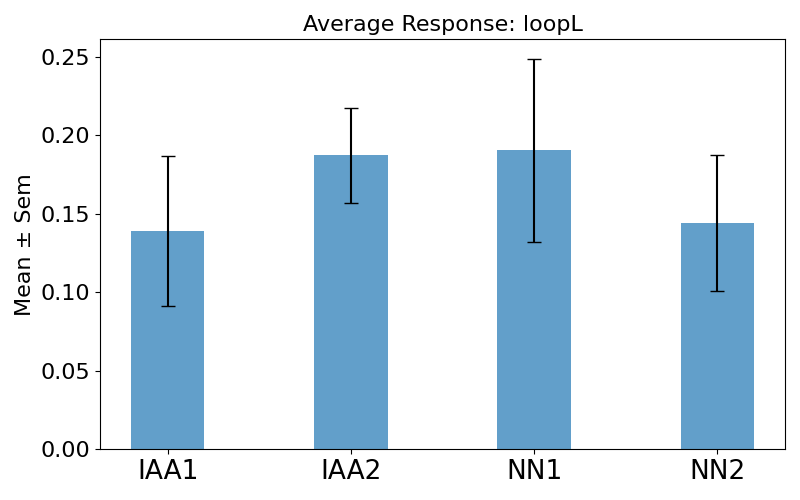

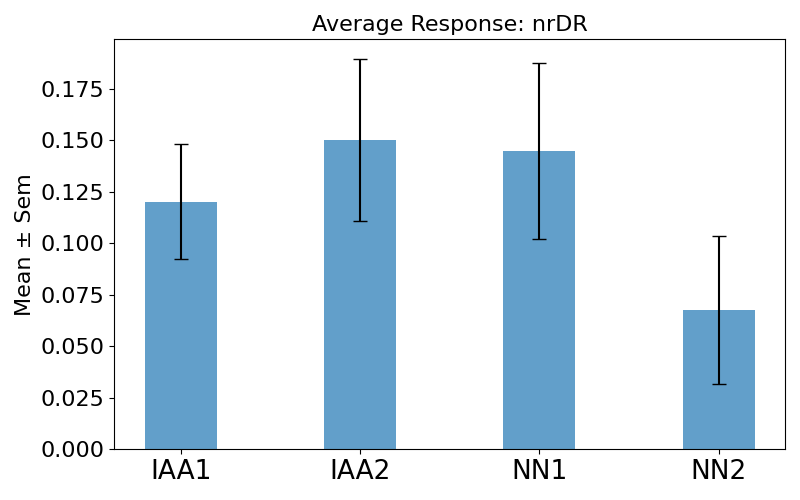

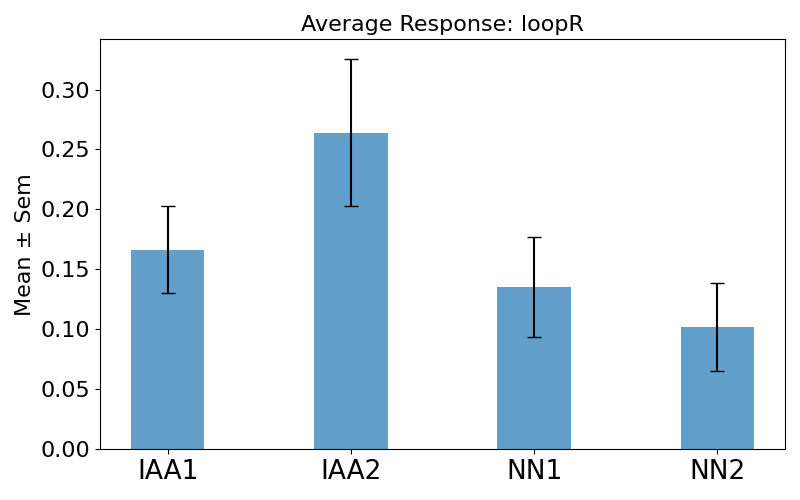

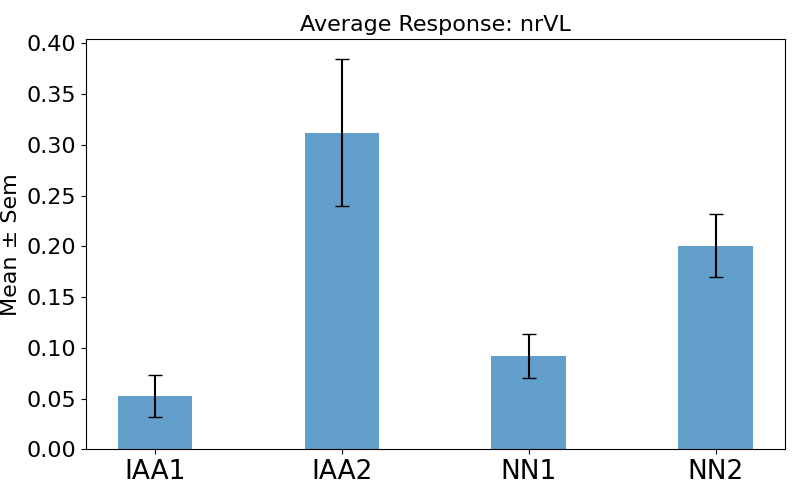

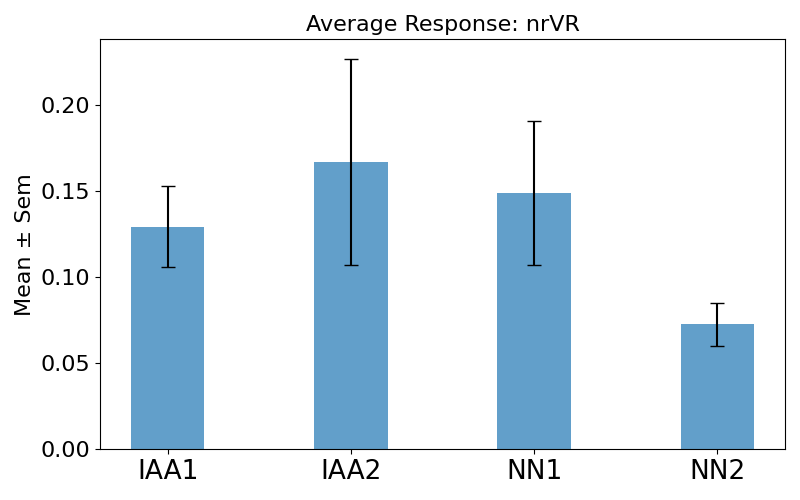

In [300]:
fs=16
matrix = np.abs(corrNodorTEMPORAL[:,1::2,:])
#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2swap = [ 'IAA1', 'IAA2', 'NN1','NN2']
for n in range(6):
    current_matrix0 = matrix[n, :, :]
    print()
    current_matrix = current_matrix0[ [0,2, 1,3],:]
    means = np.nanmean(current_matrix, axis=1)
    stds = np.nanstd(current_matrix, axis=1)/np.sqrt(np.sum(~np.isnan(current_matrix), axis=1))

    plt.figure(figsize=(8, 5))
    plt.bar(np.arange(current_matrix.shape[0]), means, yerr=stds, capsize=5, alpha=0.7, width=0.4)
    plt.title("Average Response: "+n_label[n],fontsize=fs)
    plt.ylabel('Mean ± Sem',fontsize=fs)
    plt.xticks(np.arange(len(y_labels2swap)), labels=y_labels2swap,fontsize=fs+3) 
    plt.tick_params(axis='y', labelsize=fs)
    plt.tight_layout()
    plt.show()

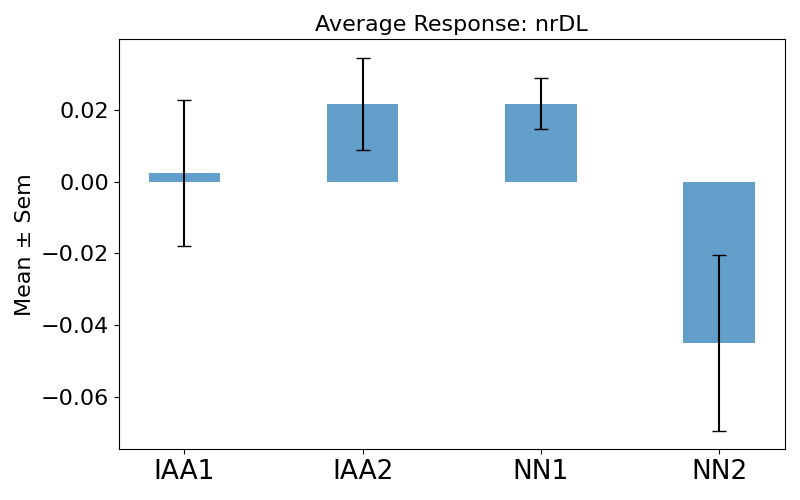

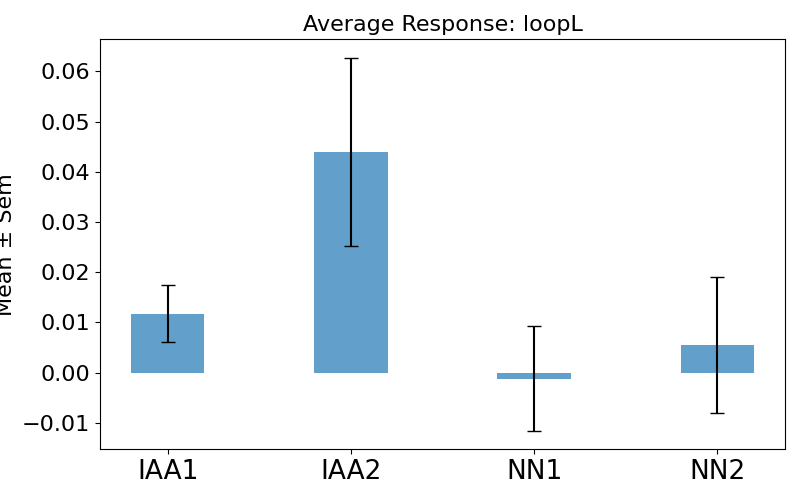

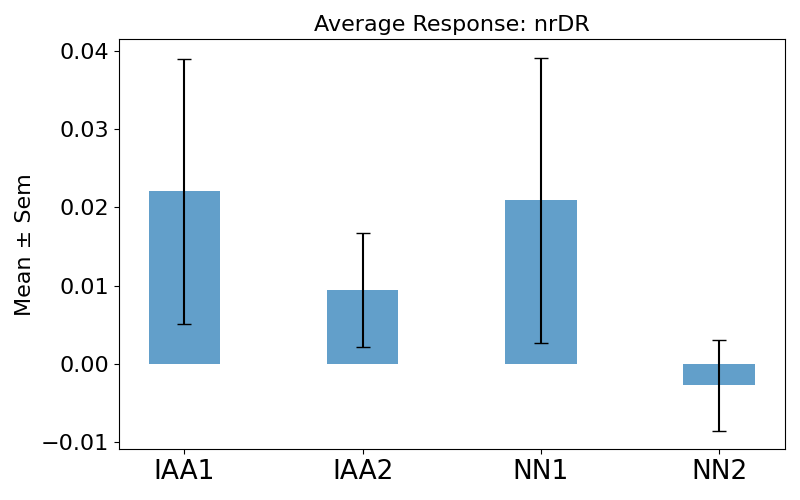

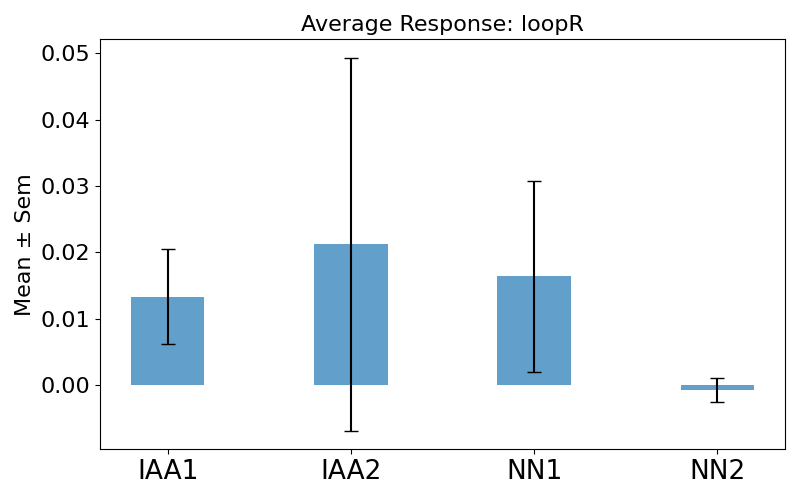

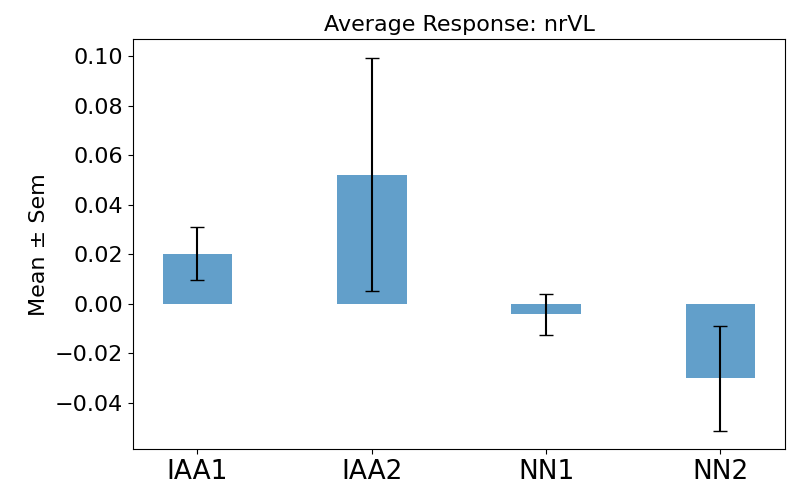

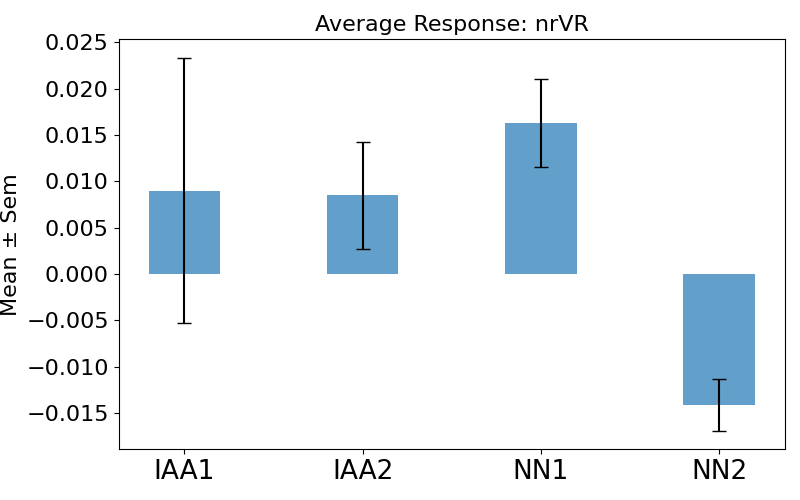

In [303]:
#plt odor and behavior correlations for each neurite
fs=16
matrix = np.abs(corrNodorTEMPORAL[:,1::2,:])+ np.abs(corrNheadTEMPORAL[:,1::2,:])
#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2swap = [ 'IAA1', 'IAA2', 'NN1','NN2']
for n in range(6):
    current_matrix0 = matrix[n, :, :]
    print()
    current_matrix = current_matrix0[ [0,2, 1,3],:]
    means = np.nanmean(current_matrix, axis=1)
    stds = np.nanstd(current_matrix, axis=1)/np.sqrt(np.sum(~np.isnan(current_matrix), axis=1))

    plt.figure(figsize=(8, 5))
    plt.bar(np.arange(current_matrix.shape[0]), means, yerr=stds, capsize=5, alpha=0.7, width=0.4)
    plt.title("Average Response: "+n_label[n],fontsize=fs)
    plt.ylabel('Mean ± Sem',fontsize=fs)
    plt.xticks(np.arange(len(y_labels2swap)), labels=y_labels2swap,fontsize=fs+3) 
    plt.tick_params(axis='y', labelsize=fs)
    plt.tight_layout()
    plt.show()

/tmp/ipykernel_6231/3642793686.py:11: RuntimeWarning: All-NaN slice encountered
  means = np.nanmax(current_matrix, axis=0)


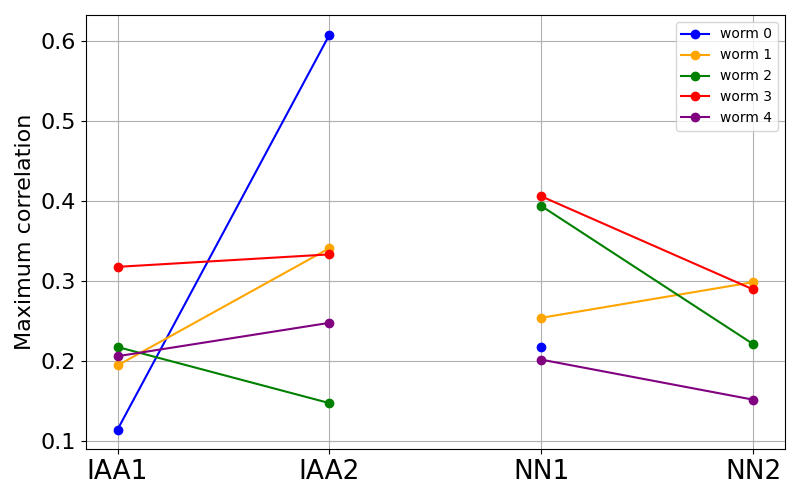

In [270]:
fs=16
color=['blue','orange','green','red','purple']
matrix = np.abs(corrNodorTEMPORAL[:,1::2,:])
#matrix[matrix<0.08]= np.nan
matrix[matrix==0]= np.nan
y_labels2swap = [ 'IAA1', 'IAA2', 'NN1','NN2']
plt.figure(figsize=(8, 5))
for d in range(5):
    current_matrix0 = matrix[:, :, d]
    current_matrix = current_matrix0[:, [0,2, 1,3]]
    means = np.nanmax(current_matrix, axis=0)
    #stds = np.nanstd(current_matrix, axis=0)/np.sqrt(np.sum(~np.isnan(current_matrix), axis=0))

    
    plt.plot(np.arange(2), means[:2], marker='o', color = color[d], label=f'worm {d}')
    plt.plot(np.arange(2,4), means[2:], marker='o', color = color[d])
    #plt.title("Average Response: Worm "+str(d),fontsize=fs)
    plt.ylabel('Maximum correlation',fontsize=fs)
    plt.xticks(np.arange(len(y_labels2)), labels=y_labels2swap,fontsize=fs+3) 
    plt.tick_params(axis='y', labelsize=fs)
    plt.tight_layout()
plt.legend()
plt.grid(True)

plt.show()

/tmp/ipykernel_1077262/3322528964.py:472: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


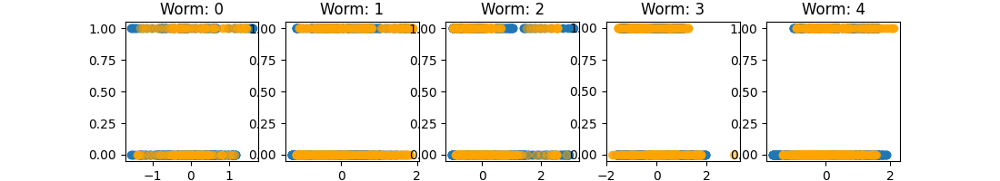

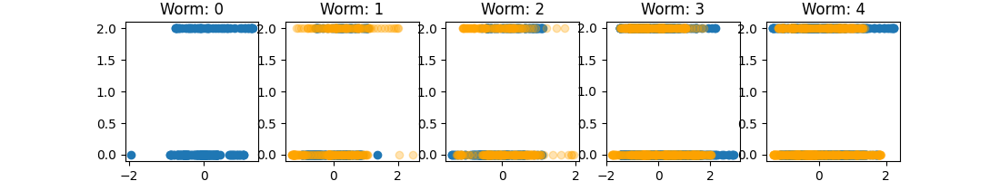

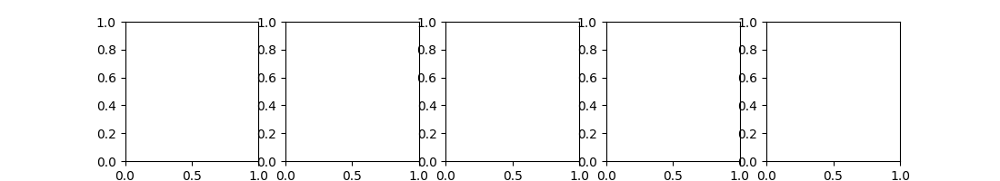

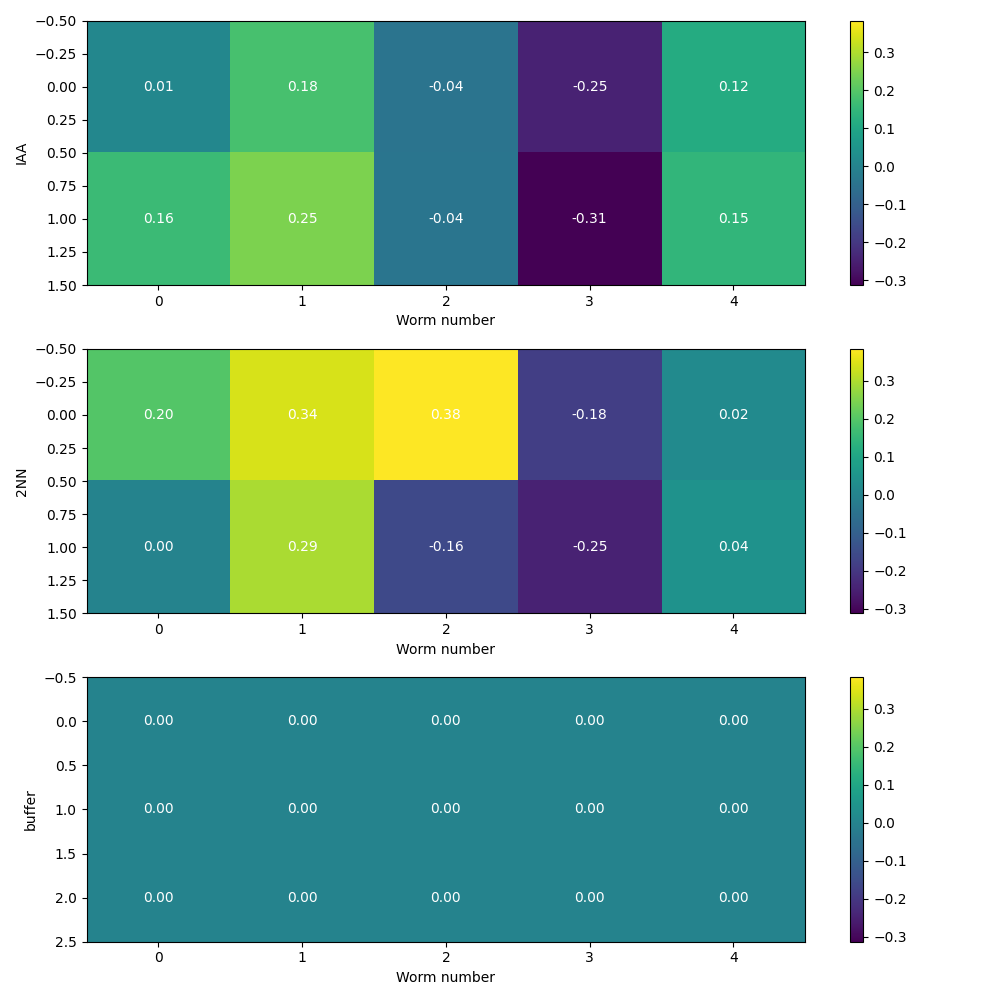

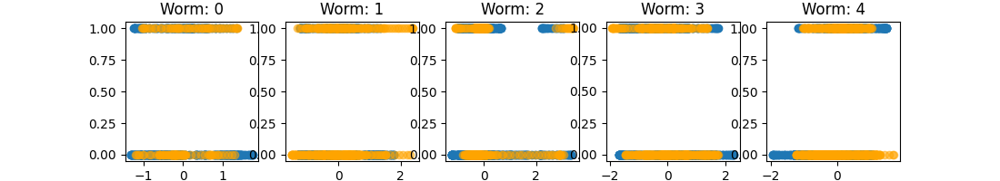

...

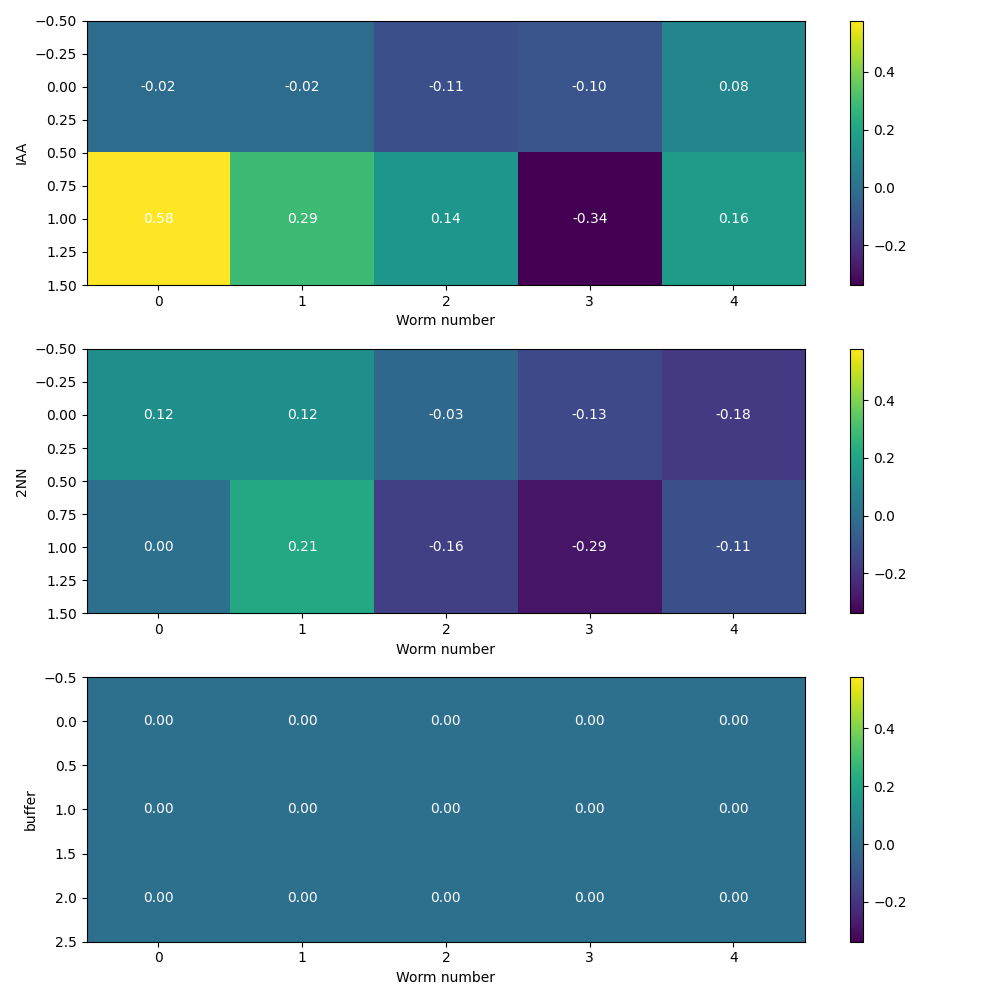

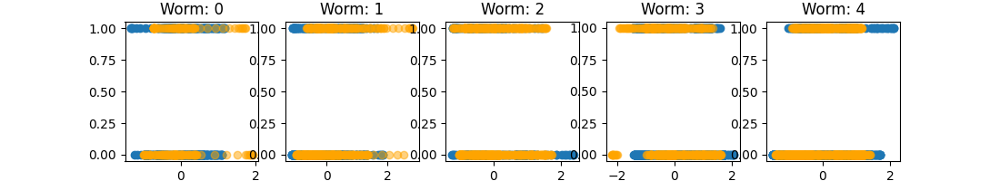

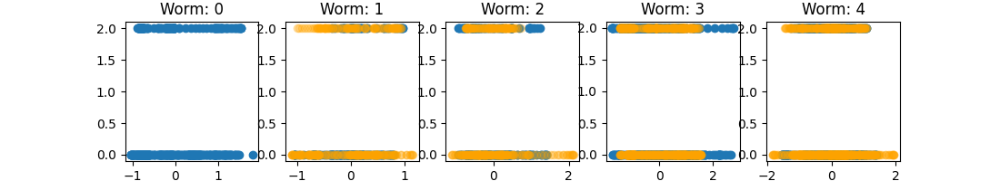

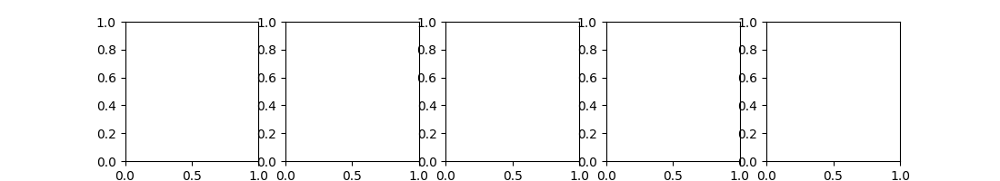

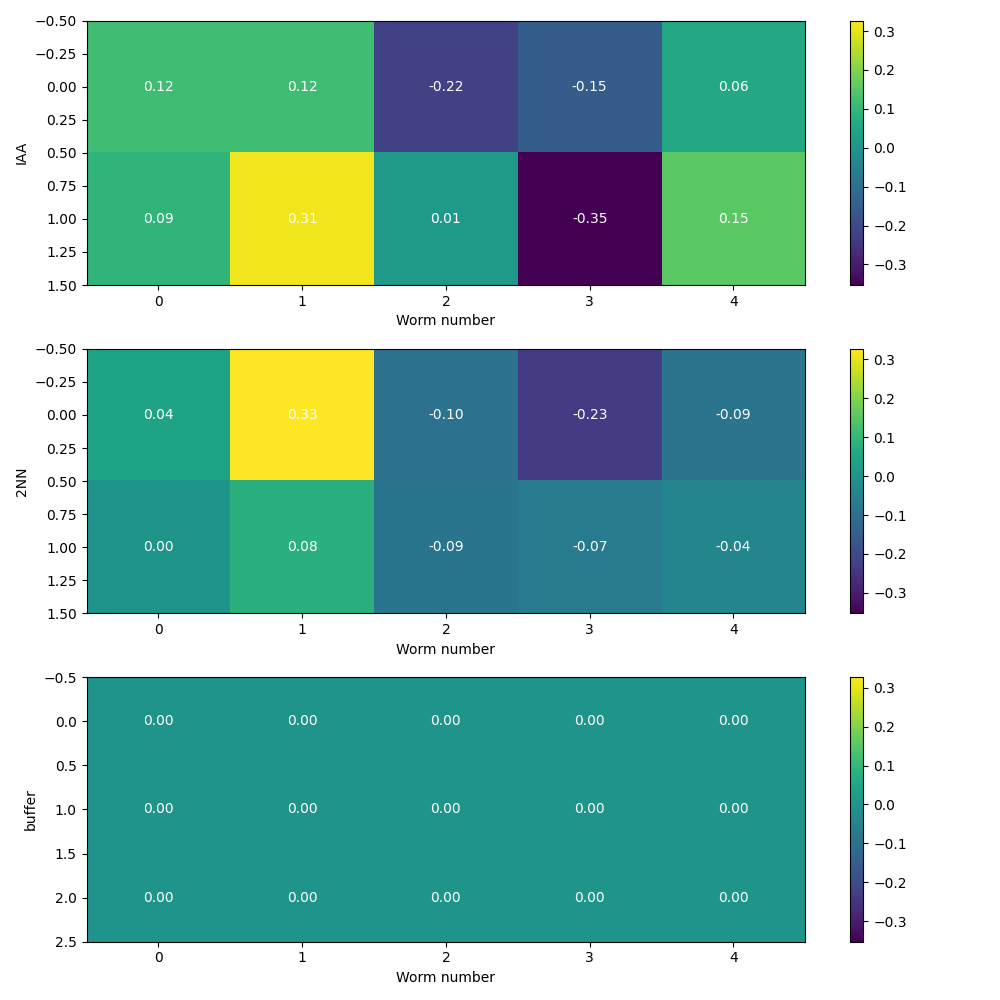

In [45]:
sig=4
for n2 in [7,8,27,28,39,40]:
    fig,ax = plt.subplots(1,5,figsize=(11,2))
    velchoice=10
    corrN7head = np.zeros((3,3,5))#dimension1 is IAA,2NN, and buffer respectively
    if True:
        for d in range(5):
            start = closest_index(MegaData0[d,:,12],IAA_int[d,0] )
            end = closest_index(MegaData0[d,:,12],IAA_int[d,1])
            rowsArr_float = MegaData[d,start:end,:]
            A = rowsArr_float[:,velchoice]
            B = rowsArr_float[:,n2]
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero(B)#(A != 0) & (B != 0))
            X = smooth_vec(compute_vector_z_score(rowsArr_float[nonzero_indices[0],n2]),sig)
            Y = (rowsArr_float[nonzero_indices[0],velchoice])
            ax[d].scatter(X,Y)
            ax[d].set_title('Worm: '+str(d))
            corr=np.corrcoef(X,Y)
            corrN7head[0,0,d] = (corr[0,1])
            ax[d].set_xlabel(str(corr[0,1]))
    
            start = closest_index(MegaData0[d,:,12],IAA_int[d,2] )
            end = closest_index(MegaData0[d,:,12],IAA_int[d,3])
            rowsArr_float = MegaData[d,start:end,:]
            A = rowsArr_float[:,velchoice]
            B = rowsArr_float[:,n2]
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero(B)#(A != 0) & (B != 0))
            X = smooth_vec(compute_vector_z_score(rowsArr_float[nonzero_indices[0],n2]),sig)
            Y = (rowsArr_float[nonzero_indices[0],velchoice])
            ax[d].scatter(X,Y,color='orange',alpha=0.5)
            corr=np.corrcoef(X,Y)
            
            corrN7head[0,1,d] = (corr[0,1])
         
    plt.show()
    fig,ax = plt.subplots(1,5,figsize=(11,2))
    if True:
        for d in range(5):
            start = closest_index(MegaData0[d,:,12],NN_int[d,0] )
            end = closest_index(MegaData0[d,:,12],NN_int[d,1])
            rowsArr_float = MegaData[d,start:end,:]
            A = rowsArr_float[:,velchoice]
            B = rowsArr_float[:,n2]
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero(B)#(A != 0) & (B != 0))
            X = smooth_vec(compute_vector_z_score(rowsArr_float[nonzero_indices[0],n2]),sig)
            Y = (rowsArr_float[nonzero_indices[0],velchoice])
            ax[d].scatter(X,Y)
            ax[d].set_title('Worm: '+str(d))
            corr=np.corrcoef(X,Y)
            corrN7head[1,0,d] = (corr[0,1])
            ax[d].set_xlabel('c:'+ str(corr[0,1]))
    
            start = closest_index(MegaData0[d,:,12],NN_int[d,2] )
            end = closest_index(MegaData0[d,:,12],NN_int[d,3])
            if d>0:
                rowsArr_float = MegaData[d,start:end,:]
                A = rowsArr_float[:,velchoice]
                B = rowsArr_float[:,n2]
                # Find indices where both A and B are nonzero
                nonzero_indices = np.nonzero(B)#(A != 0) & (B != 0))
                X = smooth_vec(compute_vector_z_score(rowsArr_float[nonzero_indices[0],n2]),sig)
                Y = (rowsArr_float[nonzero_indices[0],velchoice])
                ax[d].scatter(X,Y,color='orange',alpha=0.3)
                corr=np.corrcoef(X,Y)
                corrN7head[1,1,d] = (corr[0,1])
         
    plt.show()
    
    fig,ax = plt.subplots(1,5,figsize=(11,2))
    if False:
        for d in range(5):
            start = closest_index(MegaData0[d,:,12],IAA_int[d,1] )
            end = closest_index(MegaData0[d,:,12],NN_int[d,0])
            rowsArr_float = MegaData[d,start:end,:]
            A = rowsArr_float[:,velchoice]
            B = rowsArr_float[:,n2]
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero(B)#(A != 0) & (B != 0))
            X = smooth_vec(compute_vector_z_score(rowsArr_float[nonzero_indices[0],n2]),sig)
            Y = (rowsArr_float[nonzero_indices[0],velchoice])
            ax[d].scatter(X,Y)
            ax[d].set_title('Worm: '+str(d))
            corr=np.corrcoef(X,Y)
            corrN7head[2,0,d] = (corr[0,1])
            ax[d].set_xlabel('c:'+ str(corr[0,1]))
    
            start = closest_index(MegaData0[d,:,12],NN_int[d,1] )
            end = closest_index(MegaData0[d,:,12],IAA_int[d,2])
            rowsArr_float = MegaData[d,start:end,:]
            A = rowsArr_float[:,velchoice]
            B = rowsArr_float[:,n2]
            # Find indices where both A and B are nonzero
            nonzero_indices = np.nonzero(B)#(A != 0) & (B != 0))
            X = smooth_vec(compute_vector_z_score(rowsArr_float[nonzero_indices[0],n2]),sig)
            Y = (rowsArr_float[nonzero_indices[0],velchoice])
            ax[d].scatter(X,Y,alpha=0.5,color='pink')
            ax[d].set_title('Worm: '+str(d))
            corr=np.corrcoef(X,Y)
            corrN7head[2,1,d] = (corr[0,1])
            ax[d].set_xlabel('c:'+ str(corr[0,1]))
    
            start = closest_index(MegaData0[d,:,12],IAA_int[d,3] )
            end = closest_index(MegaData0[d,:,12],NN_int[d,2])
            if d>0:
                rowsArr_float = MegaData[d,start:end,:]
                A = rowsArr_float[:,velchoice]
                B = rowsArr_float[:,n2]
                # Find indices where both A and B are nonzero
                nonzero_indices = np.nonzero(B)#(A != 0) & (B != 0))
                X = smooth_vec(compute_vector_z_score(rowsArr_float[nonzero_indices[0],n2]),sig)
                Y = (rowsArr_float[nonzero_indices[0],velchoice])
                ax[d].scatter(X,Y,color='orange',alpha=0.3)
                corr=np.corrcoef(X,Y)
                corrN7head[2,2,d] = (corr[0,1])
         
    plt.show()
    label = ['IAA','2NN','buffer']
    fig, axs = plt.subplots(3,1, figsize=(10, 10))
    CorrMat = corrN7head
    all_min, all_max = np.min(CorrMat),np.max(CorrMat)
    for d in range(3):
        if d<2:
            matrix = CorrMat[d,:2,:]
        else:
            matrix = CorrMat[d,:,:]    
        cax1 = axs[d].imshow(matrix, cmap='viridis', aspect='auto',vmin=all_min,vmax=all_max)
        fig.colorbar(cax1, ax=axs[d])
        for i in range(matrix.shape[0]):
            for j in range(matrix.shape[1]):
                axs[d].text(j, i, f'{matrix[i, j]:.2f}', ha='center', va='center', color='white')
        axs[d].set_xlabel('Worm number')
        axs[d].set_ylabel(label[d])
    title = 'neuronOdorNew'+str(n2)    
    fig.savefig('plots/'+title +'.png')
    plt.tight_layout()
    plt.show()

0.948094365015308
0.983900469796698
0.9962199604588697
0.9982732435771856
0.9999999432544928


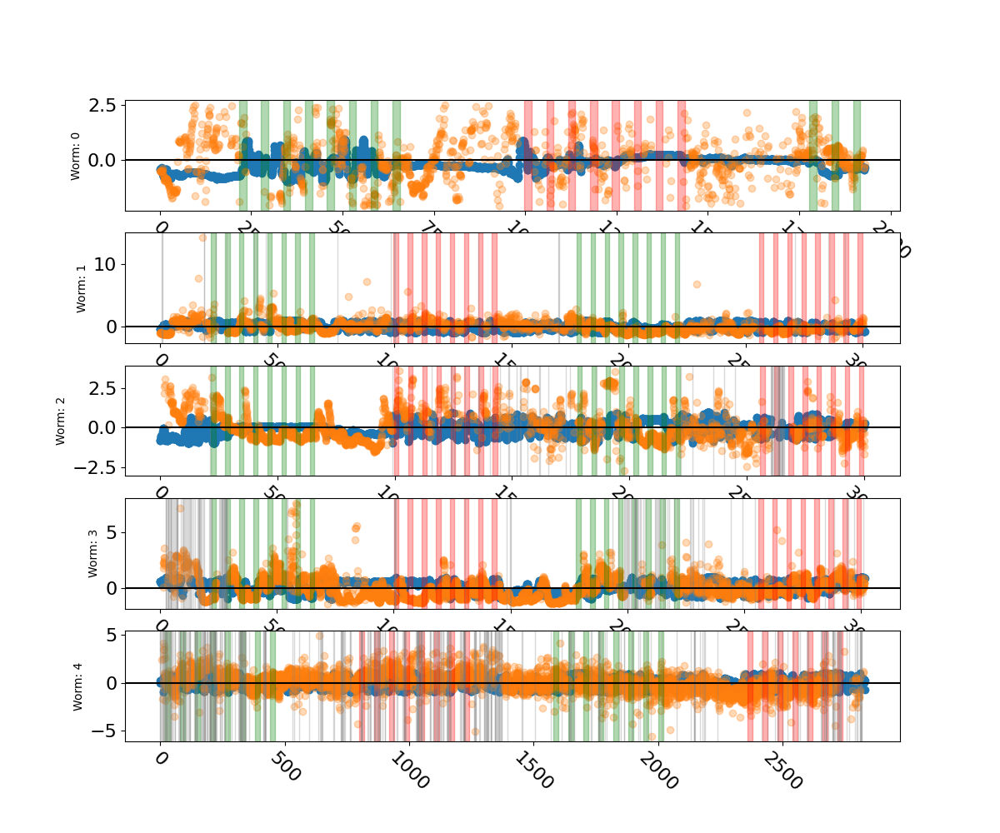

In [423]:
%matplotlib widget
#plot 1 behavior variable for all worms
fig,ax = plt.subplots(5,1,figsize=(12,10))
n2=7
velchoice=38
if True:
    for d in range(5):
        end = L[d]
        sec0 = closest_index(MegaData0[d,:,12],2)
        sec60 = closest_index(MegaData0[d,:,12],422)
        interval = int(sec60-sec0)
        rowsArr_float = MegaData[d,:end,:]
        rowsArr_float[np.isnan(rowsArr_float[:,velchoice]),velchoice]=0
        startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,:end,10]==1)
        start2NN,End2NN = get_nonzero_start_end(MegaData0[d,:end,10]==2)
        nonz1  = np.nonzero(rowsArr_float[:,velchoice])
        ax[d].scatter(rowsArr_float[nonz1[0],12],(rowsArr_float[nonz1[0],velchoice]))
        nonz2=np.nonzero(rowsArr_float[:,n2])
        ax[d].scatter(rowsArr_float[nonz2[0],12],(compute_vector_z_score(rowsArr_float[nonz2[0],n2])),alpha=0.3)
        badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,velchoice]==0)
        ax[d].axhline(0, color='black')        
        for o in range(len(startIAA)):
            ax[d].axvspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
        for o in range(len(start2NN)):    
            ax[d].axvspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
        for o in range(len(badfr_start)):
            ax[d].axvspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    
        print(np.max(rowsArr_float[nonz1[0],velchoice]))
        ax[d].tick_params(axis='x', labelsize=fs, rotation=-45)
        ax[d].tick_params(axis='y', labelsize=fs)
        #ax[d].xaxis.set_label_position('top')
        ax[d].set_ylabel('Worm: '+str(d))
     
plt.show()

59.64345648034163
59.97033240036162
59.73782958998306
59.79875253440477


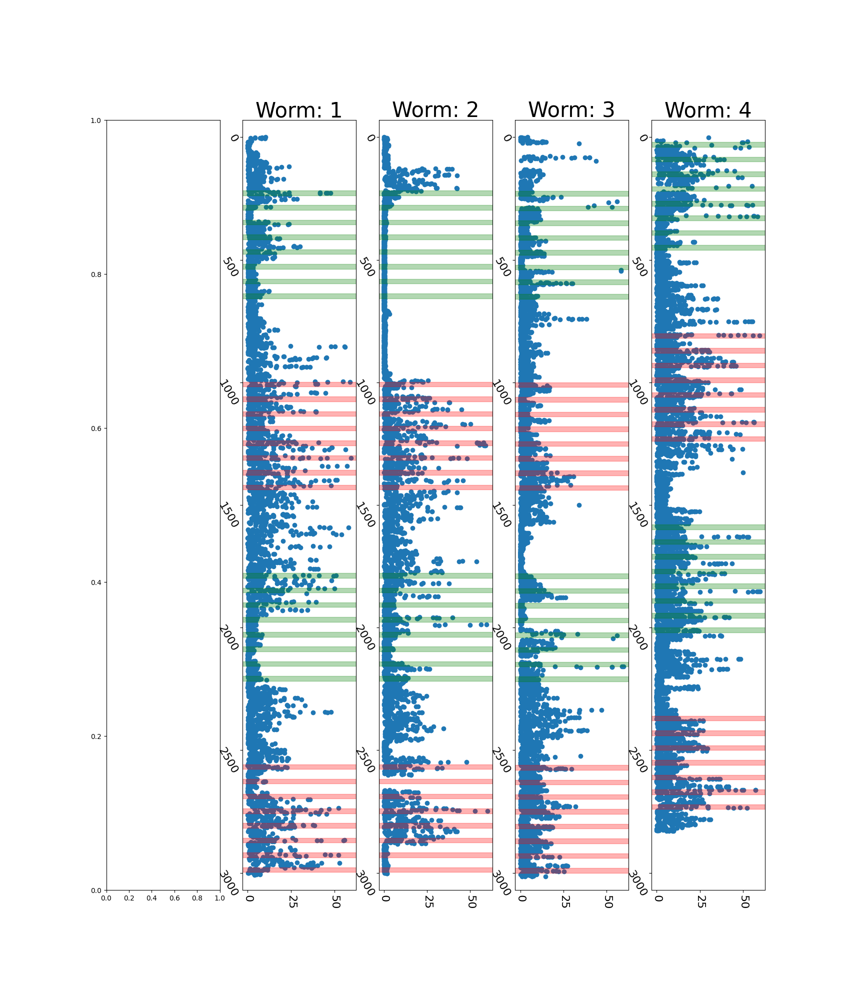

52.57692232844076
48.42330512242961
56.03881386602043
59.59440847491911
midbody_angular_velocity_long


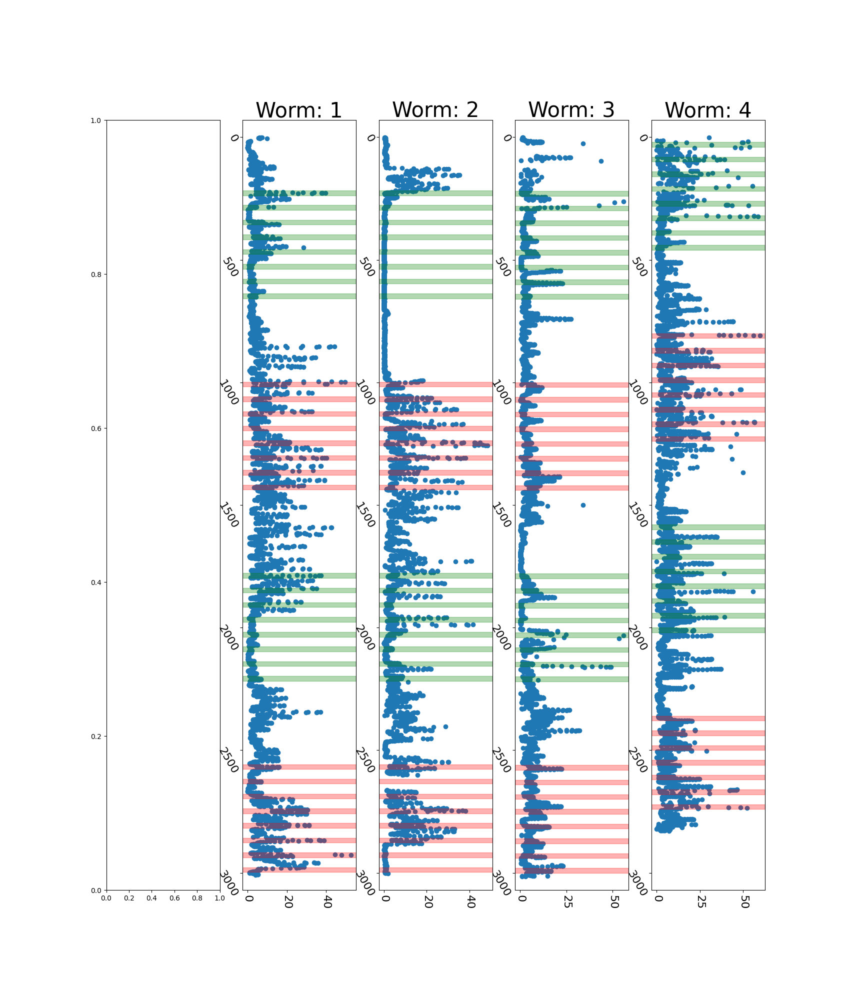

In [104]:
#plot 1 behavior variable for all worms
fig,ax = plt.subplots(1,5,figsize=(17,20))
fs=16
velchoice=47
line=False
gray=False
global_min, global_max=-70,3070
if True:
    for d in range(1,5):
        end = L[d]
        sec0 = closest_index(MegaData0[d,:,12],2)
        sec60 = closest_index(MegaData0[d,:,12],422)
        interval = int(sec60-sec0)
        rowsArr_float = MegaData0[d,:end,:]
        rowsArr_float[np.isnan(rowsArr_float[:,velchoice]),velchoice]=0
        startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,:end,10]==1)
        start2NN,End2NN = get_nonzero_start_end(MegaData0[d,:end,10]==2)
        nonz1  = np.nonzero(rowsArr_float[:,velchoice])
        ax[d].scatter((rowsArr_float[nonz1[0],velchoice]),rowsArr_float[nonz1[0],12])
        badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,velchoice]==0)
        if line:
            ax[d].axvline(0, color='black')        
        for o in range(len(startIAA)):
            ax[d].axhspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
        for o in range(len(start2NN)):    
            ax[d].axhspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
        for o in range(len(badfr_start)):
            if gray:
                ax[d].axhspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    
        print(np.max(rowsArr_float[nonz1[0],velchoice]))
        ax[d].invert_yaxis()
        ax[d].tick_params(axis='y', labelsize=fs, rotation=-60,pad=1)
        ax[d].tick_params(axis='x', labelsize=fs, rotation=-90)
        ax[d].xaxis.set_label_position('top')
        ax[d].set_xlabel('Worm: '+str(d), fontsize=30)
        ax[d].set_ylim(global_max,global_min)
if velchoice in [0,2,4]:  
    target_value=velchoice+1
    title =  get_attribute_name_by_value(h5, target_value)+'L'   
else:
    target_value=velchoice
    title =  get_attribute_name_by_value(h5, target_value)  
if gray:
    title=title+'_gr'    
fig.savefig(Address_savebins0+'/RawPlot/'+title +'.png')           
plt.show()

fig2,ax = plt.subplots(1,5,figsize=(17,20))
if True:
    for d in range(1,5):
        end = L[d]
        sec0 = closest_index(MegaData0[d,:,12],2)
        sec60 = closest_index(MegaData0[d,:,12],422)
        interval = int(sec60-sec0)
        rowsArr_float = MegaData[d,:end,:]
        rowsArr_float[np.isnan(rowsArr_float[:,velchoice]),velchoice]=0
        startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,:end,10]==1)
        start2NN,End2NN = get_nonzero_start_end(MegaData0[d,:end,10]==2)
        nonz1  = np.nonzero(rowsArr_float[:,velchoice])
        ax[d].scatter((rowsArr_float[nonz1[0],velchoice]),rowsArr_float[nonz1[0],12])
        badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,velchoice]==0)
        if line:
            ax[d].axvline(0, color='black')        
        for o in range(len(startIAA)):
            ax[d].axhspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
        for o in range(len(start2NN)):    
            ax[d].axhspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
        for o in range(len(badfr_start)):
            if gray:
                ax[d].axhspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    
        print(np.max(rowsArr_float[nonz1[0],velchoice]))
        ax[d].invert_yaxis()
        ax[d].tick_params(axis='y', labelsize=fs, rotation=-60,pad=1)
        ax[d].tick_params(axis='x', labelsize=fs, rotation=-90)
        ax[d].xaxis.set_label_position('top')
        ax[d].set_xlabel('Worm: '+str(d), fontsize=30)
        ax[d].set_ylim(global_max,global_min)
if velchoice in [0,2,4]:  
    target_value=velchoice+1
    title =  get_attribute_name_by_value(h5, target_value)+'L' 
else:
    target_value=velchoice
    title =  get_attribute_name_by_value(h5, target_value)  
if gray:
        title=title+'_gr'
fig2.savefig(Address_savebins0+'/SmoothedPlot/'+title +'.png')  
print(title)
plt.show()

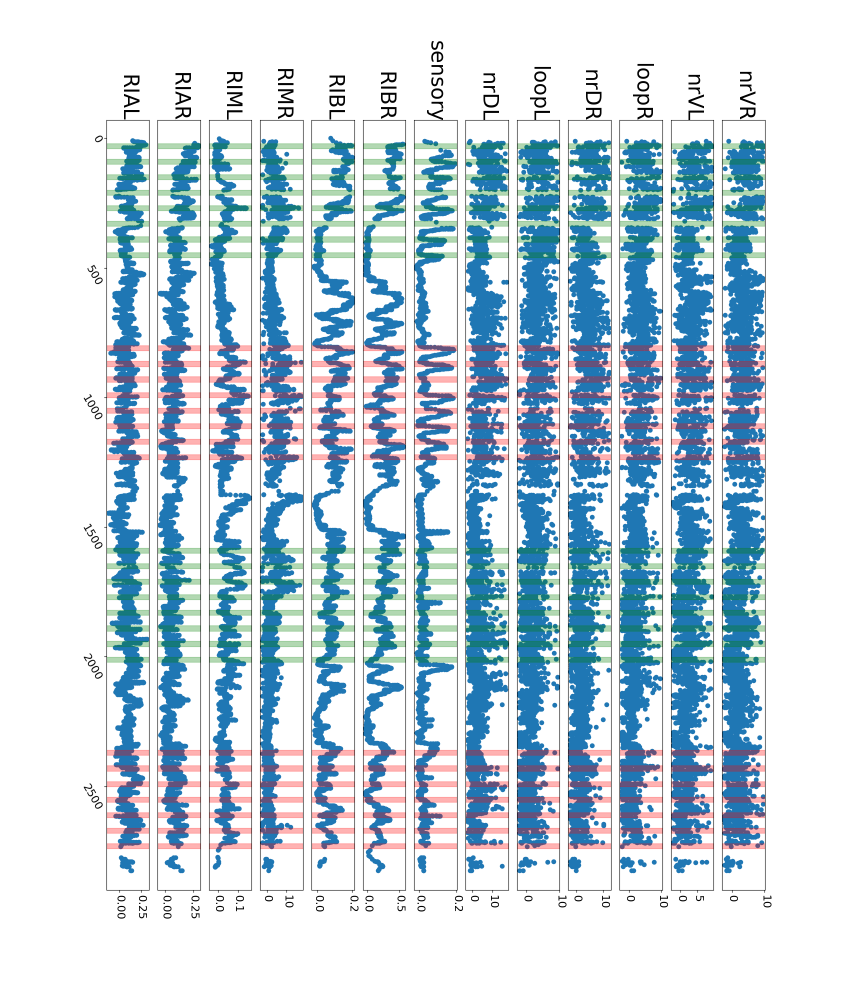

/tmp/ipykernel_1077262/3322528964.py:472: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  smoothed_arr_f = [np.float(x) for x in smoothed_arr]


Neuron_Worm4


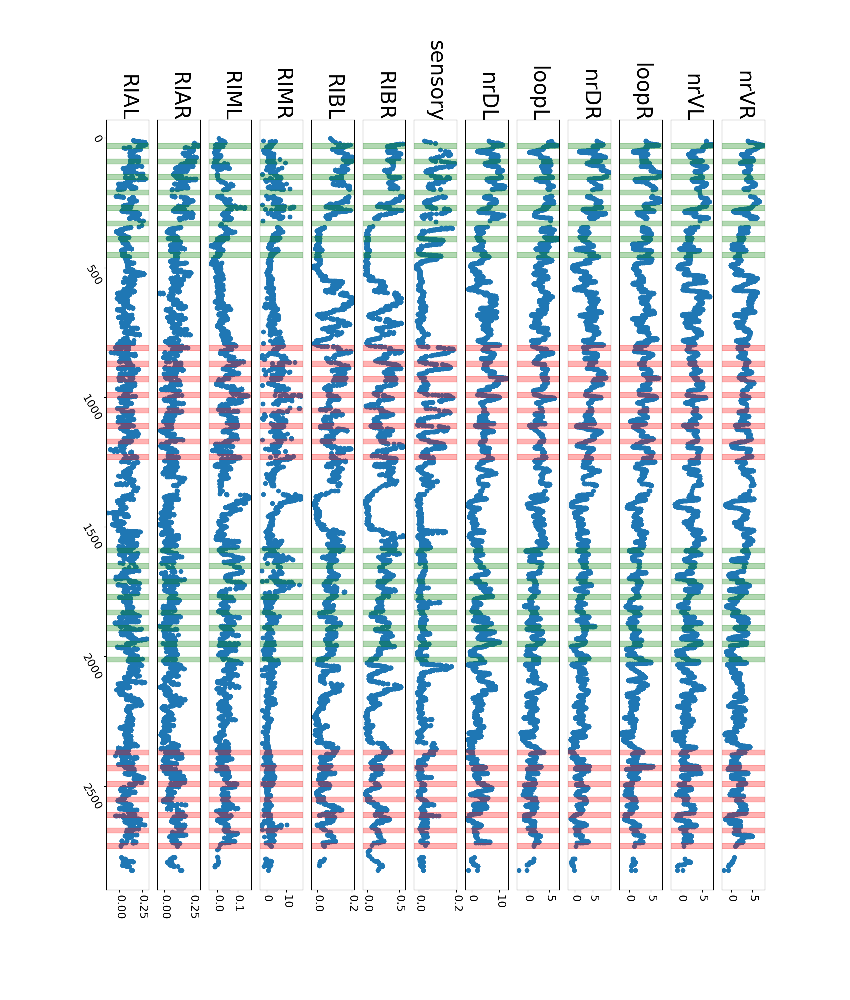

In [107]:
#plot all neurons for 1 worm 
x_labels = ['RIAL', 'RIAR', 'RIML', 'RIMR', 'RIBL', 'RIBR', 'sensory', 
            'nrDL', 'loopL', 'nrDR', 'loopR', 'nrVL', 'nrVR']
Neurons = [0,1,2,3,4,5,6,7,8,27,28,39,40]

fs=16
scus = [10,10,10,10,5]
line=False
gray=False
global_min, global_max=-70,3070
for d in range(4,5):
    fig,ax = plt.subplots(1,13,figsize=(17,20))
    global_min, global_max=-70,np.max(MegaData0[d,:,12]+70)
    for n0 in range(len(Neurons)):
        if n0>0:
                ax[n0].set_yticks([])
        if d>0 or not (n0 in [3,5]):
            n=Neurons[n0]
            end = L[d]
            sec0 = closest_index(MegaData0[d,:,12],2)
            sec60 = closest_index(MegaData0[d,:,12],422)
            interval = int(sec60-sec0)
            rowsArr_float = MegaData0[d,:end,:]
            rowsArr_float[np.isnan(rowsArr_float[:,n]),n]=0
            startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,:end,10]==1)
            start2NN,End2NN = get_nonzero_start_end(MegaData0[d,:end,10]==2)
            nonz1  = np.nonzero(rowsArr_float[:,n])
            ax[n0].scatter((rowsArr_float[nonz1[0],n]),rowsArr_float[nonz1[0],12])
            badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,n]==0)
            if line:
                ax[n0].axvline(0, color='black')        
            for o in range(len(startIAA)):
                ax[n0].axhspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
            for o in range(len(start2NN)):    
                ax[n0].axhspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
            for o in range(len(badfr_start)):
                if gray:
                    ax[n0].axhspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    
            ax[n0].invert_yaxis()
            if n0>0:
                ax[n0].set_yticks([])
            ax[0].tick_params(axis='y', labelsize=fs, rotation=-60,pad=1)
            ax[n0].tick_params(axis='x', labelsize=fs, rotation=-90)
            ax[n0].xaxis.set_label_position('top')
            ax[n0].set_xlabel(x_labels[n0], fontsize=30, rotation=-90)
            ax[n0].set_ylim(global_max,global_min)
    title =  'Neuron_Worm' + str(d)  
    if gray:
        title=title+'_gray'    
    fig.savefig(Address_savebins0+'/Raw_'+title +'.png')           
    plt.show()
    
    fig2,ax = plt.subplots(1,len(Neurons),figsize=(17,20))
    for n0 in range(len(Neurons)):
        if n0>0:
                ax[n0].set_yticks([])
        if d>0 or not (n0 in [3,5]):
            n=Neurons[n0]
            end = L[d]
            sec0 = closest_index(MegaData0[d,:,12],2)
            sec60 = closest_index(MegaData0[d,:,12],422)
            interval = int(sec60-sec0)
            rowsArr_float = MegaData[d,:end,:]
            rowsArr_float[np.isnan(rowsArr_float[:,n]),n]=0
            startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,:end,10]==1)
            start2NN,End2NN = get_nonzero_start_end(MegaData0[d,:end,10]==2)
            nonz1  = np.nonzero(rowsArr_float[:,n])
            if d==4 and n>6:
                ax[n0].scatter(smooth_vec(rowsArr_float[nonz1[0],n],4),rowsArr_float[nonz1[0],12])
            else:    
                ax[n0].scatter((rowsArr_float[nonz1[0],n]),rowsArr_float[nonz1[0],12])
            badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,n]==0)
            if line:
                ax[n0].axvline(0, color='black')        
            for o in range(len(startIAA)):
                ax[n0].axhspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
            for o in range(len(start2NN)):    
                ax[n0].axhspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
            for o in range(len(badfr_start)):
                if gray:
                    ax[n0].axhspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    
            ax[n0].invert_yaxis()
            
            ax[0].tick_params(axis='y', labelsize=fs, rotation=-60,pad=1)
            
            ax[n0].tick_params(axis='x', labelsize=fs, rotation=-90)
            ax[n0].xaxis.set_label_position('top')
            ax[n0].set_xlabel(x_labels[n0], fontsize=30, rotation=-90)#'Worm: '+str(d), fontsize=30)
            ax[n0].set_ylim(global_max,global_min)
    if gray:
            title=title+'_gray'
    fig2.savefig(Address_savebins0+'/Smoothed_'+title +'.png')  
    print(title)
    plt.show()

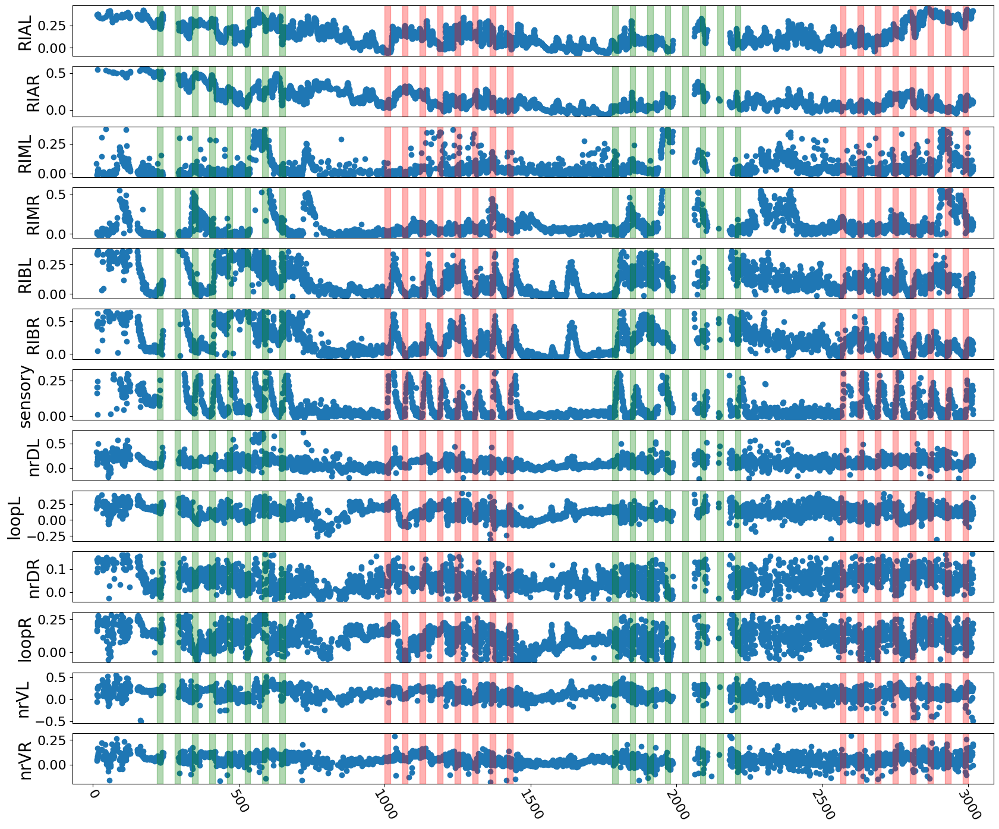

Neuron_Worm3


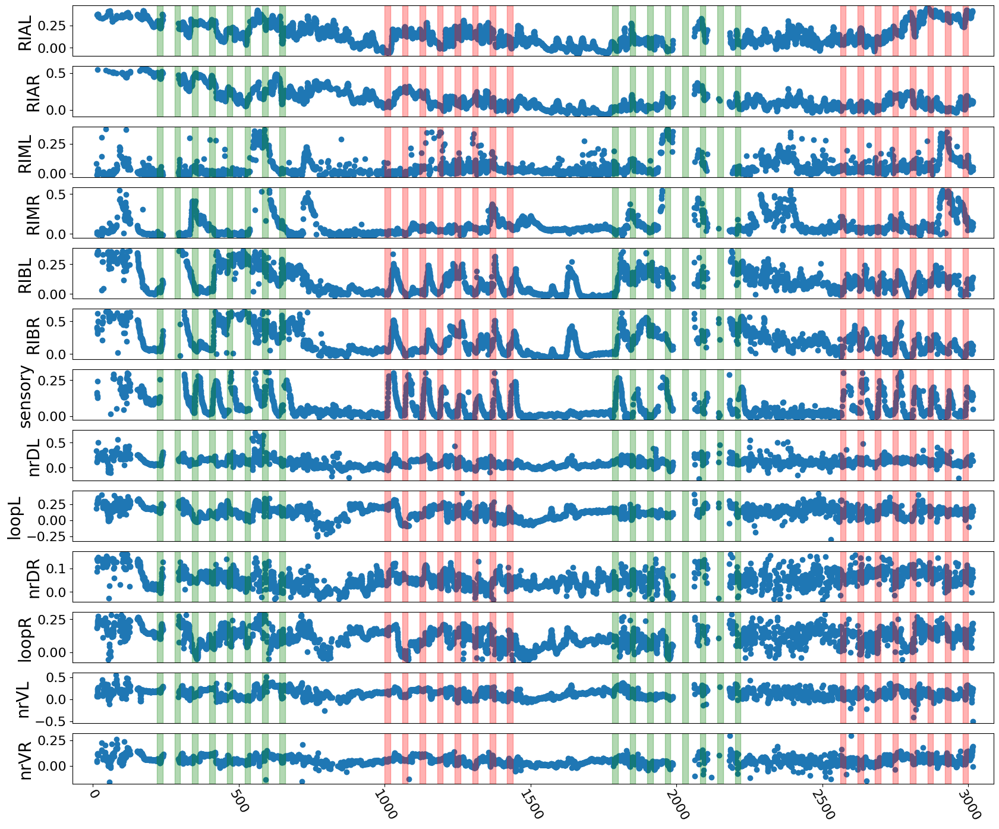

In [382]:
#plot all neurons for 1 worm 
x_labels = ['RIAL', 'RIAR', 'RIML', 'RIMR', 'RIBL', 'RIBR', 'sensory', 
            'nrDL', 'loopL', 'nrDR', 'loopR', 'nrVL', 'nrVR']
Neurons = [0,1,2,3,4,5,6,7,8,27,28,39,40]
fig,ax = plt.subplots(13,1,figsize=(20,17))
fs=16

line=False
gray=False
global_min, global_max=-70,3070
d=3
global_min, global_max=-70,np.max(MegaData0[d,:,12]+70)
for n0 in range(len(Neurons)):
    if n0<12:
            ax[n0].set_xticks([])
    if d>0 or not (n0 in [3,5]):
        n=Neurons[n0]
        end = L[d]
        sec0 = closest_index(MegaData0[d,:,12],2)
        sec60 = closest_index(MegaData0[d,:,12],422)
        interval = int(sec60-sec0)
        rowsArr_float = MegaData0[d,:end,:]
        rowsArr_float[np.isnan(rowsArr_float[:,n]),n]=0
        startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,:end,10]==1)
        start2NN,End2NN = get_nonzero_start_end(MegaData0[d,:end,10]==2)
        nonz1  = np.nonzero(rowsArr_float[:,n])
        ax[n0].scatter(rowsArr_float[nonz1[0],12],(rowsArr_float[nonz1[0],n]))
        badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,n]==0)
        if line:
            ax[n0].axhline(0, color='black')        
        for o in range(len(startIAA)):
            ax[n0].axvspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
        for o in range(len(start2NN)):    
            ax[n0].axvspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
        for o in range(len(badfr_start)):
            if gray:
                ax[n0].axvspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    

        ax[12].tick_params(axis='x', labelsize=fs, rotation=-60,pad=1)
        
        ax[n0].tick_params(axis='y', labelsize=fs)
        
        ax[n0].set_ylabel(x_labels[n0], fontsize=20)
        ax[n0].set_xlim(global_min,global_max)
title =  'Neuron_Worm' + str(d)  
if gray:
    title=title+'_gr'    
fig.savefig(Address_savebins0+'/HorizontalRaw_'+title +'.png')           
plt.show()

fig2,ax = plt.subplots(len(Neurons),1,figsize=(20,17))
for n0 in range(len(Neurons)):
    if n0<12:
            ax[n0].set_xticks([])
    if d>0 or not (n0 in [3,5]):
        n=Neurons[n0]
        end = L[d]
        sec0 = closest_index(MegaData0[d,:,12],2)
        sec60 = closest_index(MegaData0[d,:,12],422)
        interval = int(sec60-sec0)
        rowsArr_float = MegaData[d,:end,:]
        rowsArr_float[np.isnan(rowsArr_float[:,n]),n]=0
        startIAA,EndIAA = get_nonzero_start_end(MegaData0[d,:end,10]==1)
        start2NN,End2NN = get_nonzero_start_end(MegaData0[d,:end,10]==2)
        nonz1  = np.nonzero(rowsArr_float[:,n])
        ax[n0].scatter(rowsArr_float[nonz1[0],12],(rowsArr_float[nonz1[0],n]))
        badfr_start,badfr_end = get_nonzero_start_end(rowsArr_float[:,n]==0)
        if line:
            ax[n0].axhline(0, color='black')        
        for o in range(len(startIAA)):
            ax[n0].axvspan(rowsArr_float[startIAA[o],12],rowsArr_float[EndIAA[o],12], color='green',alpha=0.3)
        for o in range(len(start2NN)):    
            ax[n0].axvspan(rowsArr_float[start2NN[o],12],rowsArr_float[End2NN[o],12], color='red',alpha=0.3)
        for o in range(len(badfr_start)):
            if gray:
                ax[n0].axvspan(rowsArr_float[badfr_start[o],12],rowsArr_float[badfr_end[o],12], color='gray',alpha=0.3)    

        
        
        ax[12].tick_params(axis='x', labelsize=fs, rotation=-60,pad=1)
        
        ax[n0].tick_params(axis='y', labelsize=fs)
        ax[n0].set_ylabel(x_labels[n0], fontsize=20)#'Worm: '+str(d), fontsize=30)
        ax[n0].set_xlim(global_min,global_max)
if gray:
        title=title+'_gr'
fig2.savefig(Address_savebins0+'/HorizontalSmoothed_'+title +'.png')  
print(title)
plt.show()

In [52]:
shifted_behavior = copy.deepcopy(Velocity_bin)
shifted_behavior[:,:-1] = Velocity_bin[:,1:]
shifted_behavior[:,-1:] = 0

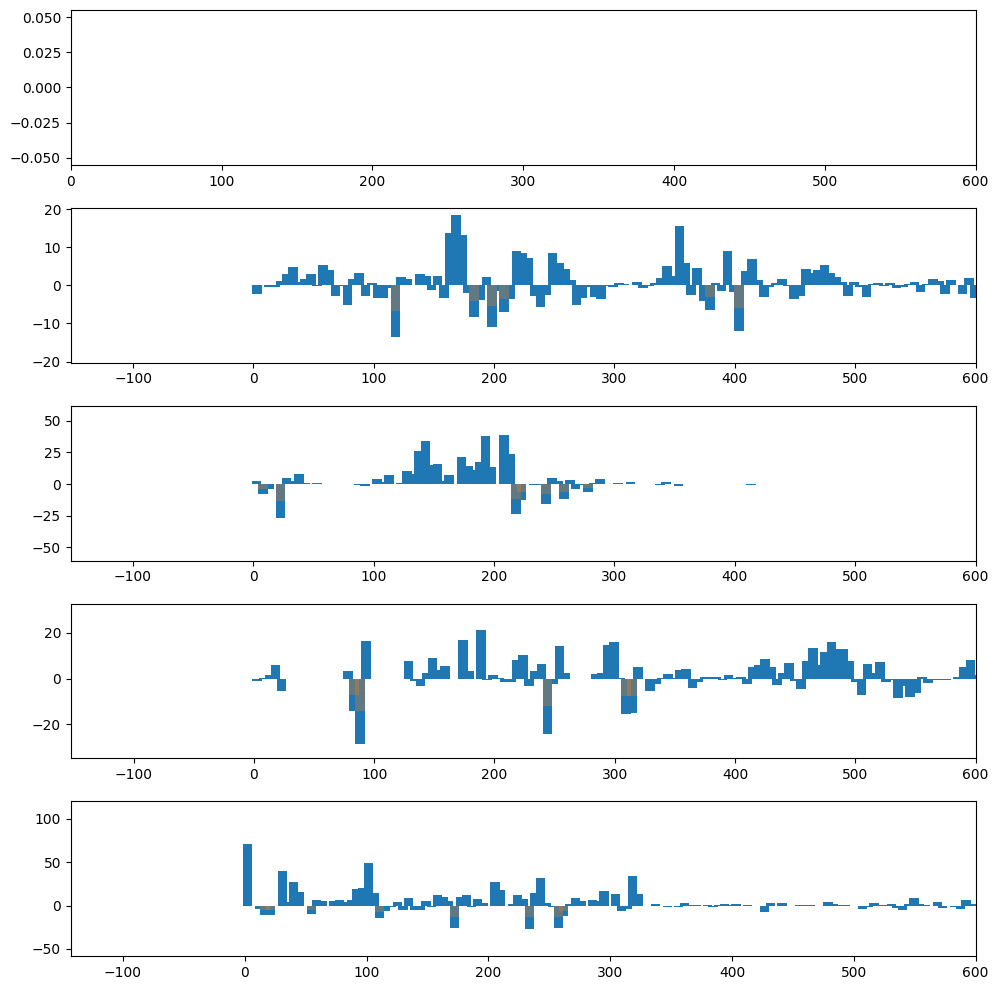

In [50]:
nx = 2
nx2 = 4
# Create subplots
plt.figure(figsize=(10, 10))
c=[1,2,4,4,4]
for d in range(5):
    plt.subplot(5, 1, d+1)
    # Plot bar plots
    plt.bar(time_bins[d,:b[d]], Velocity_bin[d,:b[d]], width = width_bins[d,:b[d]])
    #plt.bar(time_bins[d,:b[d]], activity_bins[d,nx,:b[d]]*c[d], width = width_bins[d,:b[d]])
    plt.bar(time_bins[d,:b[d]], BackwVelocity_bin[d,:b[d]]/2, width = width_bins[d,:b[d]],alpha=0.3)
    #plt.bar(time_bins[d,:b[d]], activity_bins[d,nx2,:b[d]]*c[d], width = width_bins[d,:b[d]],alpha=0.6)
    plt.xlim(right=600)
plt.tight_layout()
plt.show()    

In [ ]:
nx = 2
# Create subplots
fig = make_subplots(rows=5, cols=1)

for d in range(5):
    # Plot bar plots
    fig.add_trace(go.Bar(x=time_bins[d,:b[d]], y=Velocity_bin[d,:b[d]], width = width_bins[d,:b[d]]), row=d+1, col=1)
    fig.add_trace(go.Bar(x=time_bins[d,:b[d]], y=activity_bins[d,nx,:b[d]], width = width_bins[d,:b[d]]), row=d+1, col=1)
    
# Update layout
fig.update_layout(
    barmode='overlay',
    xaxis_title='Value',
    yaxis_title='Frequency',
    legend_title='Data',
    title='Interactive Plots of Binned Data',
    template='plotly_white',
    height=600,
    width=1200
    )

fig.show()

In [27]:
nx = 2
# Create subplots
fig = make_subplots(rows=5, cols=1)

for d in range(5):
    # Plot bar plots
    fig.add_trace(go.Bar(x=time_bins[d,:b[d]], y=Velocity_bin[d,:b[d]], width=width_bins[d,:b[d]]), row=d+1, col=1)
    fig.add_trace(go.Bar(x=time_bins[d,:b[d]], y=activity_bins[d,nx,:b[d]], width=width_bins[d,:b[d]]), row=d+1, col=1)
    
# Update layout
fig.update_layout(
    barmode='overlay',
    xaxis_title='Value',
    yaxis_title='Frequency',
    legend_title='Data',
    title='Interactive Plots of Binned Data',
    template='plotly_white',
    height=600,
    width=1200
    )

fig.show()

In [572]:
h5 = h5py.File('MegaData7_copy6_noOutlier_smoothed.h5', 'r+')

In [573]:
Dictionary = {'RIA1':0,'RIA2':1,'RIM1':2,'RIM2':3,'RIB1':4,'RIB2':5,'sensory':6,
                                'nrD1':7, 'loop1':8, 'neuron':9,
                                'odor':10,'uppercamera_index':11,'lower_camera_time_stamp':12,'v_center_long':13,
                                'v_center_signed_long':14,'v_center_medium':15,
                                'v_center_signed_medium':16,'v_center_short':17,
                                'v_center_signed_short':18,'v_head_long':19,'v_tail':20,'v_head_short':21,
              'v_headsigned_medium':22, 'v_headsigned_long':23, 'v_head_short':24,'v_head_medium':25,
              'head curvature':26, 'nrD2':27, 'loop2':28, 'head perpandicular_short':29, 'head perpandicular_medium':30,
              'head perpandicular_long':31, 'tail velocity perpendicular long':32,
              'tail velocity_medium':33, 'tail velocity_short':34, 'tail curvature':35,'merged neurite':36,
             'head angle wrt center':37,'head angle wrt necl':38,'nrV1':39,'nrV2':40,'v_com_short':41,'v_com_medium':42,
              'v_com_long':43,'bad fr in upper camera':44,'midbody_angular_velocity_short':45,'midbody_angular_velocity_medium':46,
             'midbody_angular_velocity_long':47}

In [574]:
del h5['data/dataraw']
h5.create_dataset('data/dataraw',data=MegaData0)
h5['data/dataraw'].attrs['variable_orders']= 'Dict'
h5['data/dataraw'].attrs.update(Dictionary)
h5['data/dataraw'].attrs.keys()
h5.close()

100
[ 0.4838615   0.17475093  0.3344541  -1.49290039  0.02191025  1.18224722
  0.04813721  0.80321521  1.47798784  1.0314756  -0.31160746 -0.7932087
  0.72024647  1.0408281  -0.15488037 -0.56145601 -0.21849468 -0.02023002
 -0.74211     0.53322562 -0.793409   -0.75843606 -0.06063638 -1.22509306
 -0.69362015 -0.34152859 -0.91282215  0.41662497 -0.0121596  -0.25680952
  0.16432301  0.63559145  1.47233591  0.08499834 -1.19838079  0.37643688
  0.08127255 -0.14585777 -1.28748997 -0.10138467 -0.03091317  0.39120965
 -1.20132014  0.08350149 -0.03137901  0.32186741 -1.05936145 -0.2325561
 -1.14142711 -0.8153846  -0.34060905 -0.53672235 -0.23842683  1.40594119
  2.11185491  0.32442154  0.3317834  -0.11415547 -0.90311164 -1.38146014
  0.68798743 -0.86344978  0.13438756 -0.05296547 -1.10919361  0.16434329
 -0.22771465  0.89048599  1.54548184 -0.29920178  0.2499696  -0.27606029
  1.20695908  2.74898834  0.17072003 -0.07301208  0.02947225  0.7370264
  0.31985446 -0.35127398  0.15679565 -0.75985387  

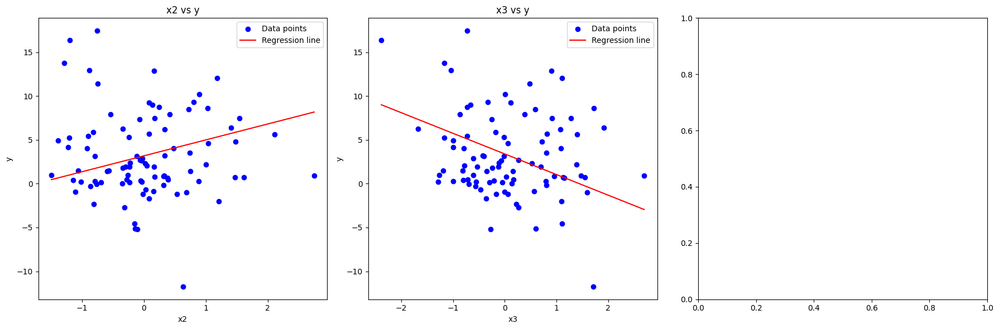

In [42]:
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

for i, col in enumerate(X.columns):
    axs[i].scatter(X_train[col], y_train, color='blue', label='Data points')
    
    # Plotting the regression line for the current variable
    other_vars_mean = X_train.drop(columns=[col]).mean(axis=0)
    X_line = np.linspace(X_train[col].min(), X_train[col].max(), 100)
    y_line = coefficients[i] * X_line + intercept + np.dot(other_vars_mean, np.delete(coefficients, i))
    
    axs[i].plot(X_line, y_line, color='red', label='Regression line')
    axs[i].set_title(f'{col} vs y')
    axs[i].set_xlabel(col)
    axs[i].set_ylabel('y')
    axs[i].legend()

plt.tight_layout()
plt.show()


In [41]:
X_train['x2']

71    0.483862
89    0.174751
91    0.334454
16   -1.492900
8     0.021910
        ...   
58    0.887536
42   -0.811118
22   -0.876932
52   -0.590921
43    1.001010
Name: x2, Length: 90, dtype: float64

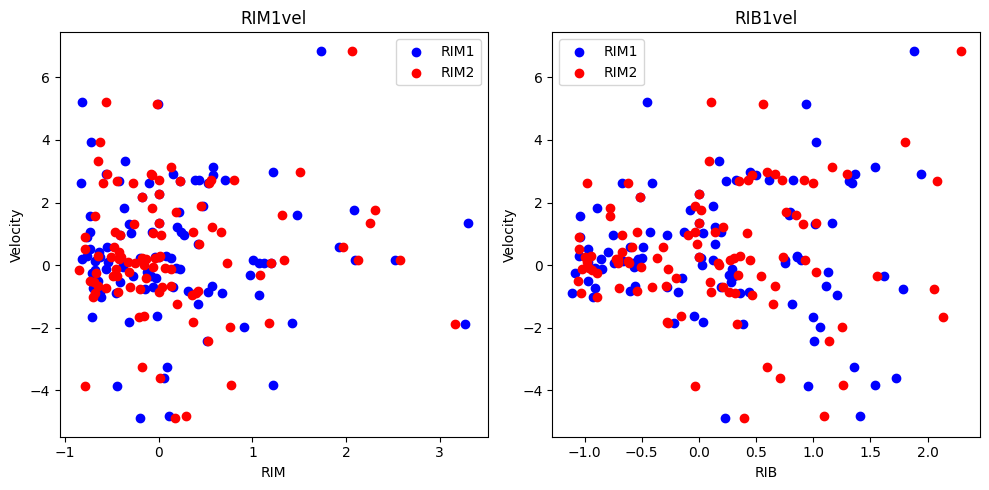

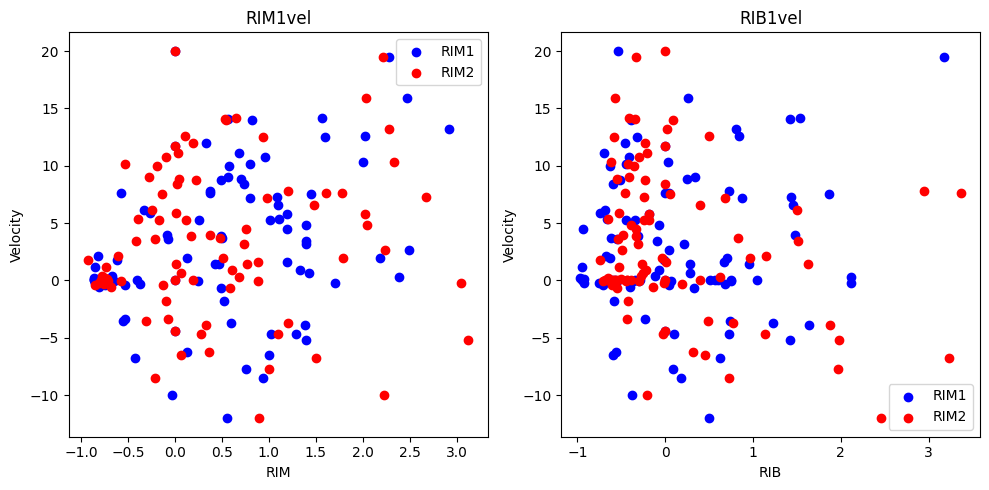

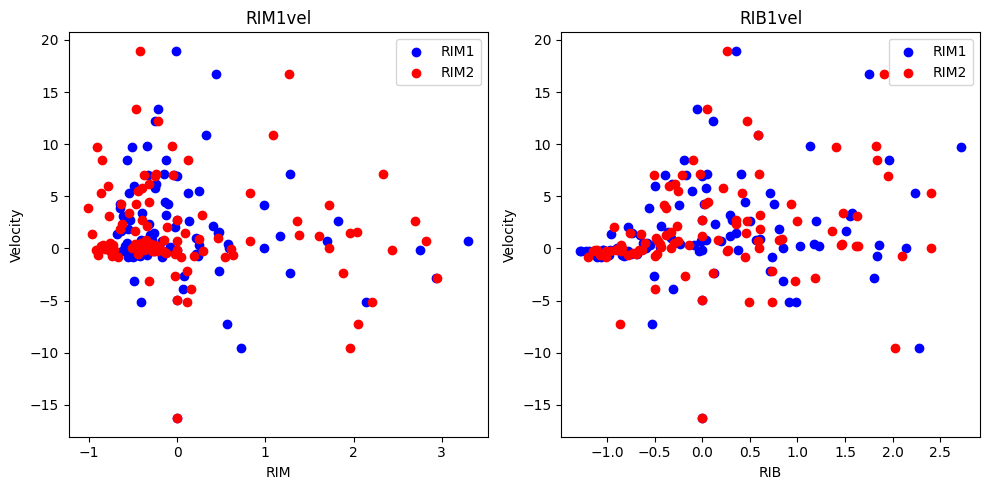

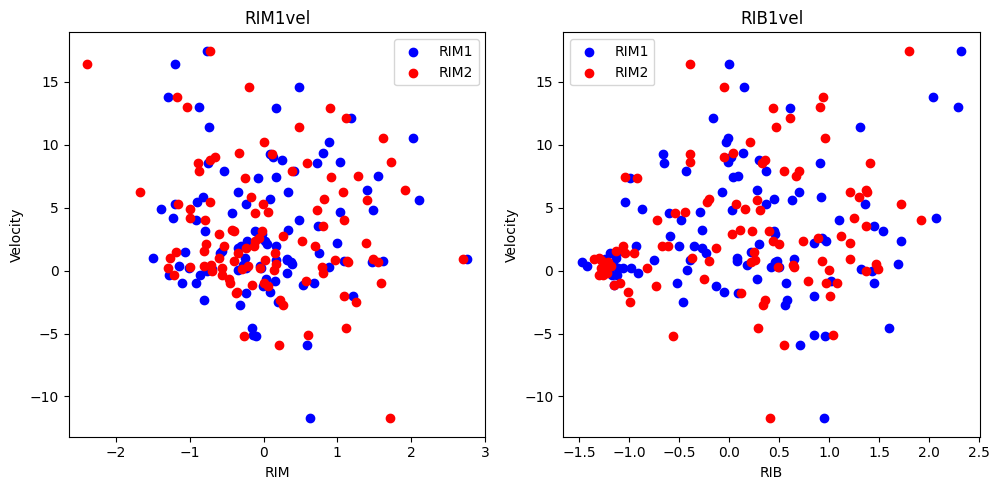

In [40]:
for d in range(1,5):
    fig, axs = plt.subplots(1, 2, figsize = (10,5))
    axs[0].scatter(activity_bins[d,2,:b[d]], Velocity_bin[d,:b[d]], color='blue', label='RIM1')
    axs[0].scatter(activity_bins[d,3,:b[d]], Velocity_bin[d,:b[d]], color='red', label='RIM2')
    axs[0].set_title('RIM-vel')
    axs[0].set_xlabel('RIM')
    axs[0].set_ylabel('Velocity')
    axs[0].legend()
    
    axs[1].scatter(activity_bins[d,4,:b[d]], Velocity_bin[d,:b[d]], color='blue', label='RIB1')
    axs[1].scatter(activity_bins[d,5,:b[d]], Velocity_bin[d,:b[d]], color='red', label='RIB2')
    axs[1].set_title('RIB-vel')
    axs[1].set_xlabel('RIB')
    axs[1].set_ylabel('Velocity')
    axs[1].legend()
    
    # Adjust layout to prevent overlapping
    plt.tight_layout()
    
    # Display the plot
    plt.show()